In [1]:
import os
import time
import warnings
import numpy as np
import scipy as sc
import sympy as sy
import matplotlib.cm as cm
import matplotlib.pylab as plt
from PIL import Image

warnings.filterwarnings('ignore')  
plt.rcParams['text.usetex'] = True
plt.rcParams['font.size'] = 20
plt.rcParams['legend.fontsize'] = 30
from IPython.display import display, Math,clear_output

# $$\textit{Kalpan-Yorke Map}$$
The Map

$\qquad x_{n+1} = 2x_n \qquad\mathrm{mod} \ 1 $

$\qquad y_{n+1} = \alpha y_n + \cos(4\pi x_n) $

In [2]:
def kaplan_yorke_map(x, y, alpha):
    x_next = (2* x) % 0.99995
    y_next = alpha * y + np.cos(4 * np.pi * x)
    return x_next, y_next

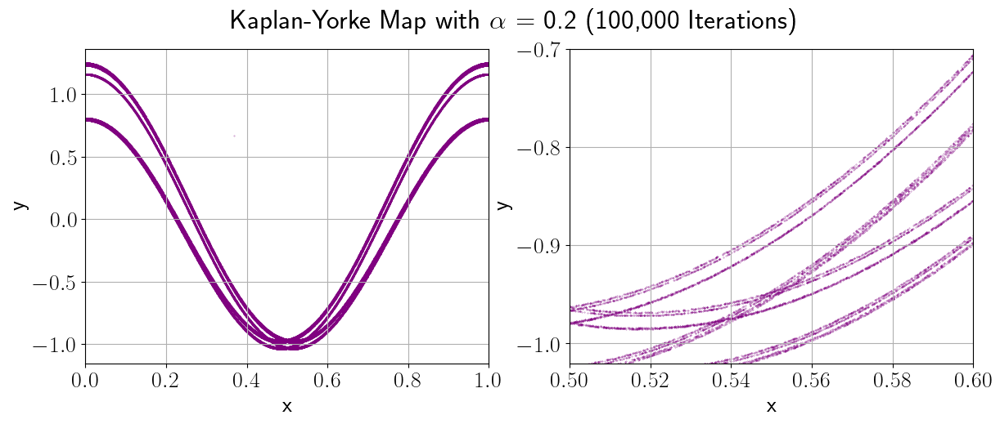

In [3]:
alpha = 0.2
num_iterations = 100000
x0 = 128873 / 350377
y0 = 0.667751

x_vals = np.zeros(num_iterations)
y_vals = np.zeros(num_iterations)
x_vals[0], y_vals[0] = x0, y0

for i in range(1, num_iterations):
    x_vals[i], y_vals[i] = kaplan_yorke_map(x_vals[i-1], y_vals[i-1], alpha)

plt.figure(figsize=(14, 5))
plt.subplot(121)
plt.scatter(x_vals, y_vals, s=0.1, color="purple", alpha=0.6)
plt.xlabel("x")
plt.ylabel("y")
plt.xlim(0,1)
plt.grid(True)
plt.subplot(122)
plt.scatter(x_vals, y_vals, s=0.1, color="purple", alpha=0.6)
plt.xlabel("x")
plt.ylabel("y")
plt.xlim(0.5,0.6)
plt.ylim(-1.02, -0.7)
plt.grid(True)
plt.suptitle(r"Kaplan-Yorke Map with $\alpha$ = 0.2 (100,000 Iterations)")
plt.show()

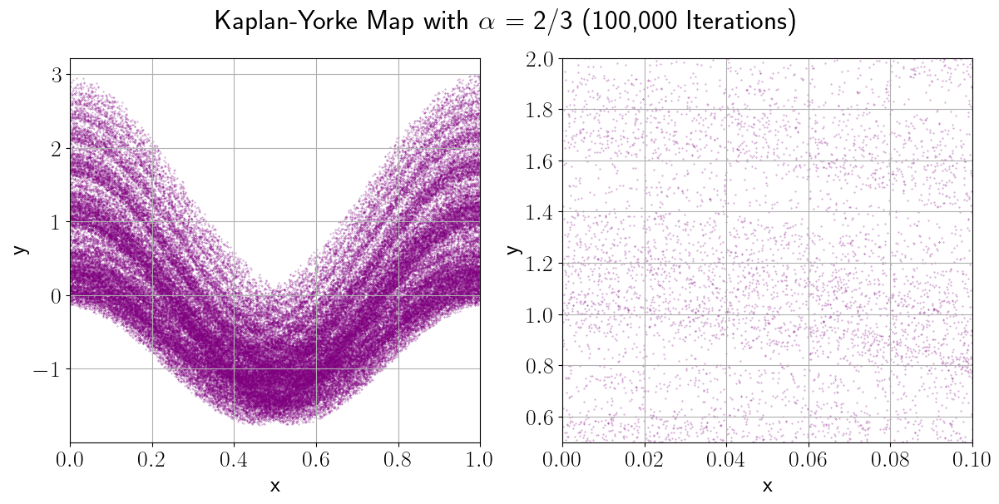

In [4]:
alpha = 2/3
num_iterations = 100000
x0 = 128873 / 350377
y0 = 0.667751

x_vals = np.zeros(num_iterations)
y_vals = np.zeros(num_iterations)
x_vals[0], y_vals[0] = x0, y0

for i in range(1, num_iterations):
    x_vals[i], y_vals[i] = kaplan_yorke_map(x_vals[i-1], y_vals[i-1], alpha)

plt.figure(figsize=(14, 6))
plt.subplot(121)
plt.scatter(x_vals, y_vals, s=0.1, color="purple", alpha=0.6)
plt.xlabel("x")
plt.ylabel("y")
plt.xlim(0,1)
plt.grid(True)
plt.subplot(122)
plt.scatter(x_vals, y_vals, s=0.1, color="purple", alpha=0.6)
plt.xlabel("x")
plt.ylabel("y")
plt.xlim(0.,0.1)
plt.ylim(0.5,2.)
plt.grid(True)
plt.suptitle(r"Kaplan-Yorke Map with $\alpha$ = 2/3 (100,000 Iterations)")
plt.show()

# $$\text{The standard map}$$                                                                                                         
<span style="color:red">The map                                          
$ \qquad\begin{align} x_{n+1}&=x_n+y_{n+1}, \\ y_{n+1}&=y_n+k\sin x_n\end{align}$                                            
is called the standard map because it arises in many different physical contexts,                                                    
ranging from the dynamics of periodically kicked oscillators to the motion of charged particles                                
perturbed by a broad spectrum of oscillating fields **(Jensen 1987, Lichtenberg and Lieberman 1992)**.                                                 
The variables $x, y,$ and the governing equations are all to be evaluated modulo $2\pi$.                                             
The nonlinearity parameter $k\ge0$ is a measure of how hard the system is being driven.                                                                                                                               
a) Show that the map is area-preserving for all $k$.                                                                                
b) Plot various orbits for $k=0$. (This corresponds to the integrable limit of the system.)                                          
c) Using a computer, plot the phase portrait for $k=0.5$. Most orbits should still look regular.                                     
d) Show that for $k=1$, the phase portrait contains both islands and chaos.                                                          
e) Show that at $k=2$, the chaotic sea has engulfed almost all the islands.

To show that the map is area-preserving, we calculate the Jacobian matrix :                                                                                                                   
$\qquad\qquad y_{n+1}=y_n+k\sin x_n$

$\qquad\qquad  x_{n+1}=x_n+y_{n+1}=x_n+y_n+k\sin x_n $

$\qquad\qquad J = \begin{pmatrix} \frac{\partial x_{n+1}}{\partial x_n} & \frac{\partial x_{n+1}}{\partial y_n} \\
\frac{\partial y_{n+1}}{\partial x_n} & \frac{\partial y_{n+1}}{\partial y_n} \end{pmatrix}=\begin{pmatrix} 1 + k\cos(x) & 1 \\ k\cos(x) & 1 \end{pmatrix}$

The determinant of this matrix is :                                                                                                                                                           
$\qquad\qquad\det \ (J)=\begin{vmatrix} 1 + k\cos(x) & 1 \\ k\cos(x) & 1 \end{vmatrix}=1+k\cos(x)-k\cos(x)=1$                                 
Hence, the standard map is area-preserving for all values of $k.$

In [5]:
def iterate_f(map_func, X0, const, num_steps):
    X = X0
    x_vals, y_vals = [X[0]], [X[1]]
    
    for _ in range(num_steps) :
        X = map_func(X, const)
        x_vals.append(X[0])
        y_vals.append(X[1])
    
    return x_vals, y_vals

In [6]:
def standard_map(X0, k):
    x, y = X0
    y_next = y + k * np.sin(x)
    x_next = (x + y_next) % (2 * np.pi)
    return x_next, y_next

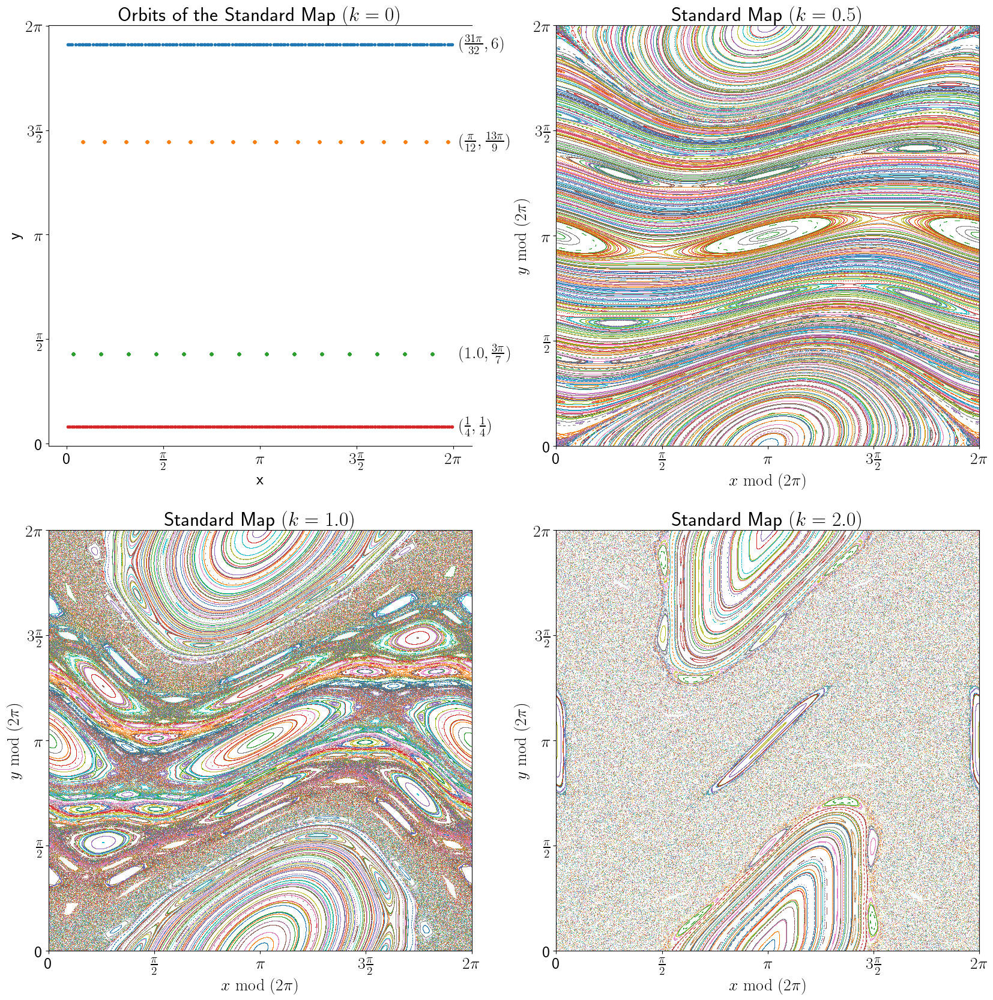

In [7]:
k_values = [0., 0.5, 1., 2.]
steps = 200  
q1 = [0, np.pi/2, np.pi, 3*np.pi/2, 2*np.pi]
q2 = ['0', '$\\frac{\pi}{2}$','$\pi$', '$3 \\frac{\pi}{2}$', '$2\pi$']
domain = np.linspace(-0.1, 2*np.pi+0.1, 25)
initial_conditions = [(31*np.pi/32, 6), (np.pi/12,13*np.pi/9), (1.0, 3*np.pi/7), (1/4, 1/4)]

icd = [r'$(\frac{31\pi}{32}, 6)$', r'$(\frac{\pi}{12},\frac{13\pi}{9})$',
       r'$(1.0, \frac{3\pi}{7})$', r'$(\frac{1}{4}, \frac{1}{4})$']

fig, ax = plt.subplots(2, 2, figsize=(20,20))          # 1, len(k_values), figsize=(45,9)
#fig.suptitle(r'The standard map $ \\ x_{n+1}=x_n+y_{n+1}, \\ y_{n+1}=y_n+k\sin x_n$',  y=1.25, fontsize=50)
ax = ax.flatten()
for i, ic in enumerate(initial_conditions):
    x0, y0 = ic
    x_values, y_values = iterate_f(standard_map, ic, k_values[0], steps)
    ax[0].text(2*np.pi+0.1, y0-0.05, icd[i], fontsize=20, ha='left')
    ax[0].plot(x_values, y_values, '.')
ax[0].spines['right'].set_color('none')    
ax[0].set_xticks(q1,q2)
ax[0].set_yticks(q1,q2)
ax[0].set_xlabel('x')
ax[0].set_ylabel('y')
ax[0].set_title(r'Orbits of the Standard Map $(k=0)$')

for i, k in enumerate(k_values[1:]):
    for xt in domain:
        for yt in domain:
            X0 = xt, yt
            xs, ys = iterate_f(standard_map, X0, k, 2000)
            ax[i+1].plot(xs, ys, ',',markersize=0.1, alpha=0.7)
    ax[i+1].set_title(f'Standard Map $(k = {k})$')
    ax[i+1].set_ylim(0, 2*np.pi)
    ax[i+1].set_xlim(0, 2*np.pi)
    ax[i+1].set_xlabel('$x$'+' $\mathrm{ mod }$'+' $(2\pi)$')
    ax[i+1].set_ylabel('$y$'+' $\mathrm{ mod }$'+' $(2\pi)$')
    ax[i+1].set_xticks(q1,q2)
    ax[i+1].set_yticks(q1,q2)

plt.show()

<span style="color:red">The motion of a bouncing ball, on successive bounces, when the floor oscillates sinosoidally can be described by the Chirikov map :                                                                                                                                      
$\qquad\begin{align} p_{n+1}&=p_n - k\sin q_n \\ q_{n+1}&=q_n + p_{n+1} \end{align} \\ \text{ where } -\pi\le p\le\pi ,\& -\pi\le q\le\pi $                                                                                                                                                                           
Construct 2D maps for $K=0.5,0.8,3.2,6.4$ by starting with random values of $p$ and $q$ and iterating them.                                
Use periodic boundary conditions, which means that if the iterated values of $p$ and $q$ exceed $\pi$,                          
a value of $2\pi$ is subtracted and whenever thay are less than $-\pi$,  a value of $2\pi$ is added.                             
Examine the maps after thousands of iterations and discuss the differences.                                                                                                          

To show that the map is area-preserving, we calculate the Jacobian matrix :                                                                                                                   
$\qquad\begin{align} p_{n+1}&=p_n - k\sin q_n \\ q_{n+1}&=q_n + p_{n+1}=q_n + p_n - k\sin q_n \end{align} $                                                         

$ \qquad J = \begin{pmatrix} \frac{\partial p_{n+1}}{\partial p_n} & \frac{\partial p_{n+1}}{\partial q_n} \\ \frac{\partial q_{n+1}}{\partial p_n} & \frac{\partial q_{n+1}}{\partial q_n} \end{pmatrix} = \begin{pmatrix} 1 & -K \cos q_n \\ 1 & 1 - K \cos q_n \end{pmatrix} $                                                                                                                                                                                     
The determinant of this matrix is :                                                                                                                                                           
$ \qquad \det \ (J)  = \begin{vmatrix} 1 & -K \cos q_n \\ 1 & 1 - K \cos q_n \end{vmatrix}= (1)(1 - K \cos q_n ) - (-K \cos q_n ) = 1 - K \cos q_n + K \cos q_n = 1 $                                                                                                            
This confirms that the map is area-preserving.

In [8]:
def chirikov_map(X, k):
    q,p = X
    p_next = (p - k * np.sin(q)) % (2*np.pi)
    
    if p_next > np.pi:
        p_next -= 2 * np.pi
    q_next = (q + p_next) % (2*np.pi)
    
    if q_next > np.pi:
        q_next -= 2 * np.pi   
        
    return  q_next, p_next

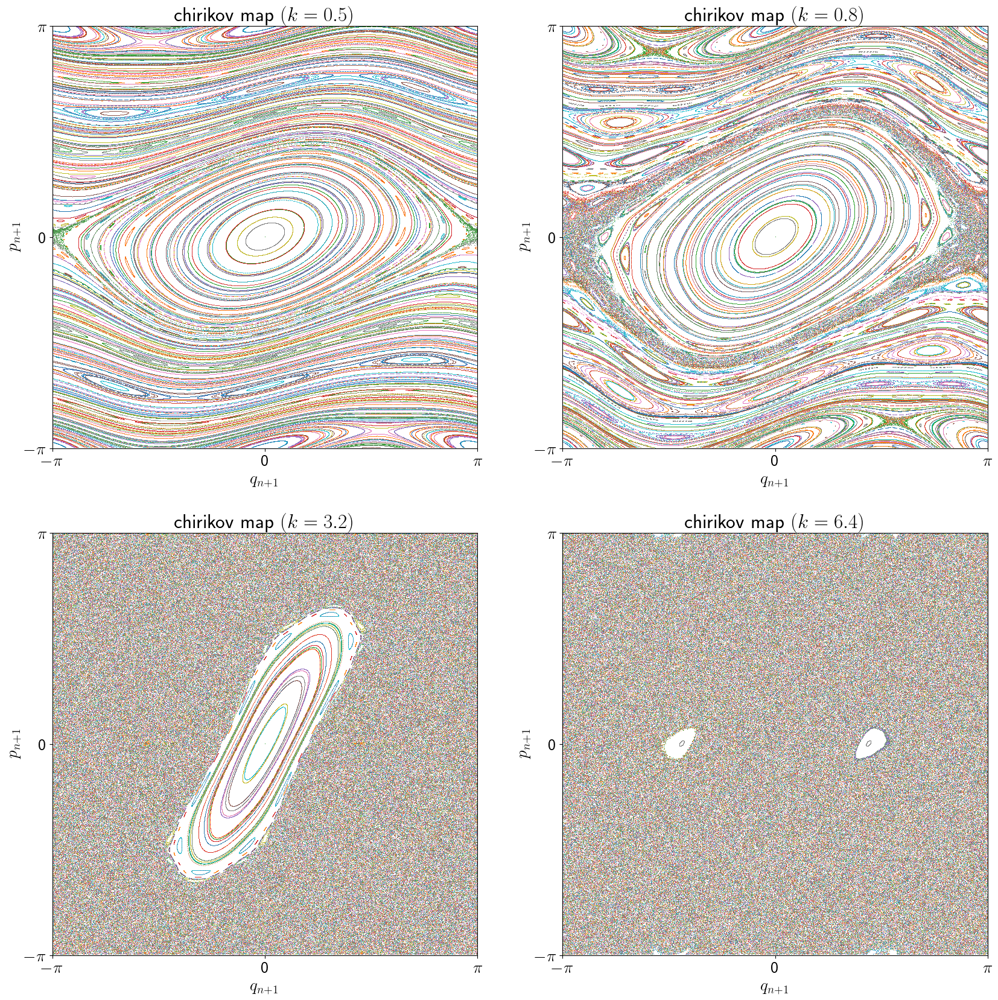

In [9]:
X0 = (0.0, 0.0) 
k_values = [0.5,0.8,3.2,6.4]  
domain = np.linspace(-0.1-np.pi, np.pi+0.1, 25)
q1 = [-np.pi, 0, np.pi]
q2 = ['$-\pi$', '0', '$\pi$']

fig, ax = plt.subplots(2, 2, figsize=(20, 20)) # 1, len(k_values), figsize=(45,9)
#fig.suptitle(r'The standard map $ \\ p_{n+1}=p_n-k\sin q_n, \\ q_{n+1}=q_n+p_{n+1}$',  y=1.2, fontsize=50)
ax = ax.flatten()

for i, k in enumerate(k_values):
    for xt in domain:
        for yt in domain:
            X0 = xt, yt
            xs, ys = iterate_f(chirikov_map, X0, k, 1000)
            ax[i].plot(xs, ys, ',',markersize=0.1, alpha=0.7)            
    ax[i].set_title(f'chirikov map $(k = {k})$')
    ax[i].set_ylim(-np.pi,np.pi)
    ax[i].set_xlim(-np.pi,np.pi)
    ax[i].set_xlabel('$q_{n+1}$')
    ax[i].set_ylabel('$p_{n+1}$')
    ax[i].set_xticks(q1,q2)
    ax[i].set_yticks(q1,q2)
plt.show()

# $$\text{Hénon’s area-preserving quadratic map}$$                                                                                    
<span style="color:red">The map                                                                                                                                            
$ \qquad\begin{align} x_{n+1}&=x_n\cos\alpha-(y_n-x_n^2)\sin\alpha \\ y_{n+1}&=x_n\sin\alpha+(y_n-x_n^2)\cos\alpha \end{align}$                                            
$\quad$ illustrates many of the remarkable properties of area-preserving maps (Hénon 1969, 1983).                                      
Here $0\le\alpha\le\pi$ is a parameter.                                                                                                                                                         
a) Verify that the map is area-preserving.                                                                                                                                                        
b) Find the inverse mapping.                                                                                                                                                        
c) Explore the map on the computer for various $\alpha$.                                                                                                                                                         
For instance, try $\cos\alpha=0.24,$ and use initial conditions in the square $-1\le x, y\le 1$.                                                                                                                                                        
You should be able to find a lovely chain of five islands surrounding the five points of a period-5 cycle.                                                                                                                                                        
Then zoom in on the neighborhood of the point $x=0.57, y=0.16$.                                                                                                                                                        
You’ll see smaller islands, and maybe even smaller islands around them!                                                                                                                                                         
The complexity extends all the way down to finer and finer scales.                                                                                                                                                         
If you modify the parameter to $\cos\alpha=0.22$, you’ll still see a prominent chain of five islands, but it’s now surrounded by a noticeable chaotic sea.                                                                                              
This mixture of regularity and chaos is typical for area-preserving maps (and for Hamiltonian systems, their continuous-time counterpart).

In [10]:
def henon_mapAP(X0, alpha):
    x, y = X0
    x_next = x * np.cos(alpha) - (y - x**2) * np.sin(alpha)
    y_next = x * np.sin(alpha) + (y - x**2) * np.cos(alpha)
    return x_next, y_next

$ \qquad \begin{aligned} x_{n+1} &= x_n \cos \alpha - (y_n - x_n^2) \sin \alpha, \\ y_{n+1} &= x_n \sin \alpha + (y_n - x_n^2) \cos \alpha, \end{aligned}  \qquad \qquad \qquad \qquad \qquad(1)$                                                      
$ \qquad$ where $0 \le \alpha \le \pi$, we need to:                                                      
$ \qquad J = \begin{pmatrix} \frac{\partial x_{n+1}}{\partial x_n} & \frac{\partial x_{n+1}}{\partial y_n} \\
\frac{\partial y_{n+1}}{\partial x_n} & \frac{\partial y_{n+1}}{\partial y_n} \end{pmatrix} = \begin{pmatrix}
\cos \alpha - 2x_n \sin \alpha & -\sin \alpha \\ \sin \alpha + 2x_n \cos \alpha & \cos \alpha \end{pmatrix}. $                                                      
$ \qquad \begin{aligned} \text{det}(J) &= (\cos \alpha - 2x_n \sin \alpha) \cdot \cos \alpha - (-\sin \alpha) \cdot (\sin \alpha + 2x_n \cos \alpha) \\ &= \cos^2 \alpha - 2x_n \sin \alpha \cos \alpha + \sin^2 \alpha + 2x_n \sin \alpha \cos \alpha \\ &= \cos^2 \alpha + \sin^2 \alpha \\ &= 1. \end{aligned}$                                                                                                                                                                      
$\qquad$Hence, the map is area-preserving.                                                         

To find the inverse mapping of the given map we need to express $ x_n $ and $ y_n $ in terms of $ x_{n+1} $ and $ y_{n+1}$.   
Let's start by isolating $ y_n $ and $ x_n $:                                                      
From $(1)$                                                      
$ \qquad\begin{aligned} x_{n+1} &= x_n \cos \alpha - y_n \sin \alpha + x_n^2 \sin \alpha, \qquad \qquad \qquad \qquad \quad(a) \\ y_{n+1} &= x_n \sin \alpha + y_n \cos \alpha - x_n^2 \cos \alpha.\qquad \qquad \qquad \qquad \quad(b) \end{aligned}$                                                      
From the equation $(b)$:                                                      
$\qquad y_{n+1} = x_n \sin \alpha + y_n \cos \alpha - x_n^2 \cos \alpha.$                                                      
Rearrange to solve for $ y_n $:                                                      
$\qquad\begin{aligned} y_n \cos \alpha &= y_{n+1} - x_n \sin \alpha + x_n^2 \cos \alpha. \\ y_n &= \frac{y_{n+1} - x_n \sin \alpha + x_n^2 \cos \alpha}{\cos \alpha}. \end{aligned}$                                                                        
Substitute $y_n$ into the equation $(a)$:                                                                                          
$\qquad\begin{aligned} x_{n+1} &= x_n \cos \alpha - \left( \frac{y_{n+1} - x_n \sin \alpha + x_n^2 \cos \alpha}{\cos \alpha} - x_n^2 \right) \sin \alpha. \\  &= x_n \cos \alpha - \left( \frac{y_{n+1}}{\cos \alpha} - \frac{x_n \sin \alpha}{\cos \alpha} + x_n^2 \right) \sin \alpha. \\  &= x_n \cos \alpha - \frac{y_{n+1} \sin \alpha}{\cos \alpha} + x_n \sin^2 \alpha - x_n^2 \sin \alpha. \\  &= x_n \cos \alpha - y_{n+1} \tan \alpha + x_n \sin^2 \alpha - x_n^2 \sin \alpha. \end{aligned}$                                                                                                                       

$\qquad x_n^2 \sin \alpha - x_n (\cos \alpha + \sin^2 \alpha) + x_{n+1} + y_{n+1} \tan \alpha = 0.$                                                      
$\qquad\sin \alpha \cdot x_n^2 - (\cos \alpha + \sin^2 \alpha) \cdot x_n + (x_{n+1} + y_{n+1} \tan \alpha) = 0.$                                                                                                                                             
                     
$ \qquad x_n = \frac{(\cos \alpha + \sin^2 \alpha) \pm \sqrt{(\cos \alpha + \sin \alpha^2)^2 - 4 \sin \alpha (x_{n+1} + y_{n+1} \tan \alpha)}}{2 \sin \alpha}.$                                                      
So, we get:                                                      
$\qquad\begin{aligned} x_n &= \frac{(\cos \alpha + \sin^2 \alpha) \pm \sqrt{(\cos \alpha + \sin^2 \alpha)^2 - 4 \sin \alpha (x_{n+1} + y_{n+1} \tan \alpha)}}{2 \sin \alpha}, \\ y_n &= \frac{y_{n+1} - x_n \sin \alpha + x_n^2 \cos \alpha}{\cos \alpha}. \end{aligned} $                                                      
This shows the inverse map.                                                         
Since the quadratic equation may have two roots,                                          
further analysis might be needed to determine which root corresponds to the original map's inversion                            
based on initial conditions or additional constraints.

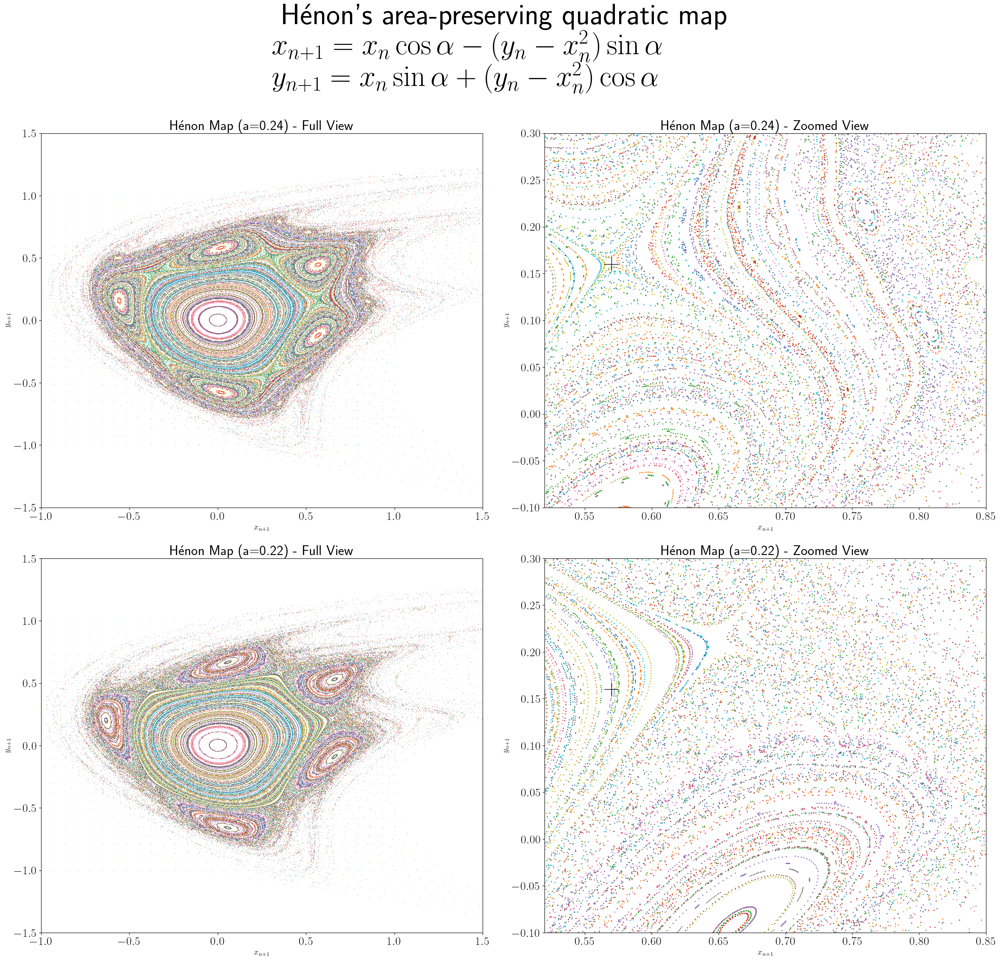

In [11]:
a_values = [0.24, 0.22]
domain = np.linspace(-1, 1, 30)
num_iterations = 500

fig, axes = plt.subplots(2, 2, figsize=(24,24))
fig.suptitle('Hénon’s area-preserving quadratic map' +
             r'$ \\ x_{n+1}=x_n\cos\alpha-(y_n-x_n^2)\sin\alpha $' +
             r'$ \\ y_{n+1}=x_n\sin\alpha+(y_n-x_n^2)\cos\alpha $', y=0.95, fontsize=50)

for i, a in enumerate(a_values):
    alpha = np.arccos(a)
    X_n, Y_n = [], []
    ax1 = axes[i, 0]
    ax2 = axes[i, 1]

    for xt in domain:
        for yt in domain:
            xs, ys = iterate_f(henon_mapAP, (xt, yt), alpha, num_iterations)
            X_n.extend(xs)  
            Y_n.extend(ys)
            ax1.plot(xs, ys, ',', markersize=1, alpha=1)
            ax2.plot(xs, ys, '.', markersize=2, alpha=1)
        
    #ax1.set_facecolor(plt.cm.gray(.1))
    ax1.set_xlabel(r'$x_{n+1}$', size=14)
    ax1.set_ylabel(r'$y_{n+1}$', size=14)
    ax1.set_xlim(-1., 1.5)
    ax1.set_ylim(-1.5, 1.5)
    ax1.set_title(f'Hénon Map (a={a}) - Full View')
    
    #ax2.set_facecolor(plt.cm.gray(.1))
    ax2.set_xlabel(r'$x_{n+1}$', size=14)
    ax2.set_ylabel(r'$y_{n+1}$', size=14)
    ax2.plot(0.57, 0.16, 'k+', ms=25)
    ax2.set_xlim(0.52, 0.85)
    ax2.set_ylim(-0.1, 0.3)
    ax2.set_title(f'Hénon Map (a={a}) - Zoomed View')
    #plot_path = os.path.join(output_dir, f'henon_map_a_{a}.jpeg')
    #plt.savefig(plot_path)
plt.tight_layout(rect=[0, 0, 1, 0.95])

plt.show(fig)

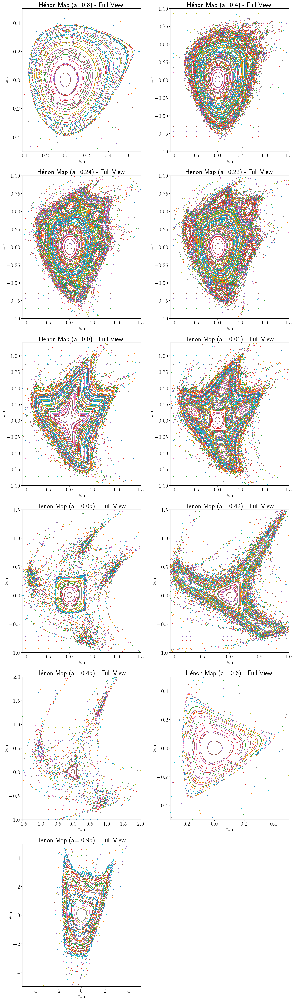

In [12]:
a_values = [0.8, 0.4, 0.24, 0.22, 0., -0.01, -0.05, -0.42, -0.45, -0.6, -0.95] 
domain1 = np.linspace(-1, 1, 30) 
domain2 = np.linspace(-5, 5, 25)  
num_iterations = 1000

xL = [[-0.4, 0.7],[-1, 1.5],[-1, 1.5],[-1, 1.5],[-1, 1.5],[-1, 1.5],[-1, 1.5],[-1, 1.0],[-1.5, 2.],[-0.3, 0.5],[-5, 5]] 
yL = [[-0.5, 0.5],[-1, 1.0],[-1, 1.0],[-1, 1.0],[-1, 1.2],[-1, 1.2],[-1, 1.5],[-1, 1.5],[-1.0, 2.],[-0.5, 0.5],[-5, 5]] 

fig, axes = plt.subplots(6, 2, figsize=(15, 50))
axes = axes.flatten()

for i, (a, ax) in enumerate(zip(a_values, axes)):
    alpha = np.arccos(a)
    X_n, Y_n = [], []
    
    domain = domain2 if i >= len(a_values) - 1 else domain1  

    for xt in domain:
        for yt in domain:
            xs, ys = iterate_f(henon_mapAP, (xt, yt), alpha, num_iterations)
            X_n.extend(xs)
            Y_n.extend(ys)
            ax.plot(xs, ys, ',', markersize=2, alpha=1)

    ax.set_xlabel(r'$x_{n+1}$', size=14)
    ax.set_ylabel(r'$y_{n+1}$', size=14)
    ax.set_xlim(xL[i])
    ax.set_ylim(yL[i])
    ax.set_title(f'Hénon Map (a={a}) - Full View')
fig.delaxes(axes[11])
plt.tight_layout()
plt.show()

# $$\textit{Henon Map}$$
#### <span style="color:red">Show that the product mapping $T′′′ T′′ T′$ is equivalent to the formulas given by  </span>                                              
<span style="color:red">$ \qquad\begin{equation*} T : \left\{\begin{array}{rl}x_{n+1} &= 1+y_n-ax_n^2,\\ \ y_{n+1} &= bx_n \end{array} \right.\end{equation*} \qquad\qquad\qquad\qquad\quad\qquad\qquad\qquad (1)$     </span>                                                                                     
<span style="color:red">where $a$ and $b$ are adjustable parameters.    </span>                                                                                          
                                                                   
                                                                                                                                     
Start with a rectangular region elongated along the x-axis (Figure a).                                                  
Stretch and fold the rectangle by applying the transformation                                                                 
$ \qquad\begin{equation*} T′ : \left\{\begin{array}{rl}x′&=x,\\ y′ &=1+y-ax^2 \end{array} \right.\end{equation*} \qquad\qquad\qquad\qquad\qquad\qquad\qquad\qquad (2)$                                                                                                       
(The primes denote iteration, not differentiation.)                                                                            
The bottom and top of the rectangle get mapped to parabolas (Figure b).                                                                
The parameter a controls the folding.                                                                                                 
Now fold the region even more by contracting Figure b along the x-axis:                                                         
$ \qquad\begin{equation*} T′′ : \left\{\begin{array}{rl}x′′&=bx′ &= bx,\\ 
y′′ &=y′ &= 1+y-ax^2 \end{array} \right.\end{equation*} \qquad\qquad\qquad\qquad\qquad\qquad \ (3)$                                                                                                                 
where $-1<b<1$.  This produces Figure c.                                                                                                 
Finally, come back to the orientation along the x-axis by reflecting across the line $y=x$ (Figure d):                          
$ \qquad\begin{equation*} T′′′ : \left\{\begin{array}{rl}x′′′&=y′′&=1+y-ax^2,\\ y′′′ &=x′′ &= bx \end{array} \right.\end{equation*} \qquad\qquad\qquad\qquad\qquad\qquad (4)$                                                                                                   
Then the composite transformation $ \begin{equation*} T= T''' \circ T'' \circ T' = \left\{\begin{array}{rl}x_{n+1} &= 1+y_n-ax_n^2,\\ \ y_{n+1} &= bx_n \end{array} \right.\end{equation*}$ yields the Hénon mapping $ \ (1), $                                                  
where we use the notation $( x_n, y_n )$ for $( x, y )$ and $( x_{n+1}, y_{n+1} )$ for $(x′′′, y′′′).$ 

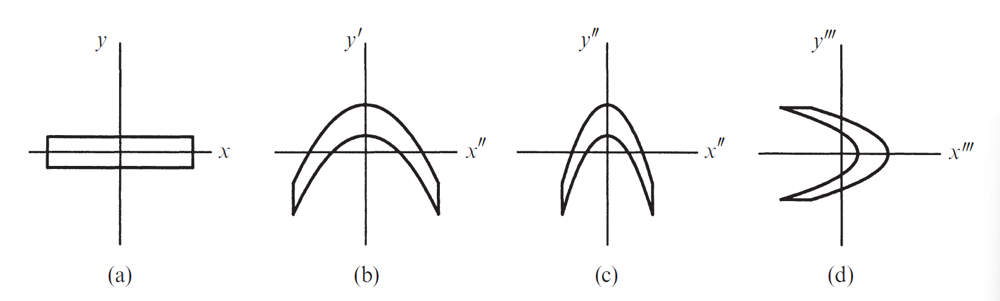

In [13]:
# Define the transformations
def dT(x, y, const):
    a, _  = const
    dx = x
    dy = 1 + y - a * x**2
    return dx, dy

def ddT(dx, dy, const):
    _, b = const
    ddx = b * dx
    ddy = dy
    return ddx, ddy

def dddT(ddx, ddy, const=None):
    dddx = ddy
    dddy = ddx
    return dddx, dddy

def T(x, y, const):
    return dddT(*ddT(*dT(x, y, const),const))

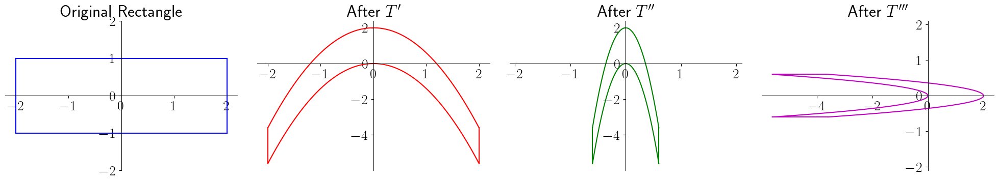

In [14]:
a = 1.4
b = 0.3
const = a, b

# Create a rectangular region elongated along the x-axis
x = np.linspace(-2, 2, 100)
y_b = -1 * np.ones_like(x)
y_t = 1 * np.ones_like(x)

# Apply T'
dx_b, dy_b = dT(x, y_b, const)
dx_t, dy_t = dT(x, y_t, const)

# Apply T''
ddx_b, ddy_b = ddT(dx_b, dy_b, const)
ddx_t, ddy_t = ddT(dx_t, dy_t, const)

# Apply T'''
dddx_b, dddy_b = dddT(ddx_b, ddy_b)
dddx_t, dddy_t = dddT(ddx_t, ddy_t)

# Plot the results
fig = plt.figure(figsize=(20, 4))
gs = fig.add_gridspec(1, 4)
ax1 = fig.add_subplot(gs[0, 0])
ax2 = fig.add_subplot(gs[0, 1])
ax3 = fig.add_subplot(gs[0, 2])
ax4 = fig.add_subplot(gs[0, 3])

# Customize axes
def customize_axes(ax):
    ax.spines['right'].set_color('none')
    ax.spines['top'].set_color('none')
    ax.xaxis.set_ticks_position('bottom')
    ax.spines['bottom'].set_position(('data', 0))
    ax.yaxis.set_ticks_position('left')
    ax.spines['left'].set_position(('data', 0))

# Original rectangle
ax1.plot(x, y_b, 'b-', x, y_t, 'b-')
ax1.plot([x[0], x[0]], [y_b[0], y_t[0]], 'b-')
ax1.plot([x[-1], x[-1]], [y_b[-1], y_t[-1]], 'b-')
ax1.set_title('Original Rectangle')
ax1.set_ylim(-2, 2)
customize_axes(ax1)

# After T'
ax2.plot(dx_b, dy_b, 'r-', dx_t, dy_t, 'r-')
ax2.plot([dx_b[0], dx_t[0]], [dy_b[0], dy_t[0]], 'r-')
ax2.plot([dx_b[-1], dx_t[-1]], [dy_b[-1], dy_t[-1]], 'r-')
ax2.set_title("After $T'$")
customize_axes(ax2)

# After T''
ax3.plot(ddx_b, ddy_b, 'g-', ddx_t, ddy_t, 'g-')
ax3.plot([ddx_b[0], ddx_b[0]], [ddy_b[0], ddy_t[0]], 'g-')
ax3.plot([ddx_b[-1], ddx_b[-1]], [ddy_b[-1], ddy_t[-1]], 'g-')
ax3.set_title("After $T''$")
ax3.set_xlim(-2.1, 2.1)
customize_axes(ax3)

# After T'''
ax4.plot(dddx_b, dddy_b, 'm-', dddx_t, dddy_t, 'm-')
ax4.plot([dddx_b[0], dddx_t[0]], [dddy_b[0], dddy_t[0]], 'm-')
ax4.plot([dddx_b[-1], dddx_t[-1]], [dddy_b[-1], dddy_t[-1]], 'm-')
ax4.set_ylim(-2.1, 2.1)
ax4.set_title("After $T'''$")
customize_axes(ax4)
plt.tight_layout()
plt.show()

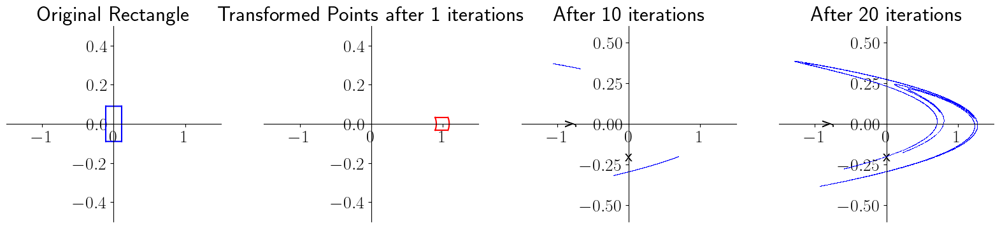

In [15]:
# Parameters
a = 1.4
b = 0.3

# Create a rectangular region elongated along the x-axis
x = np.linspace(-0.11, 0.11, 8000)
y_b = -0.09 * np.ones_like(x)
y_t =  0.09 * np.ones_like(x)

x_T_b, y_T_b = T(x, y_b, const)
x_T_t, y_T_t = T(x, y_t, const)

N = [10, 20]

# Plot the results
fig, ax = plt.subplots(1, len(N)+2, figsize=(20,4))
ax[0].plot(x, y_b, 'b-', x, y_t, 'b-')
ax[0].plot([x[ 0], x[ 0]], [y_b[ 0], y_t[ 0]], 'b-')
ax[0].plot([x[-1], x[-1]], [y_b[-1], y_t[-1]], 'b-')
ax[0].set_title('Original Rectangle')
ax[0].set_xlim(-1.5,1.5)
ax[0].set_ylim(-0.5,0.5)
customize_axes(ax[0])

ax[1].plot(x_T_b, y_T_b, 'r-', x_T_t, y_T_t, 'r-')
ax[1].plot([x_T_b[ 0], x_T_t[ 0]], [y_T_b[ 0], y_T_t[ 0]], 'r-')
ax[1].plot([x_T_b[-1], x_T_t[-1]], [y_T_b[-1], y_T_t[-1]], 'r-')
ax[1].set_title(f'Transformed Points after 1 iterations')
ax[1].set_xlim(-1.5,1.5)
ax[1].set_ylim(-0.5,0.5)
customize_axes(ax[1])

#x_T_b, y_T_b = Tinv(x_T_b, y_T_b , a, b)
#x_T_t, y_T_t = Tinv(x_T_t, y_T_t , a, b)

for i,n in enumerate(N):
    for _ in range(2,n+1):
        x_T_b, y_T_b = T(x_T_b, y_T_b, const)
        x_T_t, y_T_t = T(x_T_b, y_T_b, const)
      
    ax[i+2].plot(x_T_b, y_T_b, 'b,')
    ax[i+2].plot(x_T_t, y_T_t, 'b,')
    ax[i+2].set_title(f'After {n} iterations')
    ax[i+2].set_xlabel('x')
    ax[i+2].set_ylabel('y')
    ax[i+2].set_xlim(-1.5,1.5)
    ax[i+2].set_ylim(-0.6,0.6)
    customize_axes(ax[i+2])
    
plt.show()

#### <span style="color:red">Q. Redraw Figure , using an ellipse instead of a rectangle as the test shape.  </span>                                                        
 <span style="color:red">a) Sketch the successive images of the ellipse under the maps $T′, T′′, T′′′$   </span>                                                          
 <span style="color:red">b) Represent the ellipse parametrically and draw accurate plots on a computer.  </span>

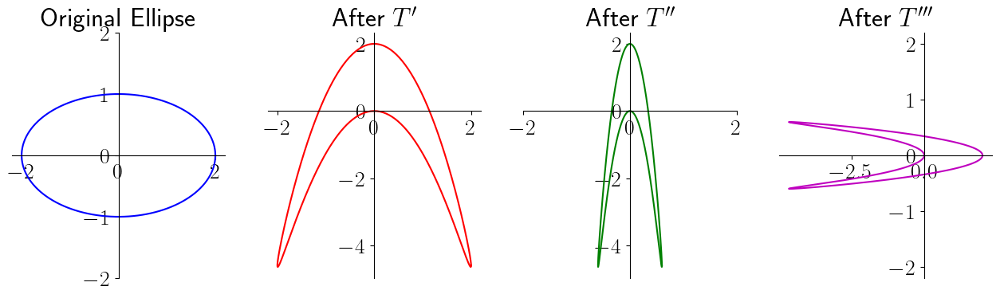

In [16]:
# Parameters
a = 1.4
b = 0.3
const = 1.4, 0.3
# Generate points on an ellipse
theta = np.linspace(0, 2*np.pi, 400)
x = 2 * np.cos(theta)  # x-coordinates of the ellipse
y = np.sin(theta)      # y-coordinates of the ellipse

# Apply T'
dx, dy = dT(x, y, const)

# Apply T''
ddx, ddy = ddT(dx, dy, const)

# Apply T'''
dddx, dddy = dddT(ddx, ddy)

# Apply T
X, Y = T(x, y, const)

# Plot the results
# Plot the results
fig = plt.figure(figsize=(20, 4))
gs=fig.add_gridspec(1,5)
ax1=fig.add_subplot(gs[0,0])
ax2=fig.add_subplot(gs[0,1])
ax3=fig.add_subplot(gs[0,2])
ax4=fig.add_subplot(gs[0,3])

# Plot original ellipse
ax1.plot(x, y, 'b-', label='Original Ellipse')
ax1.set_title('Original Ellipse')
ax1.set_ylim(-2,2)
customize_axes(ax1)

# Plot transformed ellipses
ax2.plot(dx, dy, 'r-', label="After T'")
ax2.set_title("After $T'$")
customize_axes(ax2)

ax3.plot(ddx, ddy, 'g-', label="After T''")
ax3.set_title("After $T''$")
ax3.set_xlim(-2,2)
customize_axes(ax3)

ax4.plot(dddx, dddy, 'm-', label="After T'''")
#ax4.plot(X, Y, 'k--')
ax4.set_title("After $T'''$")
ax4.set_ylim(-2.2,2.2)
customize_axes(ax4)

plt.show()

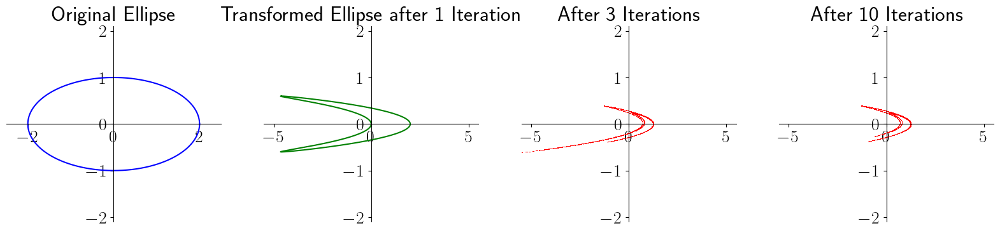

In [17]:
# Parameters
a = 1.4
b = 0.3
const = a, b
# Define the ellipse parameters
theta = np.linspace(0, 2*np.pi, 40000)
x = 2 * np.cos(theta)
y = np.sin(theta)

# Apply the inverse transformation
x_T, y_T = T( x, y, const)

# Number of iterations
N = [3, 10]

# Plotting setup
fig, ax = plt.subplots(1, len(N)+2, figsize=(20,4))

# Plot original ellipse
ax[0].plot(x, y, 'b-')
ax[0].set_title('Original Ellipse')
ax[0].set_xlim(-2.5, 2.5)
ax[0].set_ylim(-2.1, 2.1)
customize_axes(ax[0])

# Plot transformed ellipse after 1 iteration
ax[1].plot(x_T, y_T, 'g-')
ax[1].set_title('Transformed Ellipse after 1 Iteration')
ax[1].set_xlim(-5.50, 5.50)
ax[1].set_ylim(-2.1, 2.1)
customize_axes(ax[1])

# Perform iterations and plot results
for i, n in enumerate(N):
    for _ in range(n+1):
        x_T, y_T = T( x_T, y_T, const)
    ax[i+2].plot(x_T, y_T, 'r,')
    ax[i+2].set_title(f'After {n} Iterations')
    ax[i+2].set_xlim(-5.50, 5.50)
    ax[i+2].set_ylim(-2.1, 2.1)
    customize_axes(ax[i+2])
    
plt.show()

#### <span style="color:red">Q. Show that the transformations $T′$ and $T′′′$ are area-preserving, but $T′′$ is not.</span> 



##### Area-Preserving Transformation:

A transformation $T$ on the plane is area-preserving if the determinant of the Jacobian matrix of the transformation is equal to $\pm 1$.                                                                                                                                        
The Jacobian matrix of a transformation $T(x, y) = (u(x, y), v(x, y))$ is given by:

$ \qquad J_T = \begin{pmatrix} \frac{\partial u}{\partial x} & \frac{\partial u}{\partial y} \\ \frac{\partial v}{\partial x} & \frac{\partial v}{\partial y} \end{pmatrix} $

The transformation $T$ is area-preserving if :

$ \qquad \det(J_T) = \frac{\partial u}{\partial x} \frac{\partial v}{\partial y} - \frac{\partial u}{\partial y} \frac{\partial v}{\partial x} = \pm 1  $

###### 1. **Check $T'$ for Area Preservation:**

$ \qquad\begin{equation*} T′ : \left\{\begin{array}{rl}x′&=x,\\ y′ &=1+y-ax^2 \end{array} \right.\end{equation*} \qquad\qquad\qquad\qquad\qquad\qquad\qquad\qquad $ 

Compute the Jacobian matrix $ J_{T'} $ for the transformation $ T' $ :

$ \qquad J_{T'} = \begin{pmatrix} \frac{\partial x'}{\partial x} & \frac{\partial x'}{\partial y} \\ \frac{\partial y'}{\partial x} & \frac{\partial y'}{\partial y} \end{pmatrix} = \begin{pmatrix} 1 & 0 \\ -2ax & 1 \end{pmatrix} $

Since $\det \ J_{T'} = 1 ,$ then $ T' $ is area-preserving.

###### 2. **Check $T''$ for Area Preservation:**

$ \qquad\begin{equation*} T′′ : \left\{\begin{array}{rl}x′′&=bx′ ,\\ y′′ &=y′ \end{array} \right.\end{equation*} \qquad\qquad\qquad\qquad\qquad\qquad $         

Similarly, compute the Jacobian matrix $J_{T''}$ for the transformation $T''$ :

$ \qquad J_{T''} = \begin{pmatrix} \frac{\partial x''}{\partial x'} & \frac{\partial x''}{\partial y'} \\ \frac{\partial y''}{\partial x'} & \frac{\partial y''}{\partial y'} \end{pmatrix} = \begin{pmatrix} b & 0 \\ 0 & 1 \end{pmatrix} $

Since $\det \ J_{T''} = b \ne\pm 1  ,$ then $ T'' $ is **not** area-preserving.

###### 3. **Check $T'''$ for Area Preservation:**

$ \qquad\begin{equation*} T′′′ : \left\{\begin{array}{rl}x′′′&=y′′,\\ y′′′ &=x′′ \end{array} \right.\end{equation*} \qquad\qquad\qquad\qquad\qquad\qquad $                                                                 
Finally, compute the Jacobian matrix $J_{T'''}$ for the transformation $T'''$ :
 
$ \qquad J_{T'''} = \begin{pmatrix} \frac{\partial x'''}{\partial x''} & \frac{\partial x'''}{\partial y''} \\ \frac{\partial y'''}{\partial x''} & \frac{\partial y'''}{\partial y''} \end{pmatrix} = \begin{pmatrix} 0 & 1 \\ 1 & 0 \end{pmatrix} $

Since $\det \ J_{T'''} = -1 ,$ then $ T''' $ is area-preserving.

In [18]:
def jacobian(f, x, y, const, eps=1e-6):
    u, v = f(x, y, const)
    u_x = (f(x + eps, y, const)[0] - u) / eps
    u_y = (f(x, y + eps, const)[0] - u) / eps
    v_x = (f(x + eps, y, const)[1] - v) / eps
    v_y = (f(x, y + eps, const)[1] - v) / eps
    return np.array([[u_x, u_y], [v_x, v_y]])

def is_area_preserving(f, a, b, x=1.0, y=1.0):
    const = a, b
    J = jacobian(f, x, y, const)
    det_J = np.round(np.linalg.det(J), 2)
    print(f"Jacobian matrix:\n{J}")
    print(f"Determinant of Jacobian: {det_J}")
    print("Is the function Area-Preserving :",np.isclose(det_J, 1) or np.isclose(det_J, -1))
    return ' '

In [19]:
a, b = 1.4, 0.3

print("Checking T':- ")
print(is_area_preserving(dT,a, b))
print("Checking T'':- ")
print(is_area_preserving(ddT,a, b))
print("Checking T''':- ")
print(is_area_preserving(dddT,a, b))

Checking T':- 
Jacobian matrix:
[[ 1.         0.       ]
 [-2.8000014  1.       ]]
Determinant of Jacobian: 1.0
Is the function Area-Preserving : True
 
Checking T'':- 
Jacobian matrix:
[[0.3 0. ]
 [0.  1. ]]
Determinant of Jacobian: 0.3
Is the function Area-Preserving : False
 
Checking T''':- 
Jacobian matrix:
[[0. 1.]
 [1. 0.]]
Determinant of Jacobian: -1.0
Is the function Area-Preserving : True
 


#### <span style="color:red">Q. Find all the fixed points of the Hénon map and show that they exist only if $a > a_o$, where $a_o$ is to be determined.</span>
                                                                                                                                
We start with the system ,                                                                                                      
$ \qquad\begin{equation*} T(x,y): \left\{\begin{array}{rl}x_{n+1} &= 1+y_n-ax_n^2,\\ \ y_{n+1} &= bx_n \end{array} \right.\end{equation*} \qquad\qquad\qquad\qquad(1)$                                                                                                                             
Let set $ x_{n+1}=x_n , \ y_{n+1}=y_n $                                                                                             
We then re-write the eqn. as                                                                                                       
$ \qquad T\begin{pmatrix} x \\ y \end{pmatrix}=\begin{pmatrix} x \\ y \end{pmatrix}$                                           

or, $ \quad \begin{pmatrix} 1+y-ax^2 \\ bx \end{pmatrix}=\begin{pmatrix} x \\ y \end{pmatrix}$                                        
From here we get,                                                                                                                
$ \qquad\begin{aligned} y &= bx  \qquad \qquad \qquad\qquad\quad\qquad \qquad\qquad\qquad\quad \ (2) \\ x &= 1+y-ax^2=1+bx-ax^2\qquad\qquad\qquad\qquad\quad(3) \end{aligned}$                                                                         

Now evaluating (3)                                                                                                                
$ \qquad\begin{aligned}  x &=1+bx-ax^2 \\ ax^2+x-bx-1 &= 0 \\ ax^2 + (1-b)x - 1 &= 0  \qquad\qquad\qquad\qquad\qquad\qquad\quad (4) \qquad\qquad [\text{ characteristic fixed points eqn.}] \end{aligned}$                         

$ \qquad\begin{aligned}x &= \frac{-(1-b)\pm\sqrt{(1-b)^2+4a}}{2a} = \frac{(b-1)\pm\sqrt{(1-b)^2+4a}}{2a} \qquad\qquad (5) \end{aligned}$                                           
From eqn. (5) we get the fixed points as :                                                                                          
$ \qquad\begin{aligned}  x_1 &= \frac{1}{2a} \bigg((b-1) + \sqrt{(1-b)^2+4a} \bigg) , \quad y_1 = bx_1 = \frac{b}{2a} \bigg((b-1) + \sqrt{(1-b)^2+4a} \bigg) \\ x_2 &= \frac{1}{2a} \bigg((b-1) - \sqrt{(1-b)^2+4a} \bigg) , \quad y_2 = bx_2 = \frac{b}{2a} \bigg((b-1) - \sqrt{(1-b)^2+4a} \bigg)\end{aligned}$                                                                    
                                                                                                                                   
From eqn. (5), Discriminant Condition :                                                                                        
For $x$ to be real, the discriminant of the quadratic equation must be non-negative :                                                  
$ \qquad\begin{aligned}  \mathrm{Discriminant }  (D) : (1-b)^2 + 4a &\ge 0 \\ a &\ge-\frac{(1-b)^2}{4} \end{aligned} $                
For the fixed points to exist, the discriminant must be non-negative.                                                        
Therefore, the threshold value for $a$ is : $ a_o = -\frac{(1-b)^2}{4}  $                                                                  
The fixed points of the Hénon map exist only if $𝑎\ge 𝑎_𝑜$, where $ a_o = -\frac{(1-b)^2}{4}  $                                 
This condition ensures that the discriminant of the quadratic equation is non-negative, allowing for real solutions for $x$ and subsequently for $y$

#### <span style="color:red">Q. Calculate the Jacobian matrix of the Hénon map and find its eigenvalues. </span>                                                                                                   
                                                                                                                                      
We start with the system ,                                                                                                      
$ \qquad\begin{equation*} T(x,y): \left\{\begin{array}{rl}x_{n+1} &= 1+y_n-ax_n^2,\\ \ y_{n+1} &= bx_n \end{array} \right.\end{equation*} \qquad\qquad\qquad\qquad(1)$                                                                                                                                                                                                     
We can re-write (1) as                                                                                                            
$\qquad T=\begin{pmatrix} 1+y_n-ax_n^2 \\ bx_n \end{pmatrix} \qquad\qquad\qquad\qquad\qquad\quad\qquad(2)$                                                                         
Jacobian of the matrix $T$ can be written as                                                                                            
$\qquad\qquad J = \begin{pmatrix} \frac{\partial x_{n+1}}{\partial x_n} & \frac{\partial x_{n+1}}{\partial y_n} \\ \frac{\partial y_{n+1}}{\partial x_n} & \frac{\partial y_{n+1}}{\partial y_n} \end{pmatrix}=\begin{pmatrix} -2ax & 1 \\ b & 0 \end{pmatrix} \qquad\qquad\quad \ \ (3)$                                                                                     

Evaluating the eigenvalue                                                                                                                   
$\quad \begin{aligned} &{\therefore} \qquad \det(J-\lambda I) &= 0 \qquad\qquad\qquad\qquad \qquad\qquad\qquad\qquad                                 
\\ &{or,}\qquad | J - \lambda I | &=  0 \qquad\qquad\qquad\qquad \qquad\qquad\qquad\qquad                           
\\ &{or,}\qquad \begin{vmatrix} {\begin{pmatrix} -2ax & 1 \\ b & 0 \end{pmatrix}} - \lambda {\begin{pmatrix} 1 & 0 \\ 0 & 1 \end{pmatrix}} \end{vmatrix}  &=  0       \qquad\qquad\qquad\qquad \qquad\qquad\qquad\qquad                                                                                    
\\ &{or,} \qquad\begin{vmatrix} -2ax-\lambda & 1 \\ b & -\lambda \end{vmatrix} &= 0  \qquad\qquad\qquad\qquad \qquad\qquad\qquad\qquad                                               
\\ &{or,} \qquad (-2ax-\lambda)(-\lambda)-(1)(b) &= 0 \qquad\qquad\qquad\qquad \qquad\qquad\qquad\qquad                                                           
\\ &{or,}\qquad \lambda^2+2ax\lambda-b &=0 \qquad\qquad\qquad\quad  (4)  \qquad [\text{ characteristic eigenvalue eqn.}] \end{aligned} $                                                                         

$\quad \begin{aligned} {or,}\qquad \lambda &= \frac{-2ax\pm\sqrt{(2ax)^2+4b}}{2} = ax\pm\sqrt{(ax)^2+b} \end{aligned} \qquad(5) $                                                                                                                           
From eqn. (5) we get the eigenvalues                                                                                                 
$\quad \begin{aligned} \lambda_1 &= ax+\sqrt{(ax)^2+b} \\ \lambda_2 &= ax-\sqrt{(ax)^2+b} \end{aligned} $                           
For $\lambda_{1,2}$ to be real, the discriminant of the quadratic equation must be non-negative :                                       
$\quad i.e. \quad  \begin{aligned} (ax)^2+b \ge 0 \end{aligned} $ 

#### <span style="color:red">Q. A fixed point of a map is linearly stable if and only if all eigen values of the Jacobian satisfy $| \lambda | < 1$. </span>  
#### <span style="color:red"> $ \quad $Determine the stability of the fixed points of the Hénon map, as a function of $a$ and $b$. </span>    
#### <span style="color:red"> $ \quad $Show that one fixed point is always unstable, while the other is stable for a slightly larger than $a_0$. </span>  
#### <span style="color:red"> $ \quad $Show that this fixed point loses stability in a flip bifurcation $(\lambda = −1)$ at $a_1 = \frac{3}{4} (1 − b)^2$.     </span>                                  
                                                                                                                                     
To determine the stability of the fixed points of the Hénon map,                                                          
We start with the system ,                                                                                                      
$ \qquad\begin{equation*} T(x,y): \left\{\begin{array}{rl}x_{n+1} &= 1+y_n-ax_n^2,\\ \ y_{n+1} &= bx_n \end{array} \right.\end{equation*} \qquad\qquad\qquad\qquad(1)$                     
#### Fixed Points
Let set $ x_{n+1}=x_n , \ y_{n+1}=y_n $                                                                                             
We then re-write the eqn. as                                                                                                       
$ \qquad T\begin{pmatrix} x \\ y \end{pmatrix}=\begin{pmatrix} x \\ y \end{pmatrix}$                                           

or, $ \quad \begin{pmatrix} 1+y-ax^2 \\ bx \end{pmatrix}=\begin{pmatrix} x \\ y \end{pmatrix}$                                        
From here we get,                                                                                                                
$ \qquad\begin{aligned} y &= bx  \qquad \qquad \qquad\qquad\quad\qquad \qquad\qquad\qquad\quad (2) \\ x &= 1+y-ax^2=1+bx-ax^2\qquad\qquad\qquad\qquad\quad(3) \end{aligned}$                                                                         

Now evaluating (3)                                                                                                                
$ \qquad\begin{aligned}  x &=1+bx-ax^2 \\ ax^2+x-bx-1 &= 0 \\ ax^2 + (1-b)x - 1 &= 0  \qquad\qquad\qquad\qquad\qquad\qquad\quad (4) \ [\text{ characteristic fixed points eqn.}] \\ x &= \frac{-(1-b)\pm\sqrt{(1-b)^2+4a}}{2a} \\ x &= \frac{(b-1)\pm\sqrt{(1-b)^2+4a}}{2a} \qquad\qquad (5) \end{aligned}$                                           
From eqn. (5) we get the fixed points as :                                                                                          
$ \qquad\begin{aligned}  x_1 &= \frac{1}{2a} \bigg((b-1) + \sqrt{(1-b)^2+4a} \bigg) , \quad y_1 = bx_1 = \frac{b}{2a} \bigg((b-1) + \sqrt{(1-b)^2+4a} \bigg) \\ x_2 &= \frac{1}{2a} \bigg((b-1) - \sqrt{(1-b)^2+4a} \bigg) , \quad y_2 = bx_2 = \frac{b}{2a} \bigg((b-1) - \sqrt{(1-b)^2+4a} \bigg)\end{aligned}$                                                                    
                                                                                                                                   
In the special case $b=1$ , this is simplified to                                                                             
$ \qquad x\big{|}_{b=1} = \frac{(1-1)\pm\sqrt{(1-1)^2+4a}}{2a} = \frac{\pm2\sqrt{a}}{2a} = \frac{\pm\sqrt{a}}{a}$               

If, in addition, $a$ is in the form $\frac{1}{c^n}$ the formula is further simplified to                                    
$ \qquad x\big{|}_{b=1} = \frac{\pm\sqrt{c^{-n}}}{c^{-n}} = \frac{\pm c^{-n/2}}{c^{-n}} = \pm c^{-n/2} \cdot c^{n}  = \pm c^{n/2} $                                                                                                                   

In practice the starting point $(x,x)$ will follow a $4-$point loop in two dimensions passing through all quadrants.            
$ \qquad\begin{aligned} (x,x) &=(x,-x) \\ (x,-x) &=(-x,-x) \\ (-x,-x) &=(-x,x) \\ (-x,x) &=(x,x) \end{aligned}$   
                                                                                                                                     
From eqn. (5), Discriminant Condition :                                                                                        
For $x$ to be real, the discriminant of the quadratic equation must be non-negative :                                                  
$ \qquad\begin{aligned}  \mathrm{Discriminant }  (D) : (1-b)^2 + 4a &\ge 0 \\ a &\ge-\frac{(1-b)^2}{4} \end{aligned} $                
For the fixed points to exist, the discriminant must be non-negative.                                                        
Therefore, the threshold value for $a$ is : $ a_o = -\frac{(1-b)^2}{4}  $                                                                  
The fixed points of the Hénon map exist only if $𝑎\ge 𝑎_𝑜$, where $ a_o = -\frac{(1-b)^2}{4}  $                                           
#### Eigenvalues of the Jacobian
The Jacobian matrix $J$ of the Hénon map is given by:

$J = \begin{pmatrix} \frac{\partial x_{n+1}}{\partial x_n} & \frac{\partial x_{n+1}}{\partial y_n} \\ \frac{\partial y_{n+1}}{\partial x_n} & \frac{\partial y_{n+1}}{\partial y_n} \end{pmatrix} = \begin{pmatrix} -2ax_n & 1 \\ b & 0 \end{pmatrix}$                                                                                                                    

The eigenvalues $\lambda$ of the Jacobian matrix $J$ at a fixed point $(x, y)$ are found by solving the characteristic equation:

$\quad \begin{aligned} &{\therefore} \qquad \det(J-\lambda I) &= 0                                                                          
\\ &{or,}\qquad | J - \lambda I | &=  0                                                                                                 
\\ &{or,}\qquad \begin{vmatrix} {\begin{pmatrix} -2ax & 1 \\ b & 0 \end{pmatrix}} - \lambda {\begin{pmatrix} 1 & 0 \\ 0 & 1 \end{pmatrix}} \end{vmatrix}  &=  0                                                                                                      
\\ &{or,} \qquad\begin{vmatrix} -2ax-\lambda & 1 \\ b & -\lambda \end{vmatrix} &= 0                                               
\\ &{or,} \qquad (-2ax-\lambda)(-\lambda)-(1)(b) &= 0                                                                                                          
\\ &{or,}\qquad \lambda^2+2ax\lambda-b   &=0    \end{aligned}$                                                                             

$ \therefore \quad\lambda^2+2ax\lambda-b = 0 \qquad(6)$ is the characteristic eigenvalue eqn.                                    

$\quad \begin{aligned} {or,}\qquad \lambda &= \frac{-2ax\pm\sqrt{(2ax)^2+4b}}{2} = -ax\pm\sqrt{(ax)^2+b} \end{aligned} \qquad(7) $                                                                                                                                                                            

#### Stability Analysis

A fixed point is linearly stable if and only if all eigenvalues $ \lambda $ satisfy $ | \lambda | < 1 $.

1. **First Fixed Point $(x_1, y_1) $**:
    $    x_1 = \frac{1}{2a} \left( (b - 1) + \sqrt{(1 - b)^2 + 4a} \ \right)$

    Substituting $ x = x_1 $ in the eigenvalue equation, we get:                                                                    
    $    \lambda = -ax_1 \pm \sqrt{a^2 x_1^2 + b} $

    Since $ x_1 > 0 $, one of the eigenvalues $\lambda_1 = -ax_1 + \sqrt{a^2 x_1^2 + b} $ will always be positive and larger than 1 for $ a > 0 $.                                                                                                           
    Hence, this fixed point is always unstable.

2. **Second Fixed Point $(x_2, y_2)$**:
    $    x_2 = \frac{1}{2a} \left( (b - 1) - \sqrt{(1 - b)^2 + 4a} \ \right)$

    Substituting $ x = x_2 $ in the eigenvalue equation, we get:
    $     \lambda = -ax_2 \pm \sqrt{a^2 x_2^2 + b} $

    Since $ x_2 < 0 $, one of the eigenvalues $\lambda_2 = -ax_2 - \sqrt{a^2 x_2^2 + b}$ can be less than 1 for certain values of $a$ and $b$.

#### Stability Condition and Flip Bifurcation

From the characteristic Eigenvalue equation:                                                                                                 
$ \quad\begin{aligned} {\therefore} \qquad\qquad \lambda^2+2ax\lambda-b &=0 \qquad\qquad [\text{from eqn. 6 }] \\  (-1)^2 + 2ax(-1) - b &= 0 \qquad\qquad [\text{Given flip condition }: \lambda=-1 ] \\ 1 -2ax-b &=0 \\ 2ax &=1-b \\ x &= \frac{1-b}{2a} \qquad\qquad\qquad\qquad (8) \end{aligned} $                         
Substituting $ x $ in the fixed point equation:                                                                                     
$ \quad\begin{aligned}{\therefore} \quad\qquad\qquad\qquad  ax^2+(1-b)x-1 &=0 \qquad\qquad [\text{from eqn. 4 }] \\ a\bigg(\frac{1-b}{2a}\bigg)^2 + (1-b)\bigg(\frac{1-b}{2a}\bigg) -1 &= 0  \qquad\qquad [\text{substituting the value of }x \text{ from eqn. 8 }] \\ a\frac{(1-b)^2}{4a^2} + \frac{(1-b)^2}{2a}-1 &= 0 \\ \frac{(1-b)^2}{4a} + \frac{(1-b)^2}{2a}-1 &= 0 \\ \frac{(1-b)^2+2(1-b)^2-4a}{4a} &= 0 \\ \frac{3(1-b)^2-4a}{4a} &= 0 \\ 3(1-b)^2-4a &= 0 \\ 4a &= 3(1-b)^2 \\ a &= \frac{3}{4}(1-b)^2 = a_1 (\text{let's name it}) 
 \end{aligned} $

Thus, the fixed point $(x_2, y_2)$ loses stability in a flip bifurcation when $ a = \frac{3}{4}(1 - b)^2 $.

### Conclusion

One fixed point is always unstable, while the other is stable for $a$ slightly larger than $a_o$.                     
The stable fixed point loses stability in a flip bifurcation at $ a_1 = \frac{3}{4}(1 - b)^2 $.                                                                                                                                     

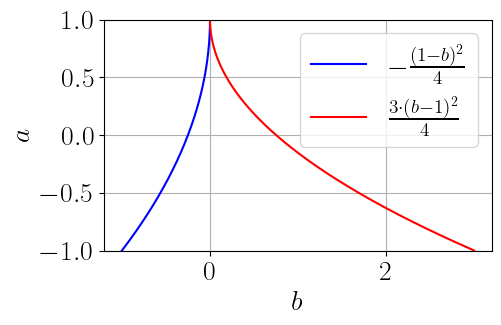

In [20]:
b_values = np.linspace(-1, 1, 400)
a_lower = [-(1-b)**2/4 for b in b_values]
a_upper = [(b - 1)**2 * 3/4 for b in b_values]

plt.figure(figsize=(5,3))
plt.plot( a_lower, b_values, 'b-', label=r'$-\frac{(1-b)^2}{4}$')
plt.plot( a_upper, b_values, 'r-', label=r'$\frac{3\cdot(b - 1)^2 }{4}$')

plt.xlabel('$b$')
plt.ylabel('$a$')
plt.legend(loc='upper right',fontsize=20)
plt.ylim([b_values.min(), b_values.max()])
plt.grid(True)
plt.show()

In [21]:
def henon_map(X, const):
    a, b = const 
    x, y = X
    x_n = 1 + y - a * x * x
    y_n = b * x
    return np.array([x_n, y_n])

def henoninverse_map(X, const):
    a, b = const 
    x, y = X
    x_n = y / b
    y_n = x - 1 + a * x_n * x_n 
    return np.array([x_n, y_n])

def jacobian_henon(X, const):
    a, b = const
    x, y = X
    return np.array([[-2 * a * x, 1],
                     [         b, 0]])

def fixed_points_henon(a, b):
    discriminant = np.sqrt((1 - b)**2 + 4 * a)
    x1 = (b-1 + discriminant) / (2 * a)
    x2 = (b-1 - discriminant) / (2 * a)
    y1 = b * x1
    y2 = b * x2
    return np.array([[x1, y1], [x2, y2]])

In [22]:
fps=fixed_points_henon(a=1, b=1)
for fp in fps:
    x,y = fp
    print(f'x={x},y={y}')

x=1.0,y=1.0
x=-1.0,y=-1.0


In [23]:
a, b = 1.4, 0.3
fps=fixed_points_henon(a, b)
for fp in fps:
    x,y = fp
    print(f'x={x}, y={y}')

x=0.6313544770895047, y=0.1894063431268514
x=-1.1313544770895048, y=-0.3394063431268514


In [24]:
x, y = fps[0]
print(f'x={x},y={y}')

J = jacobian_henon(fps[0], (a, b))
print('Jacobian of Henon :')
print(J)

eig = np.linalg.eig(J)
lambda1 = eig[0][0]
lambda2 = eig[0][1]
v1 = eig[1][:, 0]
v2 = eig[1][:, 1]

print('\u03BB_1 =',lambda1,'x_1 =', v1)
print('\u03BB_2 =',lambda2,'x_2 =', v2)

x=0.6313544770895047,y=0.1894063431268514
Jacobian of Henon :
[[-1.76779254  1.        ]
 [ 0.3         0.        ]]
λ_1 = -1.9237388581534067 x_1 = [-0.98805776  0.15408397]
λ_2 = 0.15594632230279395 x_2 = [-0.46122777 -0.88728178]


### <span style="color:red">Deep study of the Henon map</span>

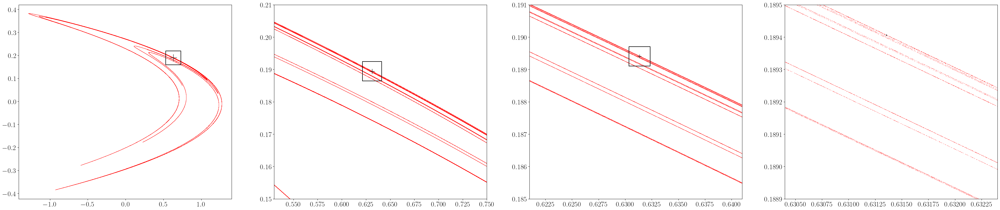

In [25]:
a = 1.4
b = 0.3
num_steps = 80000000
x_p = (-(1 - b) + ((1 - b) ** 2 + 4 * a) ** 0.5) / (2 * a)
y_p = b * x_p
x0, y0 = 0.63, 0.18  # Initial conditions
x, y = iterate_f(henon_map, (x0, y0),( a, b), num_steps)

fig = plt.figure(figsize=(50, 10))
gs = fig.add_gridspec(1, 4)
ax1 = fig.add_subplot(gs[0, 0])
ax2 = fig.add_subplot(gs[0, 1])
ax3 = fig.add_subplot(gs[0, 2])
ax4 = fig.add_subplot(gs[0, 3])

ax1.plot(x, y, 'r,')
ax1.plot(x_p, y_p, 'k+', ms=20)

ax2.plot(x, y, 'r,')
ax2.plot(x_p, y_p, 'k+', ms=15)
ax2.set_ylim([0.15, 0.21])
ax2.set_xlim([0.53, 0.75])

ax3.plot(x, y, 'r,')
ax3.plot(x_p, y_p, 'k+', ms=10)
ax3.set_ylim([0.185, 0.191])
ax3.set_xlim([0.621, 0.641])

ax4.plot(x, y, 'r,')
ax4.plot(x_p, y_p, 'k+', ms=5)
ax4.set_ylim([0.1889, 0.1895])
ax4.set_xlim([0.6304, 0.6324])

# Draw a square around (x_p, y_p)
square_x = 0.001
square_y = 0.0003# Adjust the size of the square
ax1.plot([x_p - square_x*100, x_p + square_x*100, x_p + square_x*100, x_p - square_x*100, x_p - square_x*100],
         [y_p - square_y*100, y_p - square_y*100, y_p + square_y*100, y_p + square_y*100, y_p - square_y*100], 'k-')
ax2.plot([x_p - square_x*10, x_p + square_x*10, x_p + square_x*10, x_p - square_x*10, x_p - square_x*10],
         [y_p - square_y*10, y_p - square_y*10, y_p + square_y*10, y_p + square_y*10, y_p - square_y*10], 'k-')
ax3.plot([x_p - square_x, x_p + square_x, x_p + square_x, x_p - square_x, x_p - square_x],
         [y_p - square_y, y_p - square_y, y_p + square_y, y_p + square_y, y_p - square_y], 'k-')

plt.show()

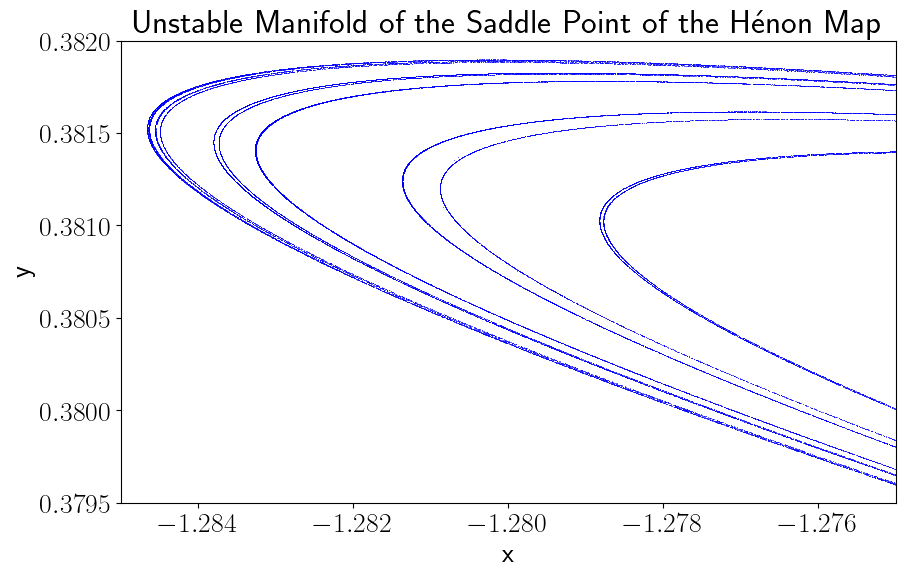

In [26]:
a = 1.4
b = 0.3
num_points = 1000
manifold_points = []
x_vals, y_vals = [], []

for (x_fixed, y_fixed) in fixed_points_henon(a, b):
    J = jacobian_henon((x_fixed, y_fixed), (a, b))
    eigenvalues, eigenvectors = np.linalg.eig(J)    
    unstable_vector = eigenvectors[:, np.argmax(eigenvalues)]
    
    for t in np.linspace(-1e-5, 1e-5, num_points):
        x_unstable = x_fixed + t * unstable_vector[0]
        y_unstable = y_fixed + t * unstable_vector[1]
        manifold_points.append((x_unstable, y_unstable))
                               
for (x, y) in manifold_points:
    for i in range(5000):
        x, y = henon_map((x, y), (a, b))
        x_vals.append(x)
        y_vals.append(y)
        
plt.figure(figsize=(10, 6))
plt.plot(x_vals, y_vals, ',', color='blue', alpha=0.6)
plt.title("Unstable Manifold of the Saddle Point of the Hénon Map")
plt.xlabel("x")
plt.ylabel("y")
plt.xlim([-1.285,-1.275])
plt.ylim([0.3795,0.3820])
plt.show()

#### <span style="color:red">Q. Some orbits of the Hénon map escape to infinity. Find one that you can prove diverges. </span>     
To find an orbit of the Hénon map that diverges to infinity, let's analyze the behavior of the Hénon map given by the equations:                                                                                                                       
$\quad T:\begin{cases} x_{n+1} = 1 + y_n - a x_n^2, \\ y_{n+1} = b x_n.\end{cases}$                                                         
We are looking for an initial condition $(x_0, y_0)$ that leads to divergence, meaning the iterates $(x_n, y_n)$ tend to infinity as $n \to \infty$.                                                                                                                                                                                                                                
Let us consider the initial point $(x_0, y_0)$ such that $x_0$ is very large and positive.                                                         
- **Initial Condition**:                                                                                                     
  $\quad x_0 = M$, where $M$ is a very large positive number.                                                                                                                        
- **Iteration Analysis**:                                                                                                          
  $\quad  x_1 = 1 + y_0 - a x_0^2.$                                                                                                          
  For $x_0$ large, the term $-a x_0^2$ will dominate:                                                                                  
  $\quad  x_1 \approx -a x_0^2.$                                                                                                    
  Since $a > 0, x_1$ will be a large negative number.                                                                                 
  $\quad  y_1 = b x_0 = b M.$                                                                                                              
- **Next Iteration**:                                                                                                                         
  $\quad  x_2 = 1 + y_1 - a x_1^2.$                                                                                                         
  Substituting $x_1 \approx -a x_0^2$ and $y_1 = b x_0$:                                                                              
  $\quad  x_2 \approx 1 + b M - a (-a M^2)^2 = 1 + b M - a (a^2 M^4).$                                                            
  For $M$ large, $a (a^2 M^4)$ is extremely large and dominates:                                                                  
  $\quad  x_2 \approx -a^3 M^4.$                                                                                                       
  So $x_2$ will be a very large negative number.                                                                                       
  $\quad  y_2 = b x_1 = b (-a x_0^2) = -a b x_0^2.$                                                                                       
  Here, $y_2$ will be a large negative number.

### Conclusion                                                                                                                                                                                                                                                                                                                                                                  
The pattern shows that $x_n$ and $y_n$ increase in magnitude rapidly.                                                        
The quadratic term $-a x^2$ ensures that if $x_0$ is sufficiently large,                                                        
each subsequent iteration produces a much larger value in magnitude                                                          
(alternating in sign due to the quadratic nature).                                                                   
Therefore, the orbit $(x_n, y_n)$ diverges to infinity.                                                                         
Hence, starting with a sufficiently large initial $x_0$,                                                                         
the Hénon map iterates will diverge to infinity, proving the existence of divergent orbits.

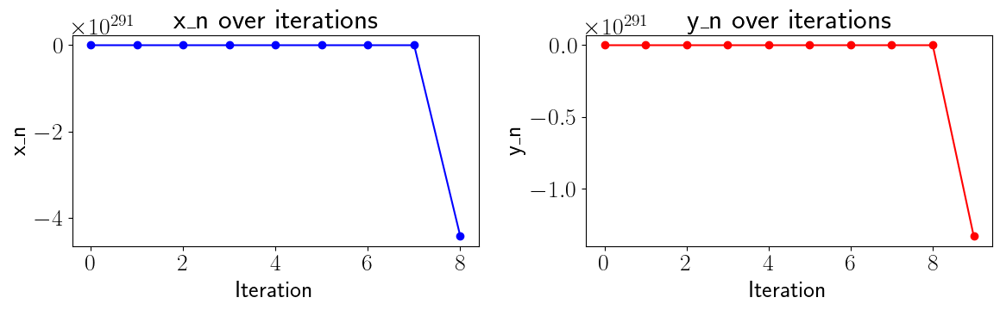

In [27]:
a = 1.4  # You can adjust this value
b = 0.3  # You can adjust this value
M = 10   # Large initial value for x_0

num_iterations = 50

x_values,y_values = np.zeros(num_iterations), np.zeros(num_iterations)
x_values[0] = M
y_values[0] = b * M

for n in range(1, num_iterations):
    x_values[n], y_values[n] = henon_map((x_values[n-1], y_values[n-1]), (a, b))

plt.figure(figsize=(12, 4))
plt.subplot(1, 2, 1)
plt.plot(range(num_iterations), x_values, marker='o', linestyle='-', color='b')
plt.title('x_n over iterations')
plt.xlabel('Iteration')
plt.ylabel('x_n')
plt.subplot(1, 2, 2)
plt.plot(range(num_iterations), y_values, marker='o', linestyle='-', color='r')
plt.title('y_n over iterations')
plt.xlabel('Iteration')
plt.ylabel('y_n')
plt.tight_layout()
plt.show()

### <span style="color:red">THE HÉNON MAP IN FINITE PRECISION             </span>                                                                                          
The Hénon map  is a two-parameter map of a plane defined by                                                                            
$\quad h(x, y) = (1 + y − ax^2, bx) \qquad\qquad(1)$                                                                                                             
The linear change of coordinates $(x, y) → (\bar{y}, b\bar{x})$ converts (1) to                                                                     
$\quad h(x, y) = (y, 1 + bx − ay^2) $                                                                  
Digital implementations of maps (1) and (2) are equivalent,                                                                   
provided that the order of elementary arithmetic operations is the same. 

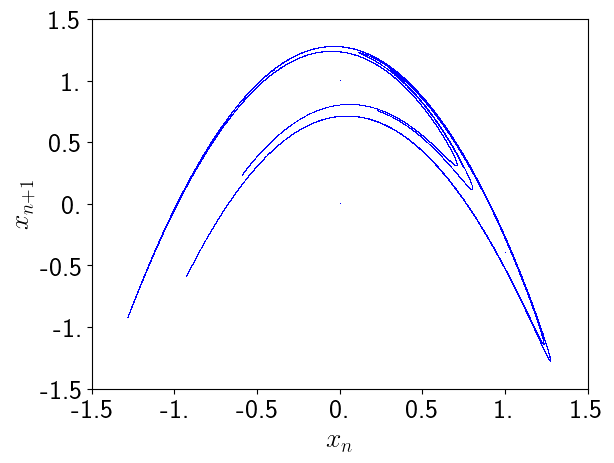

In [28]:
def henonF_map(X, const):
    a, b = const 
    x, y = X
    x_n = y
    y_n = 1 + b * x - a * y * y
    return np.array([x_n, y_n])

a  = 1.4
b  = 0.3
x0 = 0
y0 = 0
n  = 100000
x, y = iterate_f(henonF_map, (x0, y0),( a, b), n)

plt.plot(x, y, 'b,')
plt.xlabel('$x_n$')
plt.ylabel('$x_{n+1}$')
plt.xticks([-1.5,-1.,-0.5,0.,0.5,1.,1.5], ['-1.5','-1.','-0.5','0.','0.5','1.','1.5'])
plt.yticks([-1.5,-1.,-0.5,0.,0.5,1.,1.5], ['-1.5','-1.','-0.5','0.','0.5','1.','1.5'])
plt.show()

####  <span style="color:red">Q. Show that the Hénon map $T$ is invertible if $b \ne 0$, and find the inverse $T^{-1}$.     </span>                                                            
                                                                                                                                        
Solution:                                                  
We solve                                                  

$ \qquad\begin{equation*} T = \left\{\begin{array}{rl}x_{n+1} &= 1+y_n-ax_n^2,\\ \ y_{n+1} &= bx_n \end{array} \right.\end{equation*} \qquad\qquad\qquad\qquad\quad (1)$                                                                          
where $a$ and $b$ are adjustable parameters, for $x_n$ and $y_n$, given $x_{n+1}$ and $y_{n+1}$.                                                                            
From                                                  
$\qquad y_{n+1} = bx_n => x_n = \frac{1}{b} y_{n+1}$                                                 
Now then                                                  
$\qquad x_{n+1} = 1+y_n-ax_n^2 = 1+y_n-\frac{a}{b^2} y_{n+1}^2 => y_n = x_{n+1}+\frac{a}{b^2} y_{n+1}^2-1$                                                 

Algebra yields                                                 
 $ \qquad\begin{equation*} T^{-1} = \left\{\begin{array}{rl} x_n &= \frac{1}{b} y_{n+1}, \\
 \ y_n &= x_{n+1} - 1 + a(\frac{y_{n+1}}{b})^2  \end{array} \right.\end{equation*} \qquad\qquad\qquad\qquad(2)$                                               
Thus $T^{-1}$ exists for all $b\ne0.$

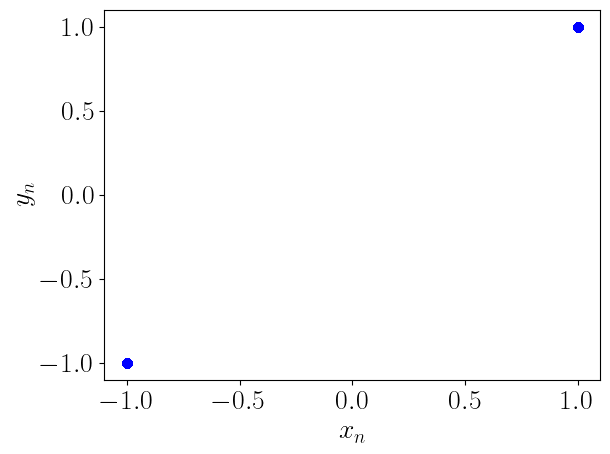

In [29]:
def inverse_henonF_map(X, const):
    a, b = const 
    x, y = X
    x_n = y/b
    y_n = x + a*y*y/(b*b) - 1
    return np.array([x_n, y_n])

a = 1
b = 1
n = 1000

for x in [-1,1]:
    x, y = iterate_f(inverse_henonF_map, (x, x),( a, b), n)
    plt.plot(x,y, 'bo-')
    
plt.xlabel('$x_n$')
plt.ylabel('$y_n$')
plt.show()

### Basin of attraction for Hénon Map

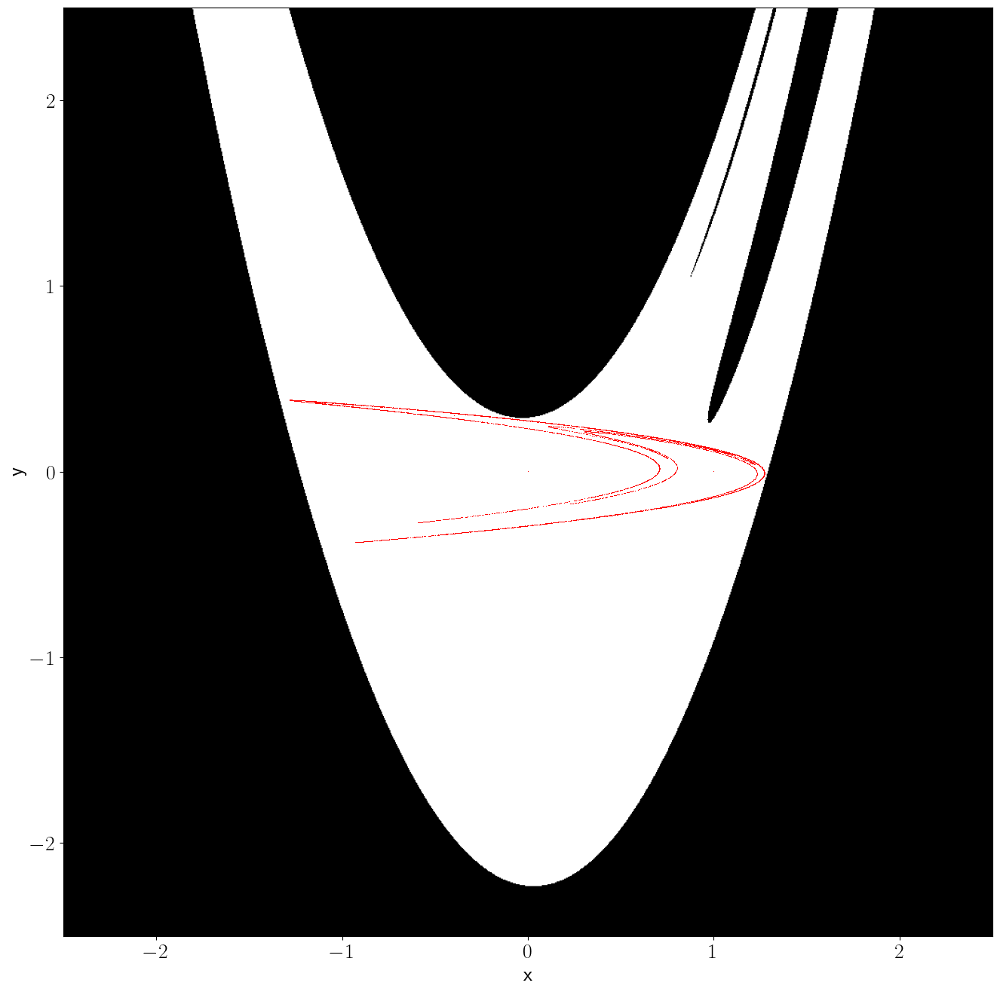

In [30]:
a, b       = 1.4, 0.3
grid_size  = 1000  # Number of points in each dimension
iterations = 100
threshold  = 10   # Threshold for escape
x_vals = np.linspace(-2.5, 2.5, grid_size)
y_vals = np.linspace(-2.5, 2.5, grid_size)
X, Y   = np.meshgrid(x_vals, y_vals)
basin  = np.zeros_like(X, dtype=int)

for i in range(grid_size):
    for j in range(grid_size):
        x, y = X[i, j], Y[i, j]
        for _ in range(iterations):
            x, y = henon_map((x, y), (a, b))
            if abs(x) > threshold or abs(y) > threshold:
                basin[i, j] = 1  # Mark as escaped
                break

                
x, y = iterate_f(henon_map, (0,0),( a, b), num_steps=10000)

plt.figure(figsize=(16, 16))
plt.imshow(basin, extent=(-2.5, 2.5, -2.5, 2.5), origin='lower', cmap='binary')
plt.plot(x,y,'r,')
plt.xlabel("x")
plt.ylabel("y")
plt.show()

#### <span style="color:red">Q. Suppose we change the sign of $b$. Is there any difference in the dynamics?</span>                         
                                                                                                                            
 We start with the system ,                                                                                                      
$ \qquad\begin{equation*} T(x,y): \left\{\begin{array}{rl}x_{n+1} &= 1+y_n-ax_n^2,\\ \ y_{n+1} &= bx_n \end{array} \right.\end{equation*} \qquad\qquad\qquad\qquad(1)$                                                                              
We can re-write (1) as                                                                                                            
$\qquad T=\begin{pmatrix} 1+y_n-ax_n^2 \\ bx_n \end{pmatrix} \qquad\qquad\qquad\qquad\qquad\quad\qquad(2)$                                                                         
Jacobian of the matrix $T$ can be written as                                                                                            
$\qquad\qquad J = \begin{pmatrix} \frac{\partial x_{n+1}}{\partial x_n} & \frac{\partial x_{n+1}}{\partial y_n} \\ \frac{\partial y_{n+1}}{\partial x_n} & \frac{\partial y_{n+1}}{\partial y_n} \end{pmatrix}=\begin{pmatrix} -2ax & 1 \\ b & 0 \end{pmatrix} \qquad\qquad\quad \ \ (3)$                                                                                      

$\qquad\qquad\det(J) = \begin{vmatrix} -2ax & 1 \\ b & 0 \end{vmatrix} = (-2ax)(0)-(1)(b)=-b \qquad (4)$                            
$\qquad\qquad \mod\det(J) = |-b|=|b| \qquad \qquad \qquad \qquad \quad  (5) $                            

Let set $ b=-b$                                                                                                                   
 We re-write the system (1) as ,                                                                                                      
$ \qquad\begin{equation*} T(x,y): \left\{\begin{array}{rl}x_{n+1} &= 1+y_n-ax_n^2,\\ \ y_{n+1} &= -bx_n \end{array} \right.\end{equation*} \qquad\qquad\qquad\qquad(6)$                                                                               
We can re-write (6) as                                                                                                            
$\qquad T=\begin{pmatrix} 1+y_n-ax_n^2 \\ -bx_n \end{pmatrix} \qquad\qquad\qquad\qquad\qquad\quad\qquad(7)$                                                                         
Jacobian of the matrix $T$ can be written as                                                                                            
$\qquad\qquad J = \begin{pmatrix} \frac{\partial x_{n+1}}{\partial x_n} & \frac{\partial x_{n+1}}{\partial y_n} \\ \frac{\partial y_{n+1}}{\partial x_n} & \frac{\partial y_{n+1}}{\partial y_n} \end{pmatrix}=\begin{pmatrix} -2ax & 1 \\ -b & 0 \end{pmatrix} \qquad\qquad\quad \ \ (8)$                                                                                      

$\qquad\qquad\det(J) = \begin{vmatrix} -2ax & 1 \\ -b & 0 \end{vmatrix} = (-2ax)(0)-(1)(-b)=b \qquad (9)$                          
$\qquad\quad \ \mod\det(J) = |b| \qquad\qquad\qquad\qquad\qquad\qquad \ \ (10)$                            
In both cases (whether $b$ is positive or negative), the absolute value of the determinant of the Jacobian matrix remains 
$∣b∣$.                                                                                                                    
This is because the determinant depends only on the magnitude of $b$ and not on its sign.

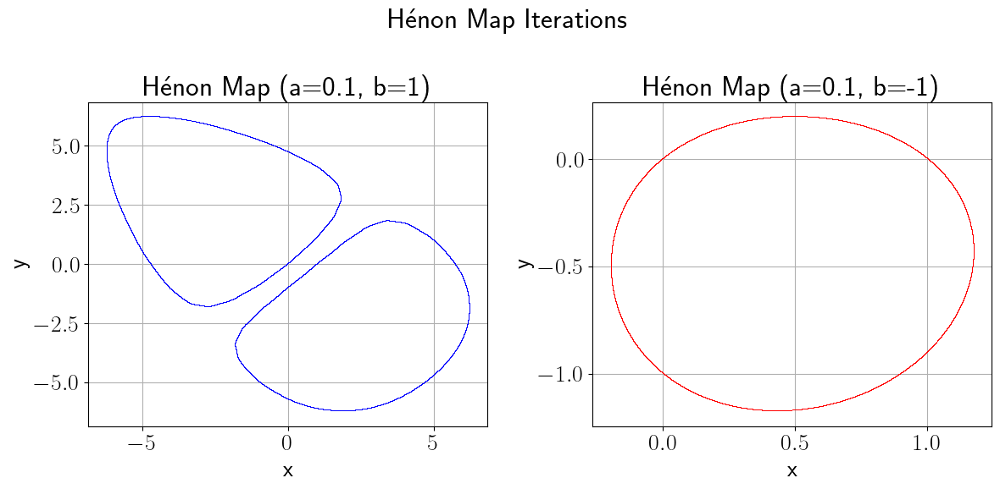

In [31]:
a_v = [0.1]
b_v = [1]

for a in a_v:
    for b in b_v:
        b_positive = b
        b_negative = -b
        num_iterations = 500000
        x0, y0 = 0., 0.

        # Iterate for positive b
        x_pos, y_pos = iterate_f(henon_map, (x0, y0), (a, b_positive), num_iterations)

        # Iterate for negative b
        x_neg, y_neg = iterate_f(henon_map, (x0, y0), (a, b_negative), num_iterations)

        # Plot the results
        fig, axes = plt.subplots(1, 2, figsize=(12,6))
        fig.suptitle('Hénon Map Iterations')

        # Plot for positive b
        axes[0].plot(x_pos, y_pos, 'b,', markersize=0.1, alpha=0.5)
        axes[0].set_title(f'Hénon Map (a={a}, b={b_positive})')
        axes[0].set_xlabel('x')
        axes[0].set_ylabel('y')
        axes[0].grid(True)

        # Plot for negative b
        axes[1].plot(x_neg, y_neg, 'r,', markersize=0.1, alpha=0.5)
        axes[1].set_title(f'Hénon Map (a={a}, b={b_negative})')
        axes[1].set_xlabel('x')
        axes[1].set_ylabel('y')
        axes[1].grid(True)
        plt.tight_layout()
        plt.show()

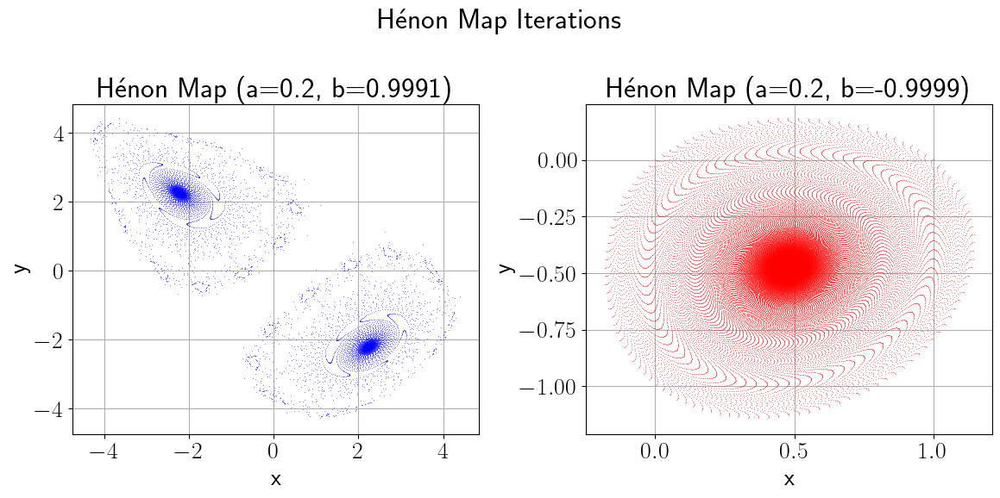

In [36]:
# Parameters
a = 0.2
b_positive =  0.9991
b_negative = -0.9999
num_iterations = 500000
x0, y0 = 0., 0.

# Iterate for positive b
x_pos, y_pos = iterate_f(henon_map, (x0, y0), (a, b_positive), num_iterations)

# Iterate for negative b
x_neg, y_neg = iterate_f(henon_map, (x0, y0), (a, b_negative), num_iterations)

# Plot the results
fig, axes = plt.subplots(1, 2, figsize=(12,6))
fig.suptitle('Hénon Map Iterations')

# Plot for positive b
axes[0].plot(x_pos, y_pos, 'b,', markersize=0.1, alpha=0.5)
axes[0].set_title(f'Hénon Map (a={a}, b={b_positive})')
axes[0].set_xlabel('x')
axes[0].set_ylabel('y')
axes[0].grid(True)

# Plot for negative b
axes[1].plot(x_neg, y_neg, 'r,', markersize=0.1, alpha=0.5)
axes[1].set_title(f'Hénon Map (a={a}, b={b_negative})')
axes[1].set_xlabel('x')
axes[1].set_ylabel('y')
axes[1].grid(True)
plt.tight_layout()
plt.show()

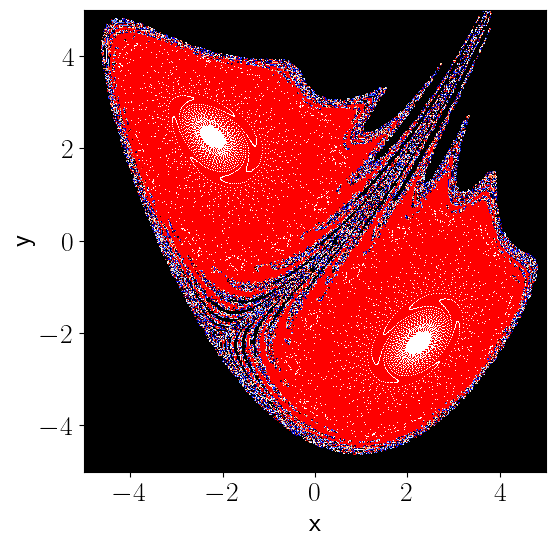

In [37]:
a, b       = 0.2, 0.9991
grid_size  = 500  # Number of points in each dimension
iterations = 100
threshold  = 10   # Threshold for escape
x_vals = np.linspace(-5, 5, grid_size)
y_vals = np.linspace(-5, 5, grid_size)
X, Y   = np.meshgrid(x_vals, y_vals)
basin  = np.zeros_like(X, dtype=int)

for i in range(grid_size):
    for j in range(grid_size):
        x, y = X[i, j], Y[i, j]
        for _ in range(iterations):
            x, y = henon_map((x, y), (a, b))
            if abs(x) > threshold or abs(y) > threshold:
                basin[i, j] = 1  # Mark as escaped
                break

                
x, y = iterate_f(henon_map, (0,0),( a, b), num_steps=50000000)

plt.figure(figsize=(6, 6))
plt.imshow(basin, extent=(-5, 5, -5, 5), origin='lower', cmap='flag')
plt.plot(x,y,'w,')
#plt.colorbar(label='Basin (0 = Attractor, 1 = Escape)')
#plt.title("Basin of Attraction of the Hénon Map")
plt.xlabel("x")
plt.ylabel("y")
plt.show()

#### <span style="color:red">Q. For certain parameter values, the Hénon map has a trapping region.            </span>                                                                            
 <span style="color:red">(Invariant set for the Hénon map)  </span>                                                                                         
 <span style="color:red">Consider the Hénon map $T$ with the standard parameter values $a=1.4, b=0.3.$   </span>                                              
<span style="color:red">Let $Q$ denote the quadrilateral with vertices $ (-1.33, 0.42), (1.32, 0.133), (1.245, -0.14), (-1.06, -0.5).$   </span>                                                                                                        
<span style="color:red">a. Plot $Q$ and its image $T ( Q ).$  </span>                                                                                         
<span style="color:red">$\quad$(Hint: Represent the edges of $Q$ using the parametric equations for a line segment. </span>                                             
<span style="color:red">$\quad$These segments are mapped to arcs of parabolas.) </span>                                                                                       
<span style="color:red">b. Prove $T ( Q )$ is contained in $Q .$ </span>                                                                                                 
                                                                                                                                         
 #### Parametric Equations for the Edges of $ Q $

Given the vertices of the quadrilateral $Q $:

1. $ A = (-1.33, 0.42) $
2. $ B = (1.32, 0.133) $
3. $ C = (1.245, -0.14)$
4. $ D = (-1.06, -0.5) $

#### Parametric Equations for the Edges

1. **Edge $ \overline{AB} $:**
   $
   L_0(t) = A + t(B - A) = (-1.33 + 2.65t, 0.42 - 0.287t) \quad \text{for } t \in [0, 1]
   $

2. **Edge $ \overline{BC} $:**
   $
   L_1(t) = B + t(C - B) = (1.32 - 0.075t, 0.133 - 0.273t) \quad \text{for } t \in [0, 1]
   $

3. **Edge $ \overline{CD}$:**
   $
   L_2(t) = C + t(D - C) = (1.245 - 2.305t, -0.14 - 0.36t) \quad \text{for } t \in [0, 1]
   $

4. **Edge $ \overline{DA} $:**
   $
   L_3(t) = D + t(A - D) = (-1.06 - 0.27t, -0.5 + 0.92t) \quad \text{for } t \in [0, 1]
   $

   $ L_i(t, Q_i) = Q_i + t(Q_{i+1}-Q_i) \quad \text{for } t \in [0, 1]$
   
   if $Q_{i+1}=Q_{n-1}$ , it has to operte $Q_i=Q_0$
   
    then $ L_i(t, Q_i) = Q_i + t(Q_{[{(i+1)} \% \ n]}-Q_i) \quad \text{for } t \in [0, 1]$
    
   $Q_{[{(i+1)} \% \ n]}$: Ending vertex of the edge. This wraps around to $Q_0$ after reaching $Q_{n-1}$ to close the polygon.                                                                                                                                  
#### Parametric Equations for the Image of Each Edge under the Hénon Map

The Hénon map is defined as:
$
T(x, y) = (1 - ax^2 + y, bx)
$

With the given parameters $ a = 1.4 $ and $ b = 0.3 $.

To find the image of each parametric line segment under the Hénon map, we substitute the parametric equations into the Hénon map:

1. **Image of $L1(t) $:**
   $
   H1(t) = T(L1(t)) = \left( 0.42 - 0.287t + 1 - 1.4(-1.33 + 2.65t)^2, 0.3(-1.33 + 2.65t) \right)
   $

2. **Image of $ L2(t) $:**
   $
   H2(t) = T(L2(t)) = \left( 0.133 - 0.273t + 1 - 1.4(1.32 - 0.075t)^2, 0.3(1.32 - 0.075t) \right)
   $

3. **Image of $ L3(t) $:**
   $
   H3(t) = T(L3(t)) = \left( -0.14 - 0.36t + 1 - 1.4(1.245 - 2.305t)^2, 0.3(1.245 - 2.305t) \right)
   $

4. **Image of $ L4(t) $:**
  $
   H4(t) = T(L4(t)) = \left( -0.5 + 0.92t + 1 - 1.4(-1.06 - 0.27t)^2, 0.3(-1.06 - 0.27t) \right)
   $
   
   $H_j(f,t)=f[L_j(t, Q_j)]$

In [38]:
def L_function(t, Q):
    edge_points_list = []
    t = t.reshape(-1, 1)
    for i in range(len(Q)):
        edge_points = Q[i] + t * (Q[(i+1) % len(Q)] - Q[i])
        edge_points_list.append(edge_points)
    return np.array(edge_points_list)

def HL(f,L):
    edge_points_list = []
    for edge_points in L:
        x, y = edge_points[:, 0], edge_points[:, 1]
        mapped_points = np.vstack(f((x, y), (a, b))).T
        edge_points_list.append(mapped_points)
    return np.array(edge_points_list)

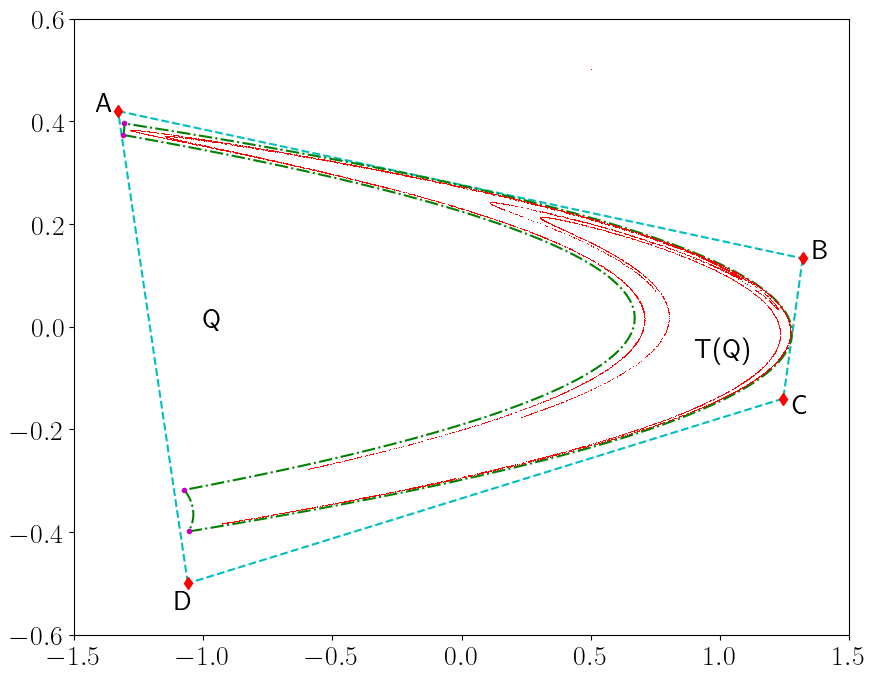

In [39]:
Q = np.array([[-1.33, 0.42], [1.32, 0.133], [1.245, -0.14], [-1.06, -0.5]])
a = 1.4
b = 0.3
t = np.linspace(0, 1, 1000)
L = L_function(t,Q)
H = HL(henon_map,L)

plt.figure(figsize=(10,8))
vertex_names = ['A', 'B', 'C', 'D']

for edge_points in L:
    plt.plot(edge_points[:, 0], edge_points[:, 1], 'c--')

for edge_points in H:
    plt.plot(edge_points[:, 0], edge_points[:, 1], 'g-.')

for edge_points in Q:
    plt.plot(edge_points[ 0], edge_points[ 1], 'rd')
    s, t = henon_map(edge_points, (a, b))
    plt.plot(s, t, 'm.')
    

num_steps = 10000

x, y = 0.5,0.5
x_v, y_v = iterate_f(henon_map, (x, y),( a, b), num_steps)
plt.plot(x_v,y_v,'r,')
plt.text(-1.42, 0.42, 'A')
plt.text( 1.36, 0.133, 'B')
plt.text(1.28, -0.17, 'C')
plt.text(-1.,0.0,'Q')
plt.text(0.9,-0.06, 'T(Q)')
plt.text(-1.11, -0.55, 'D')
#plt.title('Quadrilateral Q and its image T(Q) under the Hénon Map')
#plt.xlabel('x')
#plt.ylabel('y')
#plt.legend()
#plt.grid(True)
plt.ylim([-0.6, 0.6])
plt.xlim([-1.5, 1.5])
plt.show()

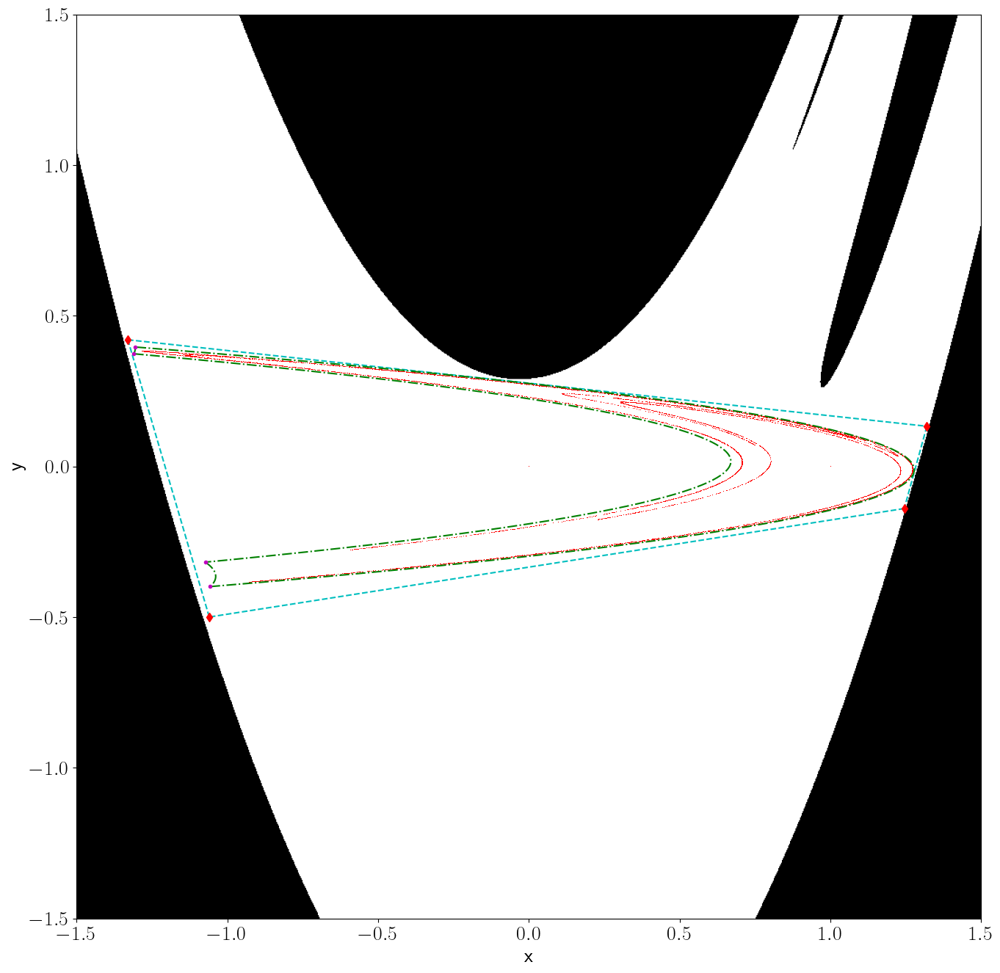

In [40]:
a, b       = 1.4, 0.3
grid_size  = 1000  # Number of points in each dimension
iterations = 100
threshold  = 10   # Threshold for escape
x_vals = np.linspace(-1.5, 1.5, grid_size)
y_vals = np.linspace(-1.5, 1.5, grid_size)
X, Y   = np.meshgrid(x_vals, y_vals)
basin  = np.zeros_like(X, dtype=int)

for i in range(grid_size):
    for j in range(grid_size):
        x, y = X[i, j], Y[i, j]
        for _ in range(iterations):
            x, y = henon_map((x, y), (a, b))
            if abs(x) > threshold or abs(y) > threshold:
                basin[i, j] = 1  # Mark as escaped
                break

                
x, y = iterate_f(henon_map, (0,0),( a, b), num_steps=10000)

plt.figure(figsize=(16, 16))
plt.imshow(basin, extent=(-1.5, 1.5, -1.5, 1.5), origin='lower', cmap='binary')
plt.plot(x,y,'r,')

for edge_points in L:
    plt.plot(edge_points[:, 0], edge_points[:, 1], 'c--')

for edge_points in H:
    plt.plot(edge_points[:, 0], edge_points[:, 1], 'g-.')
    
for edge_points in Q:
    plt.plot(edge_points[ 0], edge_points[ 1], 'rd')
    s, t = henon_map(edge_points, (a, b))
    plt.plot(s, t, 'm.')
    
plt.xlabel("x")
plt.ylabel("y")
plt.show()

In [41]:
b=0.3
a0=-(1-b)**2/4
a1=3*(1-b)**2/4
a2=(5*b**2 - 6*b + 5)/4
a0,a1,a2

(-0.12249999999999998, 0.36749999999999994, 0.9125000000000001)

In [42]:
b0=-((-a*4)**0.5+1)
b0

(-1.0000000000000002-2.3664319132398464j)

In [43]:
a=1.4
b0=-0.37
b1=-0.095
b0,b1

(-0.37, -0.095)

### Bifurcation & Lyapunov exponent for Hénon Map

In [44]:
def bifurcation(f,X0, const , transient_steps, num_steps):
    x_temp = X0
    # Iterate to remove transient effects
    for _ in range(transient_steps):
        x_temp = f(x_temp, const)
    # Iterate to capture the stable points
    x_stable = []
    y_stable = []
    for _ in range(num_steps):
        x_temp = f(x_temp, const)
        x_stable.append(x_temp[0])
        y_stable.append(x_temp[1])
    return np.array([x_stable, y_stable])

In [45]:
def lyapunov_f(f,Jf,X0, const, iterations, transient):
    x_temp = X0
    lyapunov_sum_x = 0
    lyapunov_sum_y = 0

    for _ in range(transient):
        x_temp = f(x_temp, const)

    v_x = np.array([1, 0])
    v_y = np.array([0, 1])

    for _ in range(iterations):
        x_temp = f(x_temp, const)
        if x_temp[0] == 0:
            x_temp[0] = 1e-10

        J = Jf(x_temp, const)
        v_x = J @ v_x
        v_y = J @ v_y
        v_x_norm = np.linalg.norm(v_x)
        v_y_norm = np.linalg.norm(v_y)
        v_x = v_x / v_x_norm
        v_y = v_y / v_y_norm
        lyapunov_sum_x += np.log(v_x_norm)
        lyapunov_sum_y += np.log(v_y_norm)
        
    return lyapunov_sum_x / iterations, lyapunov_sum_y / iterations

In [46]:
transient_steps = 100
iterations = 1000
num_steps = 100
a_values = np.linspace(-0.2, 1.8, 4600)
b_values = np.linspace(-1, 1, 4600)
A ,B = 1.4, 0.3
xa_vals, xb_vals = [], []
ya_vals, yb_vals = [], []
Lxa_vals, Lxb_vals = [], []
Lya_vals, Lyb_vals = [], []

for a in a_values:
    x, y = 0, 0
    x_stable,y_stable = bifurcation(henon_map, (x, y), (a, B), transient_steps, num_steps)
    xa_vals.append(x_stable)
    ya_vals.append(y_stable)
    lxa, lya = lyapunov_f(henon_map,jacobian_henon, (x, y), (a, B), iterations, transient_steps)
    Lxa_vals.append(lxa)
    Lya_vals.append(lya)
    
for b in b_values:
    x, y = 0, 0
    x_stable,y_stable = bifurcation(henon_map, (x, y), (A, b), transient_steps, num_steps)
    xb_vals.append(x_stable)
    yb_vals.append(y_stable)
    lxb, lyb = lyapunov_f(henon_map,jacobian_henon, (x, y), (A, b), iterations, transient_steps)
    Lxb_vals.append(lxb)
    Lyb_vals.append(lyb)
    
xa_vals  = np.array(xa_vals)
xb_vals  = np.array(xb_vals)
ya_vals  = np.array(ya_vals)
yb_vals  = np.array(yb_vals)
Lxa_vals = np.array(Lxa_vals)
Lxb_vals = np.array(Lxb_vals)
Lya_vals = np.array(Lya_vals)
Lyb_vals = np.array(Lyb_vals)

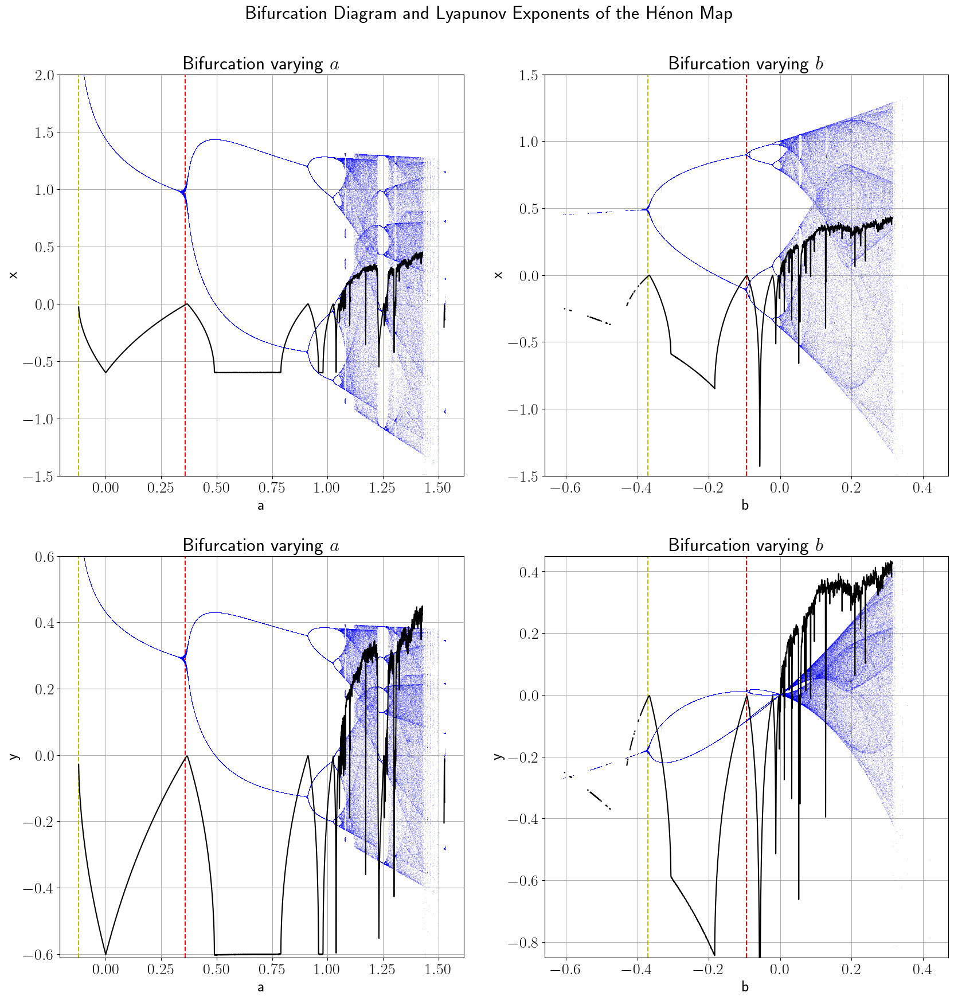

In [47]:
fig = plt.figure(figsize=(20, 20))
gs  = fig.add_gridspec(2, 2)
ax1 = fig.add_subplot(gs[0, 0])
ax2 = fig.add_subplot(gs[0, 1])
ax3 = fig.add_subplot(gs[1, 0])
ax4 = fig.add_subplot(gs[1, 1])

fig.suptitle('Bifurcation Diagram and Lyapunov Exponents of the Hénon Map', y=0.94)

ax1.axvline(a0, color='y',linestyle ="--")
ax1.axvline(a1-0.01, color='r',linestyle ="--")
ax1.plot(a_values, xa_vals, 'b,', alpha=0.2)
ax1.plot(a_values, Lxa_vals, 'k-')
#ax1.plot(a_values[Lxa_vals<0], Lxa_vals[Lxa_vals<0], 'k,')
#ax1.plot(a_values[Lxa_vals>=0], Lxa_vals[Lxa_vals>=0], 'r,')
ax1.set_title(r'Bifurcation varying $a$')
ax1.set_ylim(-1.5, 2)
#ax1.set_xlim(-0.1, 1.4)
ax1.set_xlabel('a')
ax1.set_ylabel('x')
ax1.grid(True)

ax2.axvline(b0, color='y',linestyle ="--")
ax2.axvline(b1, color='r',linestyle ="--")
ax2.plot(b_values, xb_vals, 'b,', alpha=0.2)
ax2.plot(b_values, Lxb_vals, 'k-')
#ax2.plot(b_values[Lxb_vals<0], Lxb_vals[Lxb_vals<0], 'k,')
#ax2.plot(b_values[Lxb_vals>=0], Lxb_vals[Lxb_vals>=0], 'r,')
ax2.set_title(r'Bifurcation varying $b$')
ax2.set_ylim(-1.50, 1.50)
#ax2.set_xlim(-0.41, 0.31)
ax2.set_xlabel('b')
ax2.set_ylabel('x')
ax2.grid(True)

ax3.axvline(a0, color='y',linestyle ="--")
ax3.axvline(a1-0.01, color='r',linestyle ="--")
ax3.plot(a_values, ya_vals, 'b,', alpha=0.2)
ax3.plot(a_values, Lya_vals, 'k-')
#ax3.plot(a_values[Lya_vals<0], Lya_vals[Lya_vals<0], 'k,')
#ax3.plot(a_values[Lya_vals>=0], Lya_vals[Lya_vals>=0], 'r,')
ax3.set_title(r'Bifurcation varying $a$')
ax3.set_ylim(-0.61, 0.6)
#ax3.set_xlim(-0.1, 1.4)
ax3.set_xlabel('a')
ax3.set_ylabel('y')
ax3.grid(True)

ax4.axvline(b0, color='y',linestyle ="--")
ax4.axvline(b1, color='r',linestyle ="--")
ax4.plot(b_values, yb_vals, 'b,', alpha=0.2)
ax4.plot(b_values, Lyb_vals, 'k-')
#ax4.plot(b_values[Lyb_vals<0], Lyb_vals[Lyb_vals<0], 'k,')
#ax4.plot(b_values[Lyb_vals>=0], Lyb_vals[Lyb_vals>=0], 'r,')
ax4.set_title(r'Bifurcation varying $b$')
ax4.set_ylim(-0.85, 0.45)
#ax4.set_xlim(-0.41, 0.31)
ax4.set_xlabel('b')
ax4.set_ylabel('y')
ax4.grid(True)
plt.show()

#### <span style="color:red">Q. Show that for a certain choice of parameters, the Hénon map reduces to an effectively one-dimensional map.</span>                                                                                                                                                                                                                             

The Hénon map is given by:

$\qquad\begin{equation*}T(x, y): \left\{\begin{array}{rl}x_{n+1} &= 1 + y_n - a x_n^2, \\ y_{n+1} &= b x_n \end{array} \right. \end{equation*} $

We need to show that one of the variables (either $x$ or $y$) can be eliminated or treated as a constant.            
This can happen if the map effectively does not change the value of one variable,i.e. the dynamics in that variable are trivial.

If $ b = 0 $, then:

$\qquad\begin{equation*}\begin{cases}x_{n+1} = 1 + y_n - a x_n^2, \\ y_{n+1} = 0 \end{cases} \end{equation*} $

Here,$y_{n+1} = 0$ implies that $y$ is constant for all iterations, and does not affect the dynamics of $x$                  
Thus, the map reduces to:

$ \qquad x_{n+1} = 1 - a x_n^2 \quad (\text{with } y \text{ constant})$

This is a one-dimensional map for \( x \) with \( y \) effectively fixed.


Thus, the Hénon map can effectively be reduced to one dimension depending on the values of the parameters.

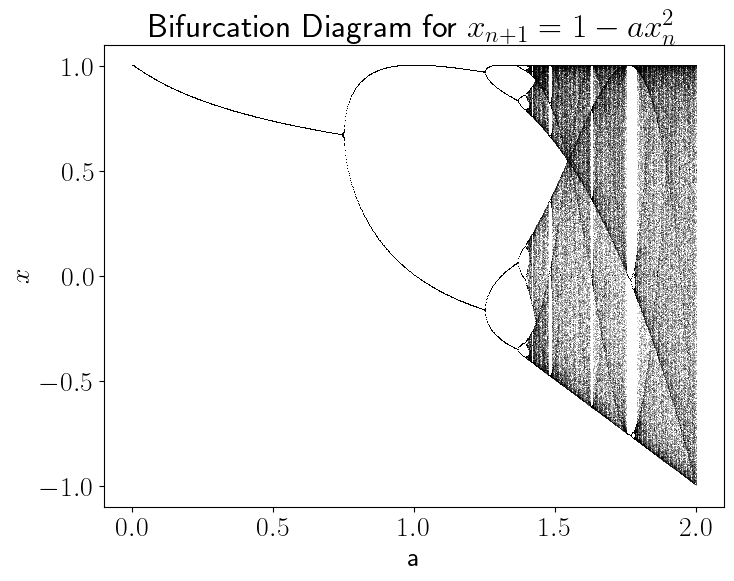

In [48]:
def henon_map1D(x, a):
    return 1 - a * x**2

a_values = np.linspace(0, 2, 1000)
x_initial = 0.5  # Initial condition for x
iterations = 1000
transient = 500  # Skip transient iterations

plt.figure(figsize=(8, 6))
for a in a_values:            # Iterate over values of a
    x = x_initial
    for i in range(iterations):    # Iterate the map and discard transient
        x = henon_map1D(x, a)
        if i >= transient:
            plt.plot(a, x, ',k', alpha=0.25)  # Plot points for settled values

plt.title("Bifurcation Diagram for $x_{n+1} = 1 - a x_n^2$")
plt.xlabel("a")
plt.ylabel("$x$")
plt.show()

#### (2-cycle)                                                                                                                                                                                                              
<span style="color:red">Consider the Hénon map with $−1 < b< 1$. Show that the map has a 2-cycle for $a > a_1 = \frac{3}{4}(1−b)^2$. For which values of $a$ is the 2-cycle stable? </span>                                                                                                   
           

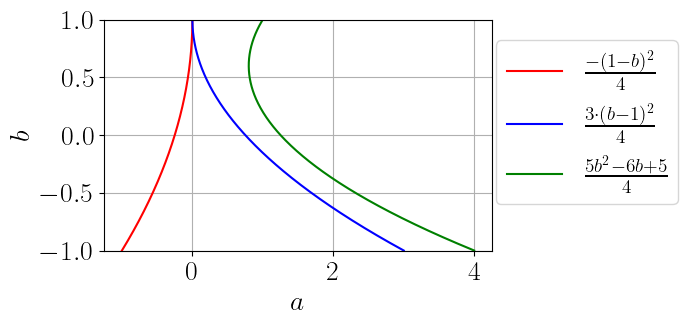

In [49]:
b_values = np.linspace(-1, 1, 400)
a_0 = [-(1-b)**2/4 for b in b_values]
a_1 = [(b - 1)**2 * 3/4 for b in b_values]
a_2 = [(5*b**2 - 6*b + 5)/4 for b in b_values]

plt.figure(figsize=(5,3))
plt.plot(a_0,b_values,  'r-', label=r'$\frac{-(1-b)^2}{4}$')
plt.plot(a_1,b_values,  'b-', label=r'$\frac{3\cdot(b - 1)^2 }{4}$')
plt.plot(a_2,b_values,  'g-', label=r'$\frac{5b^2 - 6b + 5}{4}$')
'''plt.fill_between(b_values, a_lower, a_upper, color='gray', alpha=0.3, 
                 label=r'$\left(\frac{5b^2 - 6b + 5}{4}\right) > a > \left(\frac{3\cdot(b - 1)^2}{4}\right)$')
'''
plt.xlabel('$a$')
plt.ylabel('$b$')

plt.legend(loc=(1.01,0.2),fontsize=20)
plt.ylim([b_values.min(), b_values.max()])
plt.grid(True)
plt.show()

### Correction Dimension

In [50]:
def correlation_sum(data, r):
    distances = sc.spatial.distance.pdist(data, 'euclidean')  # Pairwise distances
    return np.sum(distances < r) / (len(data) * (len(data) - 1))

In [51]:
def fit(x,y):
    n = len(x)
    sx = sum(x)
    sy = sum(y)
    sx2 = sum(x*x)
    sxy = sum(x*y)
    b = (n*sx2 - sx**2)
    m = (n*sxy - sx*sy) / b
    c = (sy*sx2 - sx*sxy) / b
    return m,c

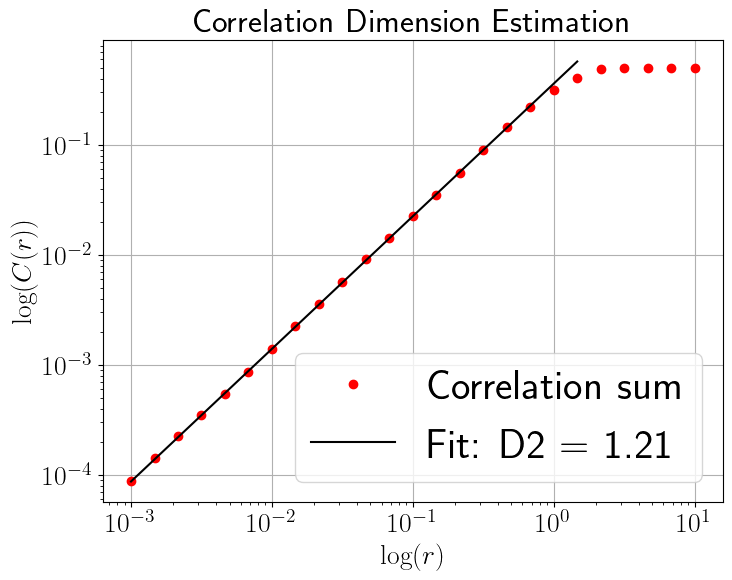

In [52]:
a, b = 1.4, 0.3
const = (a, b)
iterations = 15000
transients = 1000
X0 = np.array([0.5, 0.5])

# Generate orbit
orbit = [X0]
for _ in range(iterations):
    orbit.append(henon_map(orbit[-1], const))
orbit = np.array(orbit[transients:])  # Remove transients

# Compute correlation sums
r_values = np.logspace(-3, 1, 25)
C_r = [correlation_sum(orbit, r) for r in r_values] 
m,c = fit(np.log(r_values[3:16]), np.log(C_r[3:16]))
Y = np.exp(m * np.log(r_values) + c)

plt.figure(figsize=(8, 6))
plt.loglog(r_values, C_r, 'ro', label="Correlation sum")
plt.plot(r_values[:20], Y[:20], 'k-', label=f"Fit: D2 = {m:.2f}")
plt.xlabel(r"$\log(r)$")
plt.ylabel(r"$\log(C(r))$")
plt.title("Correlation Dimension Estimation")
plt.legend()
plt.grid(True)
plt.show()

# $$\textit{Lozi Map}$$
#### <span style="color:red">Show that the product mapping $T′′′ T′′ T′$ is equivalent to the formulas given by</span>                                               
$ \qquad\begin{equation*} T = \left\{\begin{array}{rl}x_{n+1} &= 1+y_n-a|x_n|,\\ \ y_{n+1} &= bx_n \end{array} \right.\end{equation*} \qquad\qquad\qquad\qquad\quad (1)$                                                                                         
where $a$ and $b$ are adjustable parameters. Plot the image of a rectangle under the Lozi map.                                                                                              
                                                                   
                                                                                                                                     
Start with a rectangular region elongated along the x-axis (Figure a).                                                  
Stretch and fold the rectangle by applying the transformation                                                                 
$ \qquad\begin{equation*} T′ = \left\{\begin{array}{rl}x′&=x,\\ y′ &=1+y-a|x| \end{array} \right.\end{equation*} \qquad\qquad\qquad\qquad\qquad (2)$                                                                                                       
(The primes denote iteration, not differentiation.)                                                                            
The bottom and top of the rectangle get mapped to parabolas (Figure b).                                                                
The parameter a controls the folding.                                                                                                 
Now fold the region even more by contracting Figure b along the x-axis:                                                         
$ \qquad\begin{equation*} T′′ = \left\{\begin{array}{rl}x′′&=bx′ &= bx,\\ 
y′′ &=y′ &= 1+y-a|x| \end{array} \right.\end{equation*} \qquad\qquad\qquad\qquad\qquad\qquad (3)$                                                                                                                 
where $-1<b<1$.  This produces Figure c.                                                                                                 
Finally, come back to the orientation along the x-axis by reflecting across the line $y=x$ (Figure d):                          
$ \qquad\begin{equation*} T′′′ = \left\{\begin{array}{rl}x′′′&=y′′&=1+y-a|x|,\\ y′′′ &=x′′ &= bx \end{array} \right.\end{equation*} \qquad\qquad\qquad\qquad\qquad\qquad (4)$                                                                                                   
Then the composite transformation $ \begin{equation*} T= T''' \circ T'' \circ T'  = \left\{\begin{array}{rl}x_{n+1} &= 1+y_n-a|x_n|,\\ \ y_{n+1} &= bx_n \end{array} \right.\end{equation*}$ yields the Lozi mapping(1),                                                   
where we use the notation $( x_n, y_n )$ for $( x, y )$ and $( x_{n+1}, y_{n+1} )$ for $(x′′′, y′′′).$ 
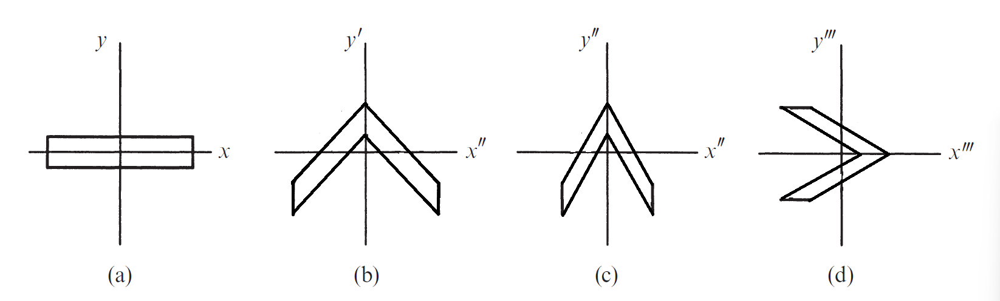

In [53]:
# Define the transformations
def dT(x, y, a):
    dx = x
    dy = 1 + y - a * abs(x)
    return dx, dy

def ddT(dx, dy, b):
    ddx = b * dx
    ddy = dy
    return ddx, ddy

def dddT(ddx, ddy):
    dddx = ddy
    dddy = ddx
    return dddx, dddy

def T(x, y, a, b): 
    return dddT(*ddT(*dT(x, y, a),b))

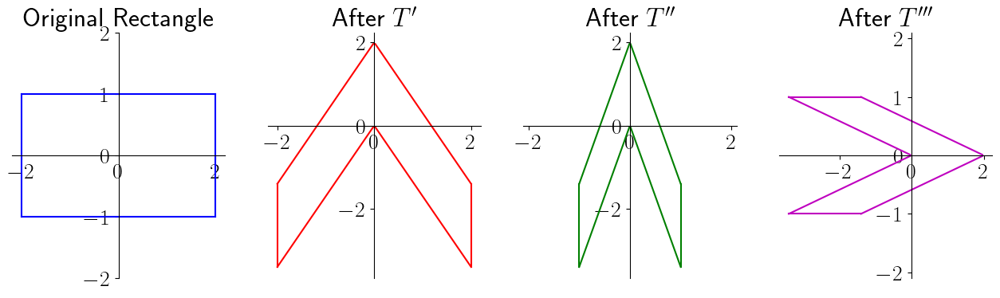

In [54]:
# Parameters
a = 1.7
b = 0.5

# Create a rectangular region elongated along the x-axis
x = np.linspace(-2, 2, 100)
y_b = -1 * np.ones_like(x)
y_t =  1 * np.ones_like(x)

# Apply T'
dx_b, dy_b = dT(x, y_b, a)
dx_t, dy_t = dT(x, y_t, a)

# Apply T''
ddx_b, ddy_b = ddT(dx_b, dy_b, b)
ddx_t, ddy_t = ddT(dx_t, dy_t, b)

# Apply T'''
dddx_b, dddy_b = dddT(ddx_b, ddy_b)
dddx_t, dddy_t = dddT(ddx_t, ddy_t)

# Apply T
X_b, Y_b = T(x, y_b, a, b)
X_t, Y_t = T(x, y_t, a, b)

# Plot the results
fig = plt.figure(figsize=(20, 4))
gs=fig.add_gridspec(1,5)
ax1=fig.add_subplot(gs[0,0])
ax2=fig.add_subplot(gs[0,1])
ax3=fig.add_subplot(gs[0,2])
ax4=fig.add_subplot(gs[0,3])

# Customize axes
def customize_axes(ax):
    ax.spines['right'].set_color('none')
    ax.spines['top'].set_color('none')
    ax.xaxis.set_ticks_position('bottom')
    ax.spines['bottom'].set_position(('data', 0))
    ax.yaxis.set_ticks_position('left')
    ax.spines['left'].set_position(('data', 0))

# Original rectangle
ax1.plot(x, y_b, 'b-', x, y_t, 'b-')
ax1.plot([x[0 ], x[0 ]], [y_b[0 ], y_t[0 ]], 'b-')
ax1.plot([x[-1], x[-1]], [y_b[-1], y_t[-1]], 'b-')
ax1.set_title('Original Rectangle')
ax1.set_ylim(-2,2)
customize_axes(ax1)

# After T'
ax2.plot(dx_b, dy_b, 'r-', dx_t, dy_t, 'r-')
ax2.plot([dx_b[0 ], dx_t[0 ]], [dy_b[0 ], dy_t[0 ]], 'r-')
ax2.plot([dx_b[-1], dx_t[-1]], [dy_b[-1], dy_t[-1]], 'r-')
ax2.set_title("After $T'$")
customize_axes(ax2)

# After T''
ax3.plot(ddx_b, ddy_b, 'g-', ddx_t, ddy_t, 'g-')
ax3.plot([ddx_b[0 ], ddx_b[0 ]], [ddy_b[0 ], ddy_t[0 ]], 'g-')
ax3.plot([ddx_b[-1], ddx_b[-1]], [ddy_b[-1], ddy_t[-1]], 'g-')
ax3.set_title("After $T''$")
ax3.set_xlim(-2.1,2.1)
customize_axes(ax3)


# After T'''
ax4.plot(dddx_b, dddy_b, 'm-', dddx_t, dddy_t, 'm-')
ax4.plot([dddx_b[ 0], dddx_t[0 ]], [dddy_b[0 ], dddy_t[0 ]], 'm-')
ax4.plot([dddx_b[-1], dddx_t[-1]], [dddy_b[-1], dddy_t[-1]], 'm-')
'''
ax4.plot(X_b, Y_b, 'k--', X_t, Y_t, 'k--')
ax4.plot([X_b[ 0], X_t[0 ]], [Y_b[0 ], Y_t[0 ]], 'k--')
ax4.plot([X_b[-1], X_t[-1]], [Y_b[-1], Y_t[-1]], 'k--')
'''
ax4.set_ylim(-2.1,2.1)
ax4.set_title("After $T'''$")
customize_axes(ax4)

plt.show()

#### <span style="color:red">Show that the Lozi map $T$ is invertible if $b \ne 0$, and find the inverse $T^{-1}$.</span>                                                              
                                                                                                                                        
Solution: We solve 
$ \qquad\begin{equation*} T = \left\{\begin{array}{rl}x_{n+1} &= 1+y_n-a|x_n|,\\ \ y_{n+1} &= bx_n \end{array} \right.\end{equation*} \qquad\qquad\qquad\qquad\quad (1)$                                                                          
where $a$ and $b$ are adjustable parameters, for $x_n$ and $y_n$, given $x_{n+1}$ and $y_{n+1}$.                                                         
Algebra yields $ \qquad\begin{equation*} T^{-1} = \left\{\begin{array}{rl} x_n &= \frac{1}{b} y_{n+1}, \\
 \ y_n &= x_{n+1} - 1 + a|\frac{y_{n+1}}{b}|  \end{array} \right.\end{equation*} \qquad\qquad\qquad\qquad\quad (2)$                                               
Thus $T^{-1}$ exists for all $b\ne0.$

In [55]:
def Tinv(T, x, y, a, b):
    Tx, Ty = T(x, y, a, b)
    return Tx, Ty

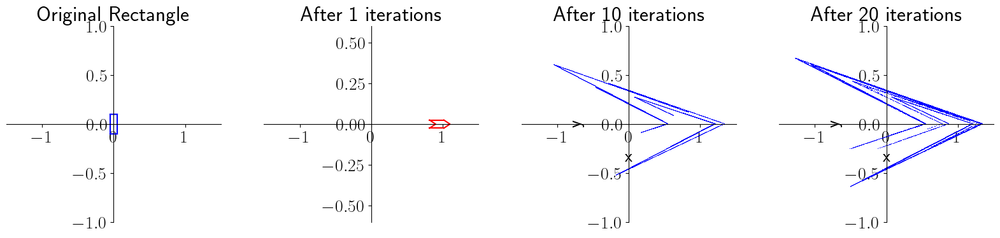

In [56]:
a   = 1.7
b   = 0.5
x   = np.linspace(-0.05, 0.05, 10000)
y_b = -0.1 * np.ones_like(x)
y_t =  0.1 * np.ones_like(x)

x_T_b, y_T_b = Tinv(T,x, y_b, a, b)
x_T_t, y_T_t = Tinv(T,x, y_t, a, b)

N = [10, 20]

# Plot the results
fig, ax = plt.subplots(1, len(N)+2, figsize=(20,4))
ax[0].plot(x, y_b, 'b-', x, y_t, 'b-')
ax[0].plot([x[ 0], x[ 0]], [y_b[ 0], y_t[ 0]], 'b-')
ax[0].plot([x[-1], x[-1]], [y_b[-1], y_t[-1]], 'b-')
ax[0].set_title('Original Rectangle')
ax[0].set_xlim(-1.5,1.5)
ax[0].set_ylim(-1.0,1.0)
customize_axes(ax[0])

ax[1].plot(x_T_b, y_T_b, 'r-', x_T_t, y_T_t, 'r-')
ax[1].plot([x_T_b[ 0], x_T_t[ 0]], [y_T_b[ 0], y_T_t[ 0]], 'r-')
ax[1].plot([x_T_b[-1], x_T_t[-1]], [y_T_b[-1], y_T_t[-1]], 'r-')
ax[1].set_title(f'After 1 iterations')
ax[1].set_xlim(-1.5,1.5)
ax[1].set_ylim(-0.6,0.6)
customize_axes(ax[1])

#x_T_b, y_T_b = Tinv(x_T_b, y_T_b , a, b)
#x_T_t, y_T_t = Tinv(x_T_t, y_T_t , a, b)

for i,n in enumerate(N):
    for _ in range(n+1):
        x_T_b, y_T_b = Tinv(T,x_T_b, y_T_b, a, b)
        x_T_t, y_T_t = Tinv(T,x_T_b, y_T_b, a, b)
      
    ax[i+2].plot(x_T_b, y_T_b, 'b,',x_T_t, y_T_t, 'b,')
    ax[i+2].set_title(f'After {n} iterations')
    ax[i+2].set_xlabel('x')
    ax[i+2].set_ylabel('y')
    ax[i+2].set_xlim(-1.5,1.5)
    ax[i+2].set_ylim(-1.0,1.0)
    customize_axes(ax[i+2])
    
plt.show()

## Redraw Figure , using an ellipse instead of a rectangle as the test shape.                                                          
a) Sketch the successive images of the ellipse under the maps $T′, T′′, T′′′$                                                             
b) Represent the ellipse parametrically and draw accurate plots on a computer.

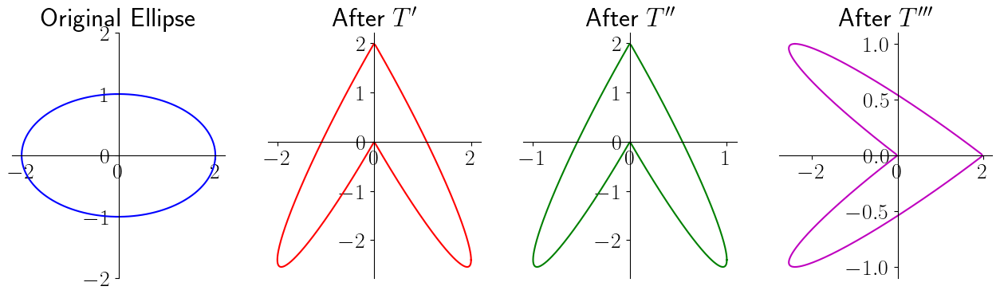

In [57]:
# Parameters
a = 1.7
b = 0.5

# Generate points on an ellipse
theta = np.linspace(0, 2*np.pi, 400)
x = 2 * np.cos(theta)  # x-coordinates of the ellipse
y = np.sin(theta)      # y-coordinates of the ellipse

# Apply T'
dx, dy = dT(x, y, a)

# Apply T''
ddx, ddy = ddT(dx, dy, b)

# Apply T'''
dddx, dddy = dddT(ddx, ddy)

# Plot the results
# Plot the results
fig = plt.figure(figsize=(20, 4))
gs=fig.add_gridspec(1,5)
ax1=fig.add_subplot(gs[0,0])
ax2=fig.add_subplot(gs[0,1])
ax3=fig.add_subplot(gs[0,2])
ax4=fig.add_subplot(gs[0,3])

# Plot original ellipse
ax1.plot(x, y, 'b-', label='Original Ellipse')
ax1.set_title('Original Ellipse')
ax1.set_ylim(-2,2)
customize_axes(ax1)

# Plot transformed ellipses
ax2.plot(dx, dy, 'r-', label="After T'")
ax2.set_title("After $T'$")
customize_axes(ax2)

ax3.plot(ddx, ddy, 'g-', label="After T''")
ax3.set_title("After $T''$")
customize_axes(ax3)

ax4.plot(dddx, dddy, 'm-', label="After T'''")
ax4.set_title("After $T'''$")
customize_axes(ax4)
plt.show()

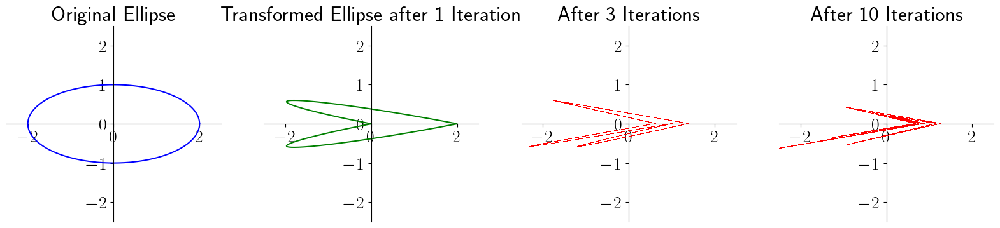

In [58]:
a = 1.4
b = 0.3

theta = np.linspace(0, 2*np.pi, 40000)
x = 2 * np.cos(theta)
y = np.sin(theta)

x_T, y_T = Tinv(T,x, y, a, b)
N = [3, 10]

# Plotting setup
fig, ax = plt.subplots(1, len(N)+2, figsize=(20,4))

# Plot original ellipse
ax[0].plot(x, y, 'b-')
ax[0].set_title('Original Ellipse')
ax[0].set_xlim(-2.5,2.5)
ax[0].set_ylim(-2.5,2.5)
customize_axes(ax[0])

# Plot transformed ellipse after 1 iteration
ax[1].plot(x_T, y_T, 'g-')
ax[1].set_title('Transformed Ellipse after 1 Iteration')
ax[1].set_xlim(-2.5, 2.5)
ax[1].set_ylim(-2.5, 2.5)
customize_axes(ax[1])

# Perform iterations and plot results
for i, n in enumerate(N):
    x_T, y_T = Tinv(T, x_T, y_T, a, b)
    ax[i+2].plot(x_T, y_T, 'r,')
    ax[i+2].set_title(f'After {n} Iterations')
    ax[i+2].set_xlim(-2.5,2.5)
    ax[i+2].set_ylim(-2.5,2.5)
    customize_axes(ax[i+2])
plt.show()

#### <span style="color:red">Show that the Lozi map contracts areas if $-1<b<1$.</span>                                                                                                
We start with the system ,                                                                                                      
$ \qquad\begin{equation*} L(x,y): \left\{\begin{array}{rl}x_{n+1} &= 1+y_n-a|x_n|,\\ \ y_{n+1} &= bx_n \end{array} \right.\end{equation*} \qquad\qquad\qquad\qquad\qquad\qquad \ (1)$                                                                              
We can re-write (1) as                                                                                                            
$\qquad L=\begin{pmatrix} 1+y_n-a|x_n| \\ bx_n \end{pmatrix} \qquad\qquad\qquad\qquad\qquad\qquad\qquad\qquad\quad(2)$                                                                         
Jacobian of the matrix $L$ can be written as                                                                                            
$\qquad\qquad J = \begin{pmatrix} \frac{\partial x_{n+1}}{\partial x_n} & \frac{\partial x_{n+1}}{\partial y_n} \\ \frac{\partial y_{n+1}}{\partial x_n} & \frac{\partial y_{n+1}}{\partial y_n} \end{pmatrix}=\begin{pmatrix} -a\cdot\mathrm{sgn}(x) & 1 \\ b & 0 \end{pmatrix} \qquad\qquad\qquad\qquad (3)$                                                                                      

$\qquad\qquad\det(J) = \begin{vmatrix} -a\cdot\mathrm{sgn}(x) & 1 \\ b & 0 \end{vmatrix} = (-a\cdot\mathrm{sgn}(x))(0)-(1)(b)=-b \qquad \ (4)$                                                                                                                                        
For the Lozi map to contract areas, the absolute value of the determinant of the Jacobian matrix must be less than $1 :$                         
$\qquad\qquad\mod\det(J) = |-b|=|b|<1 \qquad\qquad\qquad\qquad\qquad\qquad (5)$                                                                          
This condition holds if and only if:                                                                                            
$\qquad\qquad −1<b<1$                                                                                                                                       
Therefore, when $−1<b<1,$ the Lozi map contracts areas.                                                                          
This means that the map, on average, reduces the area of any region in the phase space,                                                                          
leading to the possibility of the formation of attractors and chaotic behavior.

#### <span style="color:red">Find and classify the fixed points of the Lozi map.</span>                                                                               
To determine the stability of the fixed points of the Lozi map,                                                          
We start with the system ,                                                                                                      
$ \qquad\begin{equation*} L(x,y): \left\{\begin{array}{rl}x_{n+1} &= 1+y_n-a|x_n|,\\ \ y_{n+1} &= bx_n \end{array} \right.\end{equation*} \qquad\qquad\qquad\qquad(1)$                     
#### Fixed Points
Let set $ x_{n+1}=x_n , \ y_{n+1}=y_n $                                                                                             
We then re-write the eqn. as                                                                                                       
$ \qquad L\begin{pmatrix} x \\ y \end{pmatrix}=\begin{pmatrix} x \\ y \end{pmatrix}$                                           

or, $ \quad \begin{pmatrix} 1+y-a|x| \\ bx \end{pmatrix}=\begin{pmatrix} x \\ y \end{pmatrix}$                                        
From here we get,                                                                                                                
$ \qquad\begin{aligned} y &= bx  \qquad \qquad \qquad\qquad\quad\qquad \qquad\qquad\qquad\quad (2) \\ x &= 1+y-a|x|=1+bx-a|x|\qquad\qquad\qquad\quad\quad \ (3) \end{aligned}$                                                                              

$ \qquad\begin{aligned} x + a|x| - bx -1 &= 0 \\ x + a(\pm x)- bx -1 &= 0 \end{aligned}$                                              

Here arises 2 scenarios :                                                                                                                       
###### Case 1 :  $(x\ge0)$                                                                                                                                                                                                                                       
$ \qquad\begin{aligned} x + ax - bx -1 &= 0  \\ x(1+a-b)-1 &= 0 \\ x(1+a-b) &= 1 \\ x &= \frac{1}{1+a-b} \\ x &= \frac{1}{1-(b-a)}, \quad y=bx= \frac{b}{1-(b-a)}\end{aligned}$                                              
###### Case  2 : $(x<0)$                                                                                                                                                                                                                                          
$ \qquad\begin{aligned} x - ax - bx -1 &= 0  \\ x(1-a-b)-1 &= 0 \\ x(1-a-b) &= 1 \\ x &= \frac{1}{1-(a+b)}, \quad y=bx= \frac{b}{1-(a+b)}\end{aligned}$                                                                                                                    
Jacobian of the matrix $L$ can be written as                                                                                            
$\qquad\qquad J = \begin{pmatrix} \frac{\partial x_{n+1}}{\partial x_n} & \frac{\partial x_{n+1}}{\partial y_n} \\ \frac{\partial y_{n+1}}{\partial x_n} & \frac{\partial y_{n+1}}{\partial y_n} \end{pmatrix}=\begin{pmatrix} -a\cdot\mathrm{sgn}(x) & 1 \\ b & 0 \end{pmatrix}$                                                                                                   
Eigenvalue of the Lozi System                                                                                                        
$ \qquad\begin{aligned} \det(J-\lambda I) &= 0 \\ |J-\lambda I| &= 0 \end{aligned}$                                                                 
$ \qquad\begin{vmatrix}{\begin{pmatrix} -a\cdot\mathrm{sgn}(x) & 1 \\ b & 0 \end{pmatrix} - \lambda \begin{pmatrix} 1 & 0 \\ 0 & 1 \end{pmatrix}}\end{vmatrix}=0$                                                                                                                  
$ \qquad\begin{vmatrix} -a-\lambda & 1 \\ b & -\lambda \end{vmatrix}=0$                                                                     
$ \qquad\begin{aligned}  (-a-\lambda)(-\lambda)- (1)(b) &=0 \\ \lambda^2 + a\lambda - b &= 0 \\ \lambda &= \frac{-a\pm\sqrt{a^2+4b}}{2} \end{aligned}$   

#### <span style="color:red">Show numerically that the Lozi map has a strange attractor when $a=1.7,b=0.5.$</span>

In [59]:
def Lozi_map(X0, const):
    a, b = const 
    x, y = X0
    x_n = 1 + y - a * (x * x)**0.5
    y_n = b * x
    return np.array([x_n, y_n])

def jacobian_Lozi(X0, const):
    a, b = const
    x, y = X0
    return np.array([[-a*np.sign(x), 1],
                     [            b, 0]])

def fixed_points_Lozi(a, b):
    
    # Case 1: x >= 0
    if 1 - (b - a) != 0:
        x1 = 1 / (1 - b + a)
        y1 = b * x1
    else:
        x1, y1 = None, None
    
    # Case 2: x < 0
    if 1 - (b + a) != 0:
        x2 = 1 / (1 - a - b)
        y2 = b * x2
    else:
        x2, y2 = None, None
        
    return np.array([[x1, y1], [x2, y2]])

In [60]:
def stability_Lozi(a, b):
    fps = fixed_points_Lozi(a, b)
    results = []
    for fp in fps:
        x, y = fp
        if x is not None and y is not None:
            J = jacobian_Lozi((x, y), (a, b))
            eigs = np.linalg.eigvals(J)
            if np.abs(eigs[0]) < 1 and np.abs(eigs[1]) < 1:
                results.append("Stable")
            else:
                results.append("Unstable")
        else:
            results.append("No fixed point")
    return fps, results

In [61]:
fps=fixed_points_Lozi(a=1, b=1)
for fp in fps:
    x,y = fp
    print(f'x={x},y={y}')

x=1.0,y=1.0
x=-1.0,y=-1.0


In [62]:
b=0.5
a=1.7
fps=fixed_points_Lozi(a, b)
for fp in fps:
    x,y = fp
    print(f'x={x}, y={y}')

x=0.45454545454545453, y=0.22727272727272727
x=-0.8333333333333334, y=-0.4166666666666667


In [63]:
x, y = fps[0]
print(f'x={x},y={y}')

J = jacobian_Lozi(fps[0], (a, b))
print('Jacobian of Henon :')
print(J)

eig = np.linalg.eig(J)
lambda1 = eig[0][0]
lambda2 = eig[0][1]
v1 = eig[1][:, 0]
v2 = eig[1][:, 1]

print('\u03BB_1 =',lambda1,'x_1 =', v1)
print('\u03BB_2 =',lambda2,'x_2 =', v2)

x=0.45454545454545453,y=0.22727272727272727
Jacobian of Henon :
[[-1.7  1. ]
 [ 0.5  0. ]]
λ_1 = -1.9556672193747988 x_1 = [-0.96883683  0.24769982]
λ_2 = 0.2556672193747991 x_2 = [-0.45526871 -0.89035409]


In [64]:
b=0.5
a=1.7
num_steps = 80000000
fps=fixed_points_Lozi(a, b)
x_p, y_p = fps[0]

x0, y0 = 0.45, 0.22  # Initial conditions
x, y = iterate_f(Lozi_map, (x0, y0),( a, b), num_steps)


#### <span style="color:red"> For certain parameter values, the Lozi map has a trapping region. </span>                                              
                                                                                                                                       
 We start with the system ,                                                                                                      
$ \qquad\begin{equation*} L(x,y): \left\{\begin{array}{rl}x_{n+1} &= 1+y_n-a|x_n|,\\ \ y_{n+1} &= bx_n \end{array} \right.\end{equation*} \qquad\qquad\qquad\qquad(1)$                                                                               
Let set $x_{n+1}=x_n , \ y_{n+1}=y_n $                                                                                                    
putting this value $y=bx$ into the above eqn.                                                                                             
$\qquad\begin{aligned} x=1+bx-ax \end{aligned}$                                                                               
There are two fixed points : $X = \bigg( \frac{1}{1-(b-a)} ; \frac{b}{1-(b-a)}\bigg)$ in the first quadrant                     
and $\qquad\qquad\qquad \quad \ \ \ Y = \bigg(\frac{1}{1-(b+a)}; \frac{b}{1-(b+a)}\bigg)$ in the third quadrant. They are hyperbolic.                                                                                                                           
Recall, the stable, respectively unstable, manifold of a fixed point P (or a periodic point in general), $W^s_P$ ,                                   
 respectively $W^u_P$ , is an invariant curve which emanates from $P$,                                                                
$ W^s_P = \{ T : L^n(T) \rightarrow P \text{ as } n \rightarrow\infty\} ; \\ W^u_P = \{ T : L^{-n}(T)\rightarrow P \text{ as } n \rightarrow\infty\} $                                                                                                                 
For the Lozi map L the stable and unstable manifolds are broken lines, and therefore not the differentiable manifolds.            
The half of the unstable manifold $W^u_X$ of the fixed point $X$ that starts to the right intersects the horizontal
axis for the first time at the point
$\qquad\begin{aligned} Z &= \bigg( \frac{2+a+\sqrt{a^2+4b}}{2(1+a-b)}, 0 \bigg) \\ f(Z) &= Lozi(Z) \\ f^2(Z) &= Lozi(Lozi(Z)) \end{aligned}$   

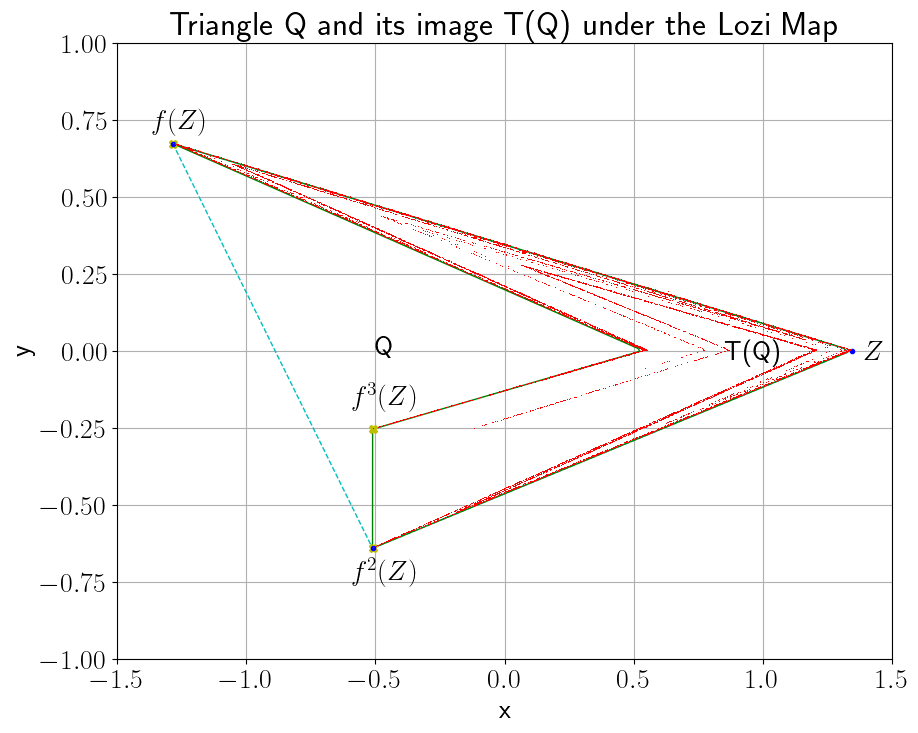

In [65]:
a  = 1.7
b  = 0.5
x0 = (2 + a + (a*a + 4*b)**0.5) / (2 * (1 + a - b))
y0 = 0

x1, y1 = Lozi_map((x0, y0), (a, b))
x2, y2 = Lozi_map((x1, y1), (a, b))
x3, y3 = Lozi_map((x2, y2), (a, b))

Q = np.array([[x0,y0], [x1,y1], [x2,y2]])
t = np.linspace(0, 1, 100).reshape(-1, 1)
L = L_function(t,Q)
H = HL(Lozi_map,L)

num_steps = int(10000)

# Initial conditions
x, y = 0.63135448, 0.18940634

# Iterate the Lozi map
x_v, y_v = iterate_f(Lozi_map, (x, y), (a, b), num_steps)

plt.figure(figsize=(10, 8))

for edge_points in L:
    plt.plot(edge_points[:, 0], edge_points[:, 1], 'c--', lw=1)

for edge_points in H:
    plt.plot(edge_points[:, 0], edge_points[:, 1], 'g', lw=1, alpha=1)

for edge_points in Q:
    plt.plot(edge_points[ 0], edge_points[ 1], 'b.')
    s, t = Lozi_map(edge_points, (a, b))
    plt.plot(s, t, 'yX')

plt.plot(x_v, y_v, 'r,')
plt.text(x0+0.05, y0-0.03, '$Z$')
plt.text(x1-0.08, y1+0.05, '$f(Z)$')
plt.text(x2-0.08,y2-0.1, '$f^2(Z)$')
plt.text(x3-0.08,y3+0.08, '$f^3(Z)$')
plt.text(-0.5,-0.01,'Q')
plt.text(0.85,-0.03,'T(Q)')
plt.title('Triangle Q and its image T(Q) under the Lozi Map')
plt.xlabel('x')
plt.ylabel('y')
plt.grid(True)
plt.ylim([-1. , 1. ])
plt.xlim([-1.5, 1.5])
plt.show()

### Basin of attraction for Lozi Map

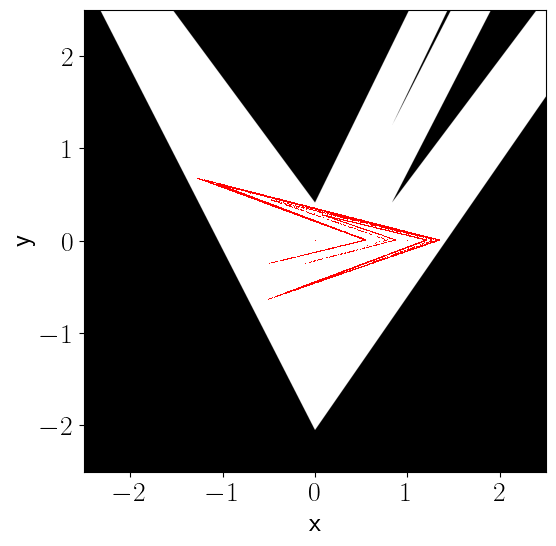

In [66]:
a          = 1.7
b          = 0.5
grid_size  = 5000          # Number of points in each dimension
iterations = 100
threshold  = 10            # Threshold for escape
x_vals = np.linspace(-2.5, 2.5, grid_size)
y_vals = np.linspace(-2.5, 2.5, grid_size)
X, Y   = np.meshgrid(x_vals, y_vals)
basin  = np.zeros_like(X, dtype=int)

for i in range(grid_size):
    for j in range(grid_size):
        x, y = X[i, j], Y[i, j]
        for _ in range(iterations):
            x, y = Lozi_map((x, y), (a, b))
            if abs(x) > threshold or abs(y) > threshold:
                basin[i, j] = 1  # Mark as escaped
                break

                
                
                
x, y = iterate_f(Lozi_map, (0,0),( a, b), num_steps=10000)

plt.figure(figsize=(6, 6))
plt.imshow(basin, extent=(-2.5, 2.5, -2.5, 2.5), origin='lower', cmap='binary')
plt.plot(x,y,'r,')
plt.xlabel("x")
plt.ylabel("y")
plt.show()

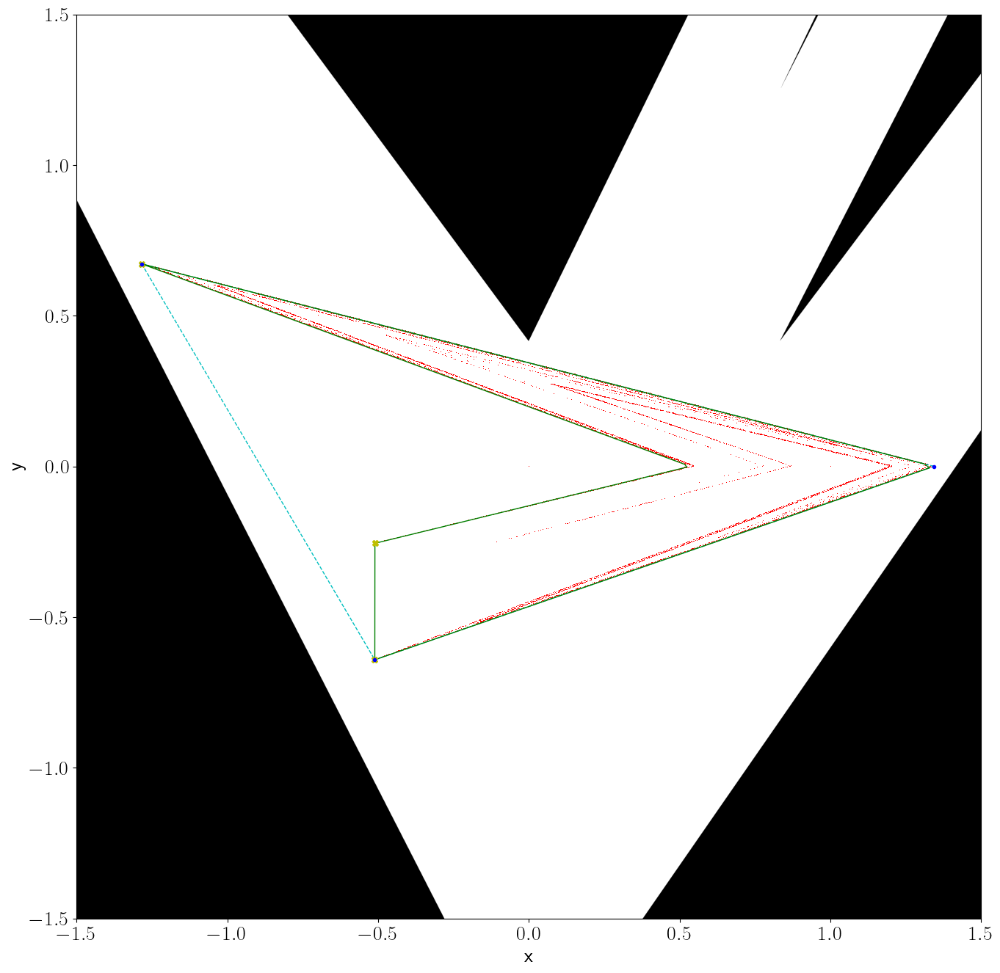

In [67]:
a          = 1.7
b          = 0.5
grid_size  = 5000          # Number of points in each dimension
iterations = 100
threshold  = 10            # Threshold for escape
x_vals = np.linspace(-1.5, 1.5, grid_size)
y_vals = np.linspace(-1.5, 1.5, grid_size)
X, Y   = np.meshgrid(x_vals, y_vals)
basin  = np.zeros_like(X, dtype=int)

for i in range(grid_size):
    for j in range(grid_size):
        x, y = X[i, j], Y[i, j]
        for _ in range(iterations):
            x, y = Lozi_map((x, y), (a, b))
            if abs(x) > threshold or abs(y) > threshold:
                basin[i, j] = 1  # Mark as escaped
                break

                     
x, y = iterate_f(Lozi_map, (0,0),( a, b), num_steps=10000)

plt.figure(figsize=(16, 16))
plt.imshow(basin, extent=(-1.5, 1.5, -1.5, 1.5), origin='lower', cmap='binary')
plt.plot(x,y,'r,')

for edge_points in L:
    plt.plot(edge_points[:, 0], edge_points[:, 1], 'c--', lw=1)

for edge_points in H:
    plt.plot(edge_points[:, 0], edge_points[:, 1], 'g', lw=1, alpha=1)

for edge_points in Q:
    plt.plot(edge_points[ 0], edge_points[ 1], 'b.')
    s, t = Lozi_map(edge_points, (a, b))
    plt.plot(s, t, 'yX')
    
plt.xlabel("x")
plt.ylabel("y")
plt.show()

### Bifurcatio & Lyapunov exponent for Lozi Map

In [68]:
transient_steps = 100
iterations = 1000
num_steps = 100
a_values = np.linspace(-0.3, 1.8, 4600)
b_values = np.linspace(-1.0, 1.0, 4600)
A ,B = 1.7, 0.5
xa_vals, xb_vals = [], []
ya_vals, yb_vals = [], []
Lxa_vals, Lxb_vals = [], []
Lya_vals, Lyb_vals = [], []

for a in a_values:
    x, y = 0, 0
    x_stable, y_stable = bifurcation(Lozi_map, (x, y), (a, B), transient_steps, num_steps)
    xa_vals.append(x_stable)
    ya_vals.append(y_stable)
    lxa, lya = lyapunov_f(Lozi_map,jacobian_Lozi,(x,y), (a, B), iterations, transient_steps)
    Lxa_vals.append(lxa)
    Lya_vals.append(lya)
    
for b in b_values:
    x, y = 0, 0
    x_stable, y_stable = bifurcation(Lozi_map, (x, y), (A, b), transient_steps, num_steps)
    xb_vals.append(x_stable)
    yb_vals.append(y_stable)
    lxb, lyb = lyapunov_f(Lozi_map,jacobian_Lozi, (x, y), (A, b), iterations, transient_steps)
    Lxb_vals.append(lxb)
    Lyb_vals.append(lyb)
    
xa_vals = np.array(xa_vals)
xb_vals = np.array(xb_vals)
ya_vals = np.array(ya_vals)
yb_vals = np.array(yb_vals)
Lxa_vals = np.array(Lxa_vals)
Lxb_vals = np.array(Lxb_vals)
Lya_vals = np.array(Lya_vals)
Lyb_vals = np.array(Lyb_vals)

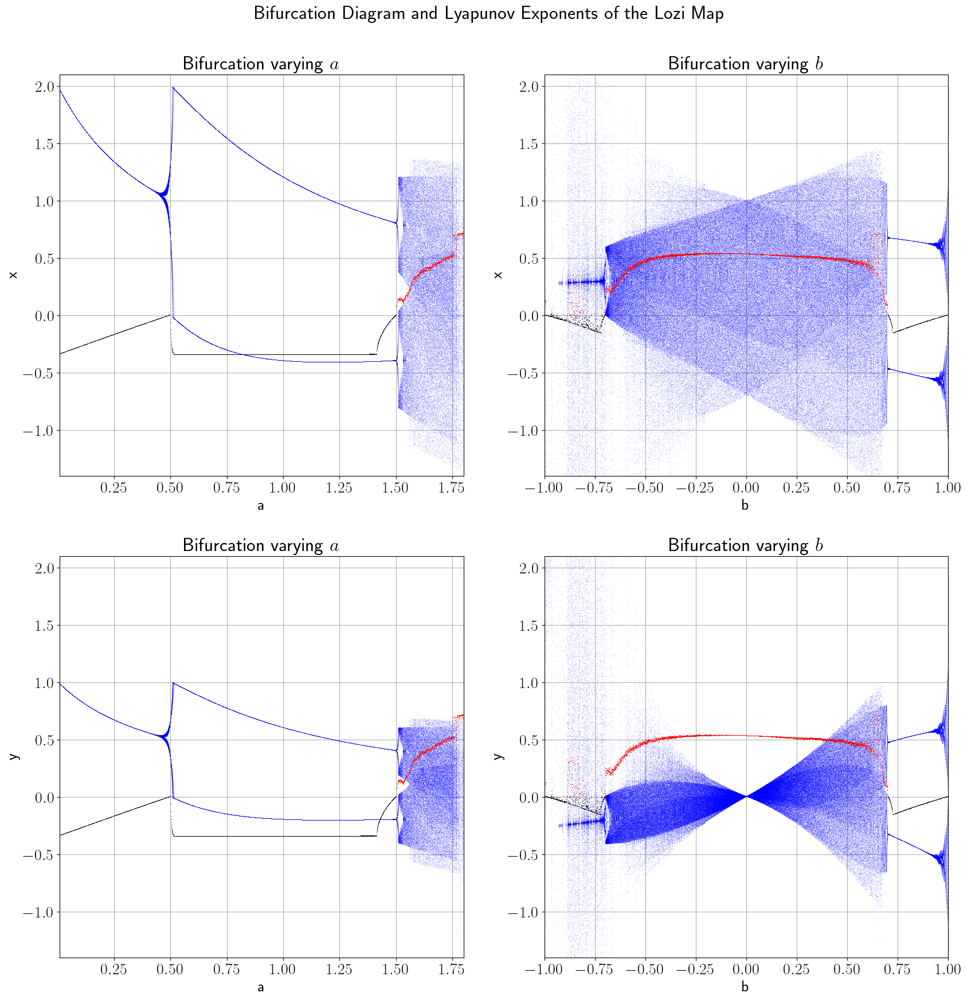

In [69]:
fig = plt.figure(figsize=(20, 20))
gs  = fig.add_gridspec(2, 2)
ax1 = fig.add_subplot(gs[0, 0])
ax2 = fig.add_subplot(gs[0, 1])
ax3 = fig.add_subplot(gs[1, 0])
ax4 = fig.add_subplot(gs[1, 1])

fig.suptitle('Bifurcation Diagram and Lyapunov Exponents of the Lozi Map', y=0.94)

ax1.plot(a_values, xa_vals, 'b,', alpha=0.2)
ax1.plot(a_values[Lxa_vals<0], Lxa_vals[Lxa_vals<0], 'k,')
ax1.plot(a_values[Lxa_vals>=0], Lxa_vals[Lxa_vals>=0], 'r,')
ax1.set_title(r'Bifurcation varying $a$')
ax1.set_ylim(-1.4, 2.1)
ax1.set_xlim(0.01, 1.8)
ax1.set_xlabel('a')
ax1.set_ylabel('x')
ax1.grid(True)

ax2.plot(b_values, xb_vals, 'b,', alpha=0.2)
ax2.plot(b_values[Lxb_vals<0], Lxb_vals[Lxb_vals<0], 'k,')
ax2.plot(b_values[Lxb_vals>=0], Lxb_vals[Lxb_vals>=0], 'r,')
ax2.set_title(r'Bifurcation varying $b$')
ax2.set_ylim(-1.4, 2.1)
ax2.set_xlim(-1.0, 1.0)
ax2.set_xlabel('b')
ax2.set_ylabel('x')
ax2.grid(True)

ax3.plot(a_values, ya_vals, 'b,', alpha=0.2)
ax3.plot(a_values[Lya_vals<0], Lya_vals[Lya_vals<0], 'k,')
ax3.plot(a_values[Lya_vals>=0], Lya_vals[Lya_vals>=0], 'r,')
ax3.set_title(r'Bifurcation varying $a$')
ax3.set_ylim(-1.4, 2.1)
ax3.set_xlim(0.01, 1.8)
ax3.set_xlabel('a')
ax3.set_ylabel('y')
ax3.grid(True)

ax4.plot(b_values, yb_vals, 'b,', alpha=0.2)
ax4.plot(b_values[Lyb_vals<0], Lyb_vals[Lyb_vals<0], 'k,')
ax4.plot(b_values[Lyb_vals>=0], Lyb_vals[Lyb_vals>=0], 'r,')
ax4.set_title(r'Bifurcation varying $b$')
ax4.set_ylim(-1.4, 2.1)
ax4.set_xlim(-1.0, 1.0)
ax4.set_xlabel('b')
ax4.set_ylabel('y')
ax4.grid(True)
plt.show()

#### <span style="color:red"> Suppose we change the sign of b. Is there any difference in the dynamics? </span>

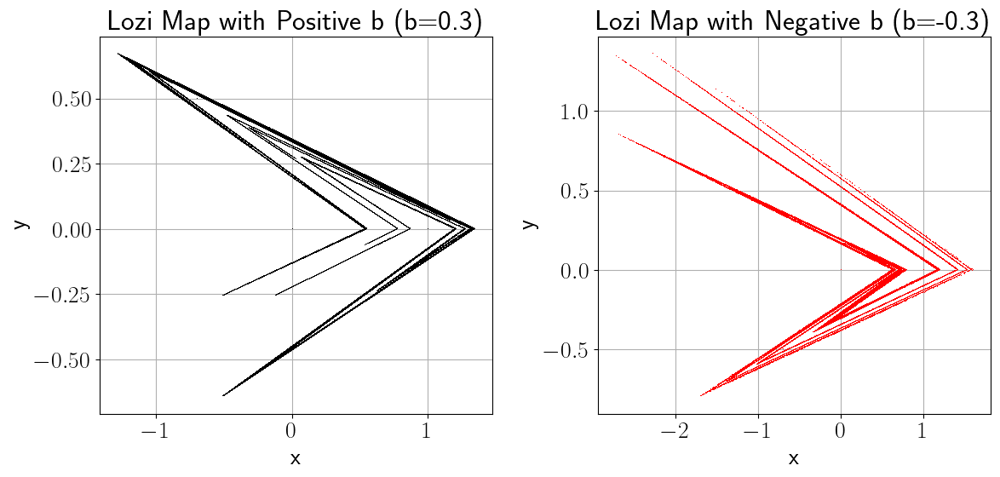

In [70]:
a = 1.7
b_positive = 0.5
b_negative = -0.5
num_iterations = 1000000
x0, y0 = 0, 0

# Iterate for positive b
x_pos, y_pos = iterate_f(Lozi_map,(x0, y0), (a, b_positive), num_iterations)

# Iterate for negative b
x_neg, y_neg = iterate_f(Lozi_map,(x0, y0), (a, b_negative), num_iterations)

# Plotting
plt.figure(figsize=(12, 6))

plt.subplot(1, 2, 1)
plt.plot(x_pos, y_pos, 'k,')
plt.title("Lozi Map with Positive b (b=0.3)")
plt.xlabel("x")
plt.ylabel("y")
plt.grid(True)

plt.subplot(1, 2, 2)
plt.plot(x_neg, y_neg, 'r,')
plt.title("Lozi Map with Negative b (b=-0.3)")
plt.xlabel("x")
plt.ylabel("y")
plt.grid(True)

plt.tight_layout()
plt.show()

#### <span style="color:red">Find and classify the 2-cycles of the Lozi map.</span>

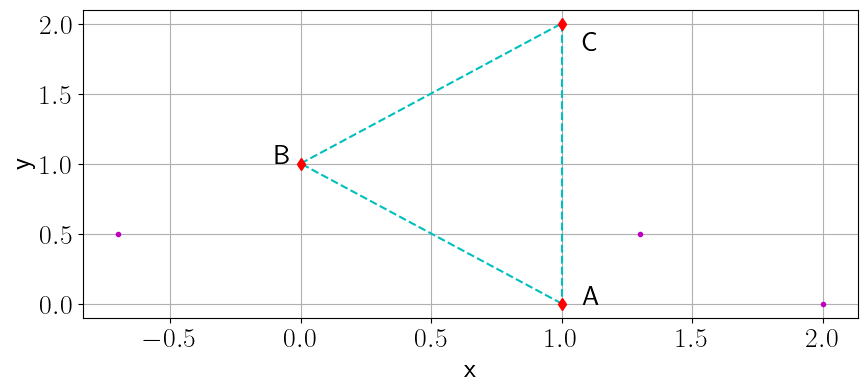

In [71]:
Q = np.array([[1,0], [0,1], [1,2]])
a = 1.7
b = 0.5
t = np.linspace(0, 1, 1000)
L = L_function(t,Q)
#H = HL(henon_map,L)

plt.figure(figsize=(10,4))
vertex_names = ['A', 'B', 'C', 'D']
for edge_points in L:
    plt.plot(edge_points[:, 0], edge_points[:, 1], 'c--')

'''for edge_points in H:
    plt.plot(edge_points[:, 0], edge_points[:, 1], 'g-.')'''

for edge_points in Q:
    plt.plot(edge_points[ 0], edge_points[ 1], 'rd')
    s, t = Lozi_map(edge_points, (a, b))
    plt.plot(s, t, 'm.')

plt.text( -0.1, 1, 'B')
plt.text(1.08, 2.0-0.2, 'C')
plt.text(1.08,-0.01, 'A')
plt.xlabel('x')
plt.ylabel('y')
#plt.legend()
plt.grid(True)
#plt.ylim([-0.6, 2.6])
#plt.xlim([-1.5, 1.5])
plt.show()

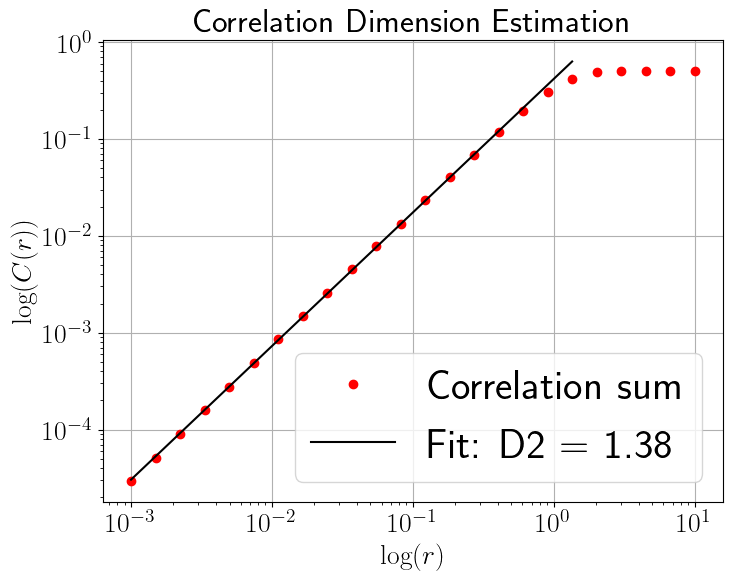

In [72]:
a, b = 1.7, 0.5
const = (a, b)
iterations = 15000
transients = 1000
X0 = np.array([0.5, 0.5])

# Generate orbit
orbit = [X0]
for _ in range(iterations):
    orbit.append(Lozi_map(orbit[-1], const))
orbit = np.array(orbit[transients:])  # Remove transients

# Compute correlation sums
r_values = np.logspace(-3, 1, 24)
C_r = [correlation_sum(orbit, r) for r in r_values] 
m,c = fit(np.log(r_values[0:17]), np.log(C_r[0:17]))
Y = np.exp(m * np.log(r_values) + c)

plt.figure(figsize=(8, 6))
plt.loglog(r_values, C_r, 'ro', label="Correlation sum")
plt.plot(r_values[:19], Y[:19], 'k-', label=f"Fit: D2 = {m:.2f}")
plt.xlabel(r"$\log(r)$")
plt.ylabel(r"$\log(C(r))$")
plt.title("Correlation Dimension Estimation")
plt.legend()
plt.grid(True)
plt.show()

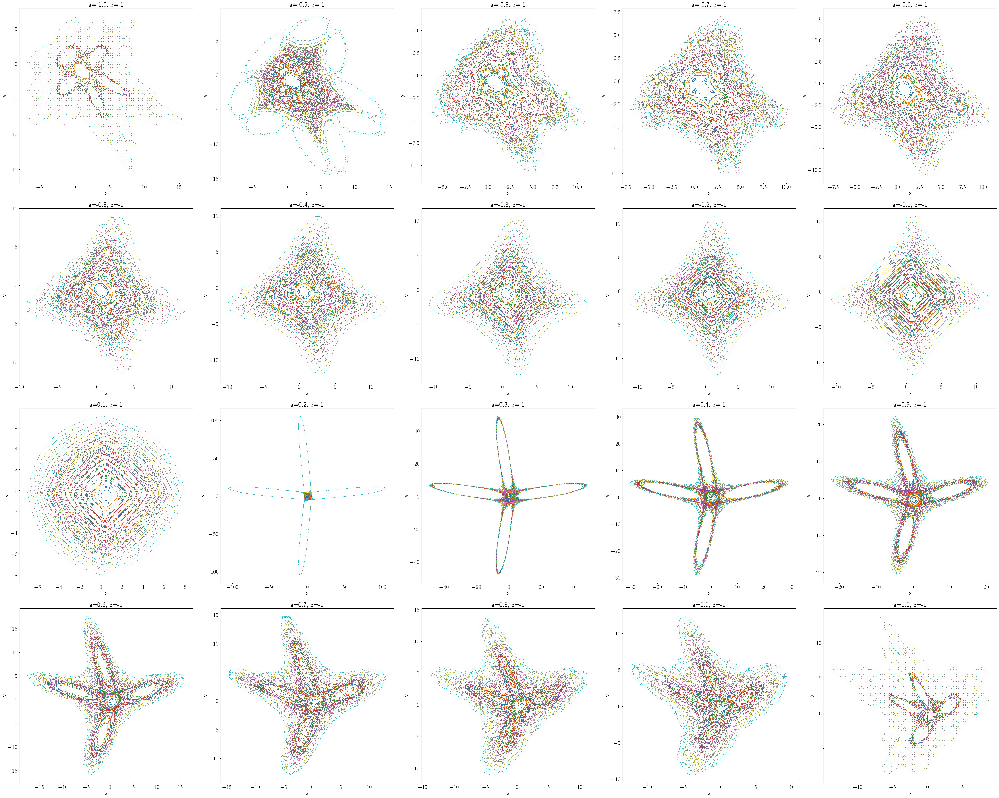

In [73]:
a = -0.9
b = -1
num_steps = int(1000)
domain = np.round(np.linspace(0,5,10),1)
AA = np.round(np.linspace(-1,1,20),1)

fig, ax = plt.subplots(4, 5, figsize=(50,40))
ax = ax.flatten()
for i, a in enumerate(AA):
    for x in domain:
        for y in domain:
            x_v, y_v = iterate_f(Lozi_map, (x, y), (a, b), num_steps)
            ax[i].plot(x_v, y_v, ',', markersize=0.1)
    ax[i].set_title(f'a={a}, b={b}')
    ax[i].set_xlabel('x')
    ax[i].set_ylabel('y')
plt.tight_layout()
plt.show()

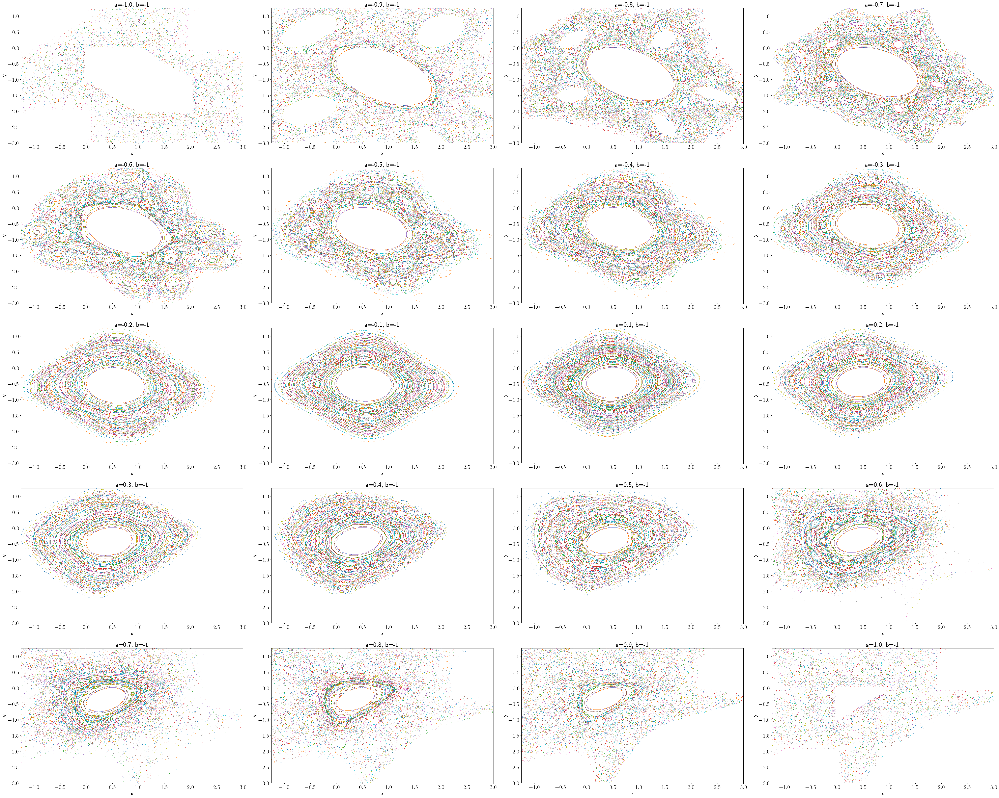

In [74]:
a = -0.9
b = -1
num_steps = int(1000)
domain = np.round(np.linspace(0,1,21),1)
AA = np.round(np.linspace(-1,1,20),1)

fig, ax = plt.subplots(5, 4, figsize=(50,40))
ax = ax.flatten()
for i, a in enumerate(AA):
    for x in domain:
        for y in domain:
            x_v, y_v = iterate_f(Lozi_map, (x, y), (a, b), num_steps)
            ax[i].plot(x_v, y_v, ',', markersize=0.1)
    ax[i].set_title(f'a={a}, b={b}')
    ax[i].set_xlabel('x')
    ax[i].set_ylabel('y')
    ax[i].set_xlim(xmin=-1.25,xmax=3)
    ax[i].set_ylim(ymin=-3,ymax=1.25)
plt.tight_layout()
plt.show()

# $$\text{The Ideka map}$$                                                   
$ z_{n+1}=A+Bz_n e^{i(|z_n|^2+c)} $                                                                                                                     
$ x_{n+1}=A+B\left[x\cos\left\{ k-\left(\frac{p}{1+x^2+y^2}\right)\right\}-y\sin\left\{k-\left(\frac{p}{1+x^2+y^2}\right)\right\}\right] $                  
$ y_{n+1}=\qquad B\left[x\sin\left\{k-\left(\frac{p}{1+x^2+y^2}\right)\right\}+y\cos\left\{k-\left(\frac{p}{1+x^2+y^2}\right)\right\}\right]$


In [75]:
def IkedaMap(X0,const):
    x,y = X0
    A,B,k,p = const
    w = 1 + x*x + y*y
    t = k - (p/w)
    xn = A + B*(x*np.cos(t) - y*np.sin(t))
    yn =     B*(x*np.sin(t) + y*np.cos(t))
    return xn, yn 

def IkedaMapJacobian(X0, const):
    x, y = X0
    A, B, k, p = const
    w = 1 + x*x + y*y
    t = k - (p / w)
    dt_dx = 2 * p * x / w**2
    dt_dy = 2 * p * y / w**2
    
    J = np.array([
        [B * (np.cos(t) - dt_dx * (x * np.sin(t) + y * np.cos(t))),
         B * (-np.sin(t) - dt_dy * (x * np.sin(t) + y * np.cos(t)))],
        [B * (np.sin(t) + dt_dx * (x * np.cos(t) - y * np.sin(t))),
         B * (np.cos(t) + dt_dy * (x * np.cos(t) - y * np.sin(t)))]])
    
    return J

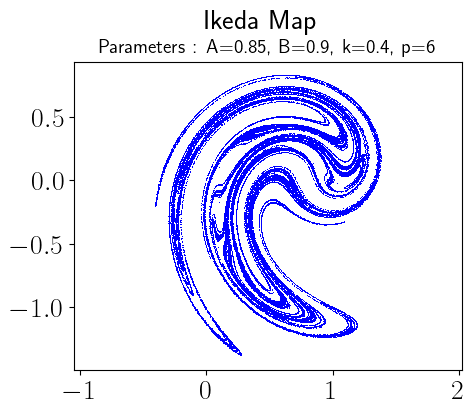

In [76]:
A = 0.85
B = 0.9
k = 0.4
p = 6
const = A,B,k,p
iterates = 80000
x,y = 0.1,0.1
X,Y = iterate_f(IkedaMap, (x, y), const, iterates)

fig, ax = plt.subplots(figsize=(5,4))
ax.axis('equal')
#ax.set_facecolor('k')
fig.suptitle('Ikeda Map',fontsize=20, y = 1.01)
ax.plot(X,Y,'b,')
ax.set_title(f'Parameters : A={A}, B={B}, k={k}, p={p}',fontsize=14)
plt.show()

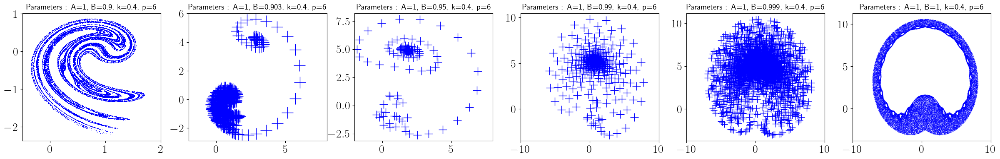

In [77]:
A=1
k=0.4
B_values=[0.9, 0.903, 0.950, 0.990, 0.999, 1]
p=6
iterates = 50000
x,y = 0.1,0.1
s0 = [[-0.5, 2], [-2, 8], [-2, 8], [-10, 10], [-10, 10], [-10, 10]]
st = [',', '+', '+', '+', '+', '+', ',']
sz = [0.1, 20, 15, 14, 11, 0.2]
fig, ax = plt.subplots(1, len(B_values),figsize=(30,4))

for i,B in enumerate(B_values):
    const = A,B,k,p
    X,Y =  iterate_f(IkedaMap, (x, y), const, iterates)
    ax[i].plot(X,Y, st[i],color='b', markersize=sz[i])
    ax[i].set_title(f'Parameters : A={A}, B={B}, k={k}, p={p}', fontsize=14)
    ax[i].set_xlim(s0[i])
plt.show()

### Basin of attraction for Ideka Map

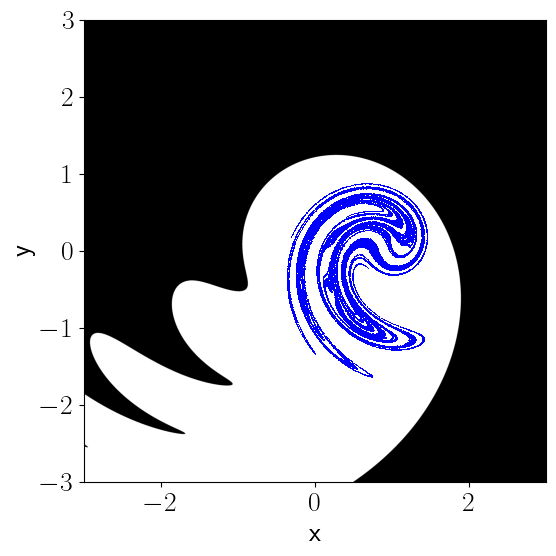

In [78]:
A = 0.9
B = 0.9
k = 0.4
p = 6
const = A,B,k,p
grid_size  = 5000  # Number of points in each dimension
iterations = 100
threshold  = 10   # Threshold for escape
x_vals = np.linspace(-3,3, grid_size)
y_vals = np.linspace(-3,3, grid_size)
X, Y   = np.meshgrid(x_vals, y_vals)
basin  = np.zeros_like(X, dtype=int)

for i in range(grid_size):
    for j in range(grid_size):
        x, y = X[i, j], Y[i, j]
        for _ in range(iterations):
            x, y = IkedaMap((x, y), const)
            if abs(x**2) > threshold or abs(y**2) > threshold:
                basin[i, j] = 1  # Mark as escaped
                break
                
x,y = iterate_f(IkedaMap, (0.1,0.1), const, 80000)

plt.figure(figsize=(6,6))
plt.imshow(basin, extent=(-3,3,-3,3), origin='lower', cmap='binary')
plt.plot(x,y,'b,')
#plt.colorbar(label='Basin (0 = Attractor, 1 = Escape)')
#plt.title("Basin of Attraction of the Hénon Map")
plt.xlabel("x")
plt.ylabel("y")
plt.show()

### Bifurcation & Lyapunov exponent for Ideka Map

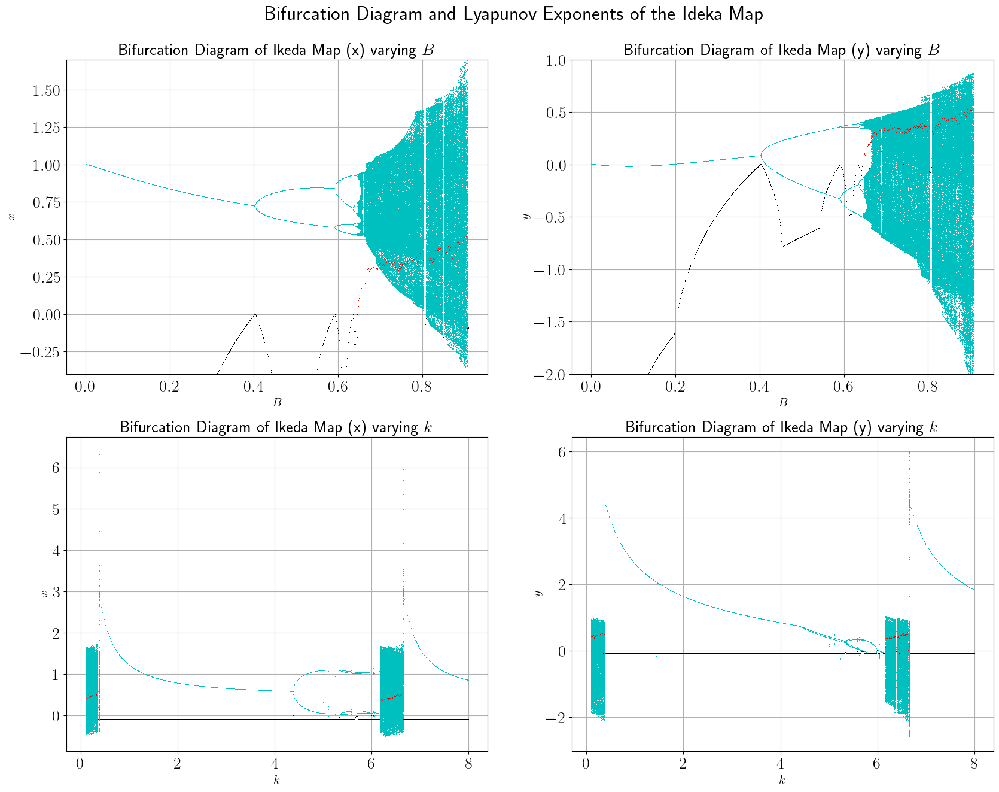

In [79]:
# Parameters
A = 1
B = 0.9
k = 0.4
p = 6
num_steps = 1000
transient_steps = 1000

B_values = np.linspace(0., 0.91, num_steps)
xB_v, yB_v = [], []
LxB_vals, LyB_vals = [], []

for B in B_values:
    x, y = 0.1, 0.1
    x_stable, y_stable = bifurcation(IkedaMap, (x, y), (A, B, k, p), transient_steps, num_steps)
    xB_v.append(x_stable)
    yB_v.append(y_stable)
    lx, ly = lyapunov_f(IkedaMap, IkedaMapJacobian, (x, y), (A, B, k, p), transient_steps, num_steps)
    LxB_vals.append(lx)
    LyB_vals.append(ly)
    
xB_v = np.array(xB_v)
yB_v = np.array(yB_v)
LxB_vals = np.array(LxB_vals)
LyB_vals = np.array(LyB_vals)

k_values = np.linspace(0.1, 8., num_steps)
xk_v, yk_v = [], []
Lxk_vals, Lyk_vals = [], []

for k in k_values:
    x, y = 0.1, 0.1
    x_stable, y_stable = bifurcation(IkedaMap, (x, y), (A, B, k, p), transient_steps, num_steps)
    xk_v.append(x_stable)
    yk_v.append(y_stable)
    lx, ly = lyapunov_f(IkedaMap, IkedaMapJacobian, (x, y), (A, B, k, p), transient_steps, num_steps)
    Lxk_vals.append(lx)
    Lyk_vals.append(ly)
    
xk_v = np.array(xk_v)
yk_v = np.array(yk_v)
Lxk_vals = np.array(Lxk_vals)
Lyk_vals = np.array(Lyk_vals)

fig, ax = plt.subplots(2,2,figsize=(20, 15))
fig.suptitle('Bifurcation Diagram and Lyapunov Exponents of the Ideka Map', y=0.94)

ax1 = ax[0,0]
ax1.plot(B_values, xB_v, 'c,', markersize=0.5)
ax1.plot(B_values[LxB_vals< 0], LxB_vals[LxB_vals< 0], 'k,', ms=15)
ax1.plot(B_values[LxB_vals>=0], LxB_vals[LxB_vals>=0], 'r,', ms=15)
ax1.set_xlabel('$B$', fontsize=15)
ax1.set_ylabel('$x$', fontsize=15)
ax1.set_ylim(-0.4, 1.7)
ax1.grid(True)
ax1.set_title('Bifurcation Diagram of Ikeda Map (x) varying $B$', fontsize=20)

ax2 = ax[0,1]
ax2.plot(B_values, yB_v, 'c,', markersize=0.5)
ax2.plot(B_values[LyB_vals< 0], LyB_vals[LyB_vals< 0], 'k,', ms=15)
ax2.plot(B_values[LyB_vals>=0], LyB_vals[LyB_vals>=0], 'r,', ms=15)
ax2.set_xlabel('$B$', fontsize=15)
ax2.set_ylabel('$y$', fontsize=15)
ax2.set_ylim(-2., 1.)
ax2.grid(True)
ax2.set_title('Bifurcation Diagram of Ikeda Map (y) varying $B$', fontsize=20)

ax3 = ax[1,0]
ax3.plot(k_values, xk_v, 'c,', markersize=0.5)
ax3.plot(k_values[Lxk_vals< 0], Lxk_vals[Lxk_vals< 0], 'k,', ms=15)
ax3.plot(k_values[Lxk_vals>=0], Lxk_vals[Lxk_vals>=0], 'r,', ms=15)
ax3.set_xlabel('$k$', fontsize=15)
ax3.set_ylabel('$x$', fontsize=15)
#ax3.set_ylim(-0.4, 1.7)
ax3.grid(True)
ax3.set_title('Bifurcation Diagram of Ikeda Map (x) varying $k$', fontsize=20)

ax4 = ax[1,1]
ax4.plot(k_values, yk_v, 'c,', markersize=0.5)
ax4.plot(k_values[Lyk_vals< 0], Lyk_vals[Lyk_vals< 0], 'k,', ms=15)
ax4.plot(k_values[Lyk_vals>=0], Lyk_vals[Lyk_vals>=0], 'r,', ms=15)
ax4.set_xlabel('$k$', fontsize=15)
ax4.set_ylabel('$y$', fontsize=15)
#ax4.set_ylim(-2., 1.)
ax4.grid(True)
ax4.set_title('Bifurcation Diagram of Ikeda Map (y) varying $k$', fontsize=20)
plt.show()

$\mathbf{Ikeda}$ map.                                                                                                                                      
$ x_{n+1} = A + B(x_n \cos |En|^2 − y_n \sin |En|^2) = A + B(x_n \cos (x^2 + y^2) − y_n \sin (x^2 + y^2)) $                                              
$ y_{n+1} = \qquad B(x_n \sin |En|^2 + y_n \cos |En|^2) = \qquad B(x_n \sin (x^2 + y^2) + y_n \cos (x^2 + y^2))$

In [80]:
def IkedaEMap(X0,const):
    x,y = X0
    A,B = const
    xn = A + B*x*np.cos(x**2 + y**2) - B*y*np.sin(x**2 + y**2)
    yn =     B*x*np.sin(x**2 + y**2) + B*y*np.cos(x**2 + y**2)
    return xn, yn

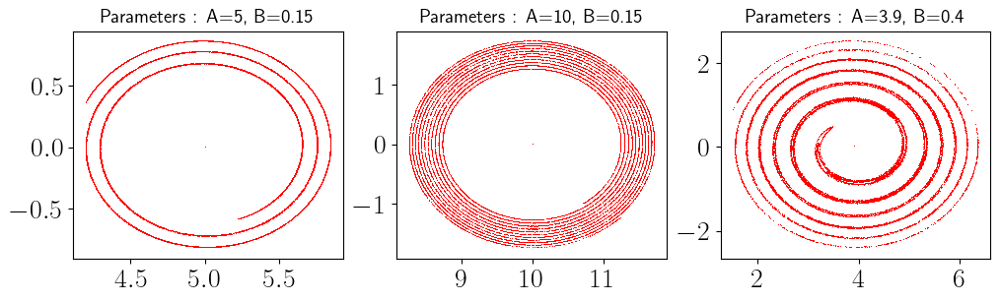

In [81]:
A_values =[5,10,3.9 ]
B_values =[0.15,0.15,0.4] 
iterates = 20000
t1 = r'$ \\ x_{n+1} = A + B(x_n \cos |E_n|^2 − y_n \sin |E_n|^2)$'
t2 = r'$ \\ y_{n+1} = \qquad B(x_n \sin |E_n|^2 + y_n \cos |E_n|^2)$'

fig, ax = plt.subplots(1, len(B_values),figsize=(12,3))

for A,B,i in zip(A_values,B_values,range(len(B_values))):
    const = A,B
    x = A
    y = 0
    X,Y =  iterate_f(IkedaEMap, (x, y), const, iterates)
    ax[i].plot(X,Y, 'r,')
    ax[i].set_title(f'Parameters : A={A}, B={B}', fontsize=14)
plt.show()

## $$\text{Modified Henon Map}$$                                                                                                                     
#### <span style="color:red">Consider the 2-dimensional discrete map defined by </span>
#### <span style="color:red">$ \qquad \begin{align} x_{n+1} &=1+ βx_n − αy^2_n ,\\ y_{n+1} &= x_n \end{align}$ </span>
#### <span style="color:red"> where $α$ and $β$ are constants. Suppose that $α = 1,$ plot iterative plots and power spectra for system when $ β = [ 0.05,0.12, 0.3 ]$   </span>                                                  
                                                                                                                                 
$\qquad\qquad\qquad J = \begin{pmatrix} \frac{\partial x_{n+1}}{\partial x_n} & \frac{\partial x_{n+1}}{\partial y_n} \\
\frac{\partial y_{n+1}}{\partial x_n} & \frac{\partial y_{n+1}}{\partial y_n} \end{pmatrix}=\begin{pmatrix} \beta & -2\alpha x \\ 1 & 0 \end{pmatrix}$                                                                                               

$\qquad\qquad \ \det(J) =\begin{vmatrix} \beta & -2\alpha x \\ 1 & 0 \end{vmatrix}=(\beta)(0)-(-2\alpha x)(1)=2\alpha x$

In [82]:
 def modified_Henon(X0, const):
    x, y = X0
    a, b = const
    xn = 1 - a*y**2 + b*x
    yn = x
    return (xn, yn)

def Jacobian_modifiedHenon(X0, const):
    a, b = const
    x, y = X0
    return np.array([[ b, -2*a*x],
                     [ 1,      0]])

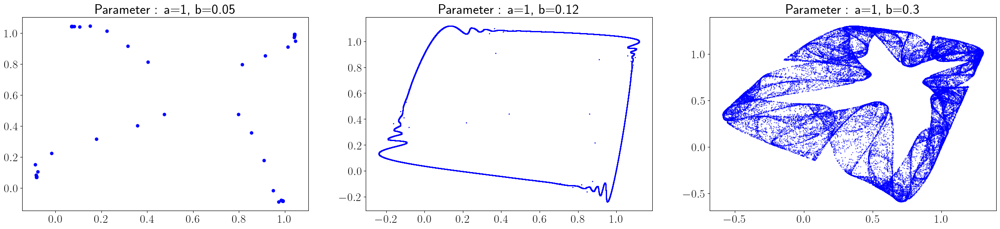

In [83]:
a=1
B_values=[0.05,0.12,0.3]
ms = [ 10, 2, 1]
iterates = 50000
fig, ax = plt.subplots(1, len(B_values),figsize=(30,6))
for i,b in enumerate(B_values):
    const = a, b
    x = (1 - b) / 2
    y = x
    X,Y =  iterate_f( modified_Henon, (x, y), const, iterates)
    ax[i].plot(X,Y, 'b.', ms=ms[i])
    ax[i].set_title(f'Parameter : a={a}, b={b}')
plt.show()

### Bifurcation & Lyapunov exponent for modified Henon Map

In [84]:
transient_steps = 100
iterations = 1000
num_steps = 100
a_values = np.linspace(-0.3, 1.2, 4600)
b_values = np.linspace(-1.5, 0.7, 4600)
A ,B = 1., 0.3
xa_vals, xb_vals = [], []
ya_vals, yb_vals = [], []
Lxa_vals, Lxb_vals = [], []
Lya_vals, Lyb_vals = [], []

for a in a_values:
    x, y = 0, 0
    x_stable, y_stable = bifurcation(modified_Henon, (x, y), (a, B), transient_steps, num_steps)
    xa_vals.append(x_stable)
    ya_vals.append(y_stable)
    lxa, lya = lyapunov_f(modified_Henon,Jacobian_modifiedHenon,(x,y), (a, B), iterations, transient_steps)
    Lxa_vals.append(lxa)
    Lya_vals.append(lya)
    
for b in b_values:
    x, y = 0, 0
    x_stable, y_stable = bifurcation(modified_Henon, (x, y), (A, b), transient_steps, num_steps)
    xb_vals.append(x_stable)
    yb_vals.append(y_stable)
    lxb, lyb = lyapunov_f(modified_Henon,Jacobian_modifiedHenon, (x, y), (A, b), iterations, transient_steps)
    Lxb_vals.append(lxb)
    Lyb_vals.append(lyb)
    
xa_vals = np.array(xa_vals)
xb_vals = np.array(xb_vals)
ya_vals = np.array(ya_vals)
yb_vals = np.array(yb_vals)
Lxa_vals = np.array(Lxa_vals)
Lxb_vals = np.array(Lxb_vals)
Lya_vals = np.array(Lya_vals)
Lyb_vals = np.array(Lyb_vals)

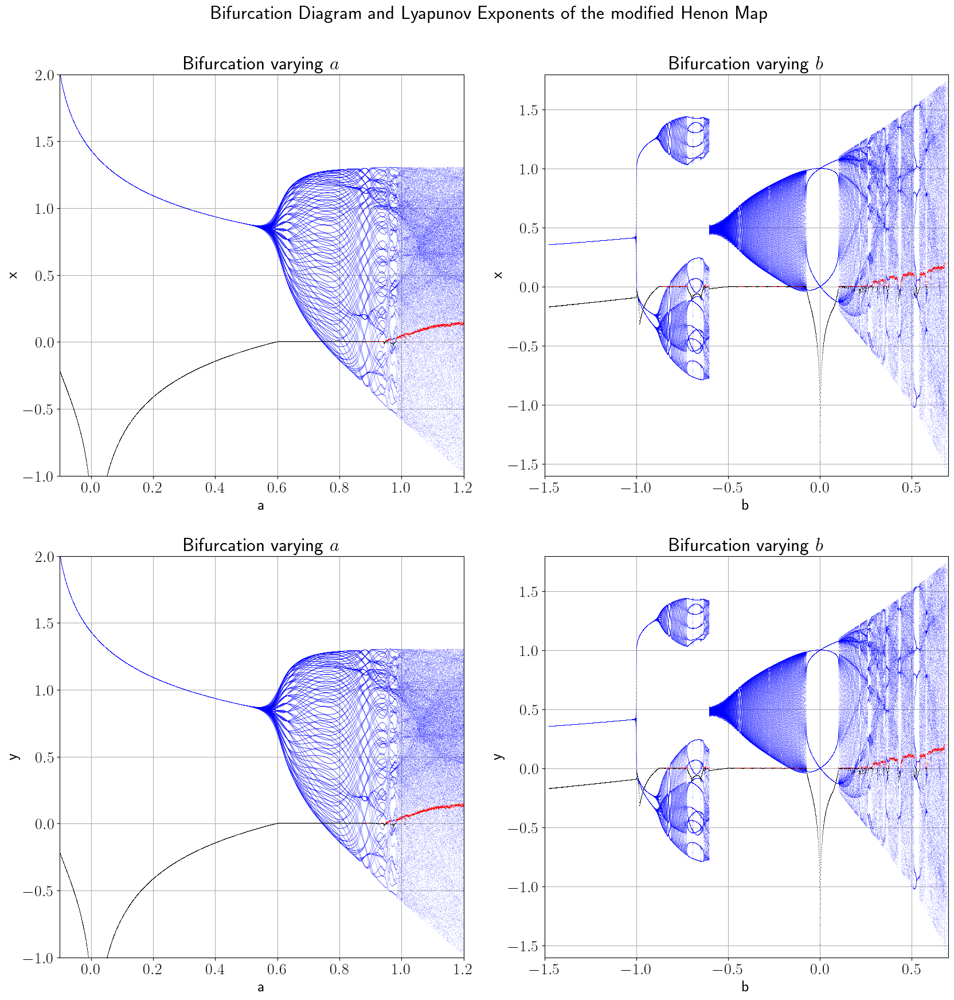

In [85]:
fig = plt.figure(figsize=(20, 20))
gs  = fig.add_gridspec(2, 2)
ax1 = fig.add_subplot(gs[0, 0])
ax2 = fig.add_subplot(gs[0, 1])
ax3 = fig.add_subplot(gs[1, 0])
ax4 = fig.add_subplot(gs[1, 1])

fig.suptitle('Bifurcation Diagram and Lyapunov Exponents of the modified Henon Map', y=0.94)

ax1.plot(a_values, xa_vals, 'b,', alpha=0.2)
ax1.plot(a_values[Lxa_vals<0], Lxa_vals[Lxa_vals<0], 'k,')
ax1.plot(a_values[Lxa_vals>=0], Lxa_vals[Lxa_vals>=0], 'r,')
ax1.set_title(r'Bifurcation varying $a$')
ax1.set_ylim(-1., 2.)
ax1.set_xlim(-0.1, 1.2)
ax1.set_xlabel('a')
ax1.set_ylabel('x')
ax1.grid(True)

ax2.plot(b_values, xb_vals, 'b,', alpha=0.2)
ax2.plot(b_values[Lxb_vals<0], Lxb_vals[Lxb_vals<0], 'k,')
ax2.plot(b_values[Lxb_vals>=0], Lxb_vals[Lxb_vals>=0], 'r,')
ax2.set_title(r'Bifurcation varying $b$')
ax2.set_ylim(-1.6, 1.8)
ax2.set_xlim(-1.5, 0.7)
ax2.set_xlabel('b')
ax2.set_ylabel('x')
ax2.grid(True)

ax3.plot(a_values, ya_vals, 'b,', alpha=0.2)
ax3.plot(a_values[Lya_vals<0], Lya_vals[Lya_vals<0], 'k,')
ax3.plot(a_values[Lya_vals>=0], Lya_vals[Lya_vals>=0], 'r,')
ax3.set_title(r'Bifurcation varying $a$')
ax3.set_ylim(-1., 2.)
ax3.set_xlim(-0.1, 1.2)
ax3.set_xlabel('a')
ax3.set_ylabel('y')
ax3.grid(True)

ax4.plot(b_values, yb_vals, 'b,', alpha=0.2)
ax4.plot(b_values[Lyb_vals<0], Lyb_vals[Lyb_vals<0], 'k,')
ax4.plot(b_values[Lyb_vals>=0], Lyb_vals[Lyb_vals>=0], 'r,')
ax4.set_title(r'Bifurcation varying $b$')
ax4.set_ylim(-1.6, 1.8)
ax4.set_xlim(-1.5, 0.7)
ax4.set_xlabel('b')
ax4.set_ylabel('y')
ax4.grid(True)
plt.show()

## $$\text{Periodically-Kicked Hamiltonian Web Map} $$
$ \qquad \begin{align} u_{n+1}&= \ \ \bigg( u_n + k\sin v_n \bigg) \cos\alpha + v_n \sin\alpha \\ v_{n+1}&=-\bigg( u_n + k\sin v_n \bigg) \sin\alpha + v_n \cos\alpha \\ \qquad\text{where }, \quad u&=\dot{x}/\omega_o \\ v&=-x \\ \alpha&=\omega_o T=2\pi/q \end{align}$

In [86]:
def web_map(X, const):
    u_n, v_n =  X
    k, alpha =  const
    u_next   =  (u_n + k * np.sin(v_n)) * np.cos(alpha) + v_n * np.sin(alpha)
    v_next   = -(u_n + k * np.sin(v_n)) * np.sin(alpha) + v_n * np.cos(alpha)
    return u_next, v_next

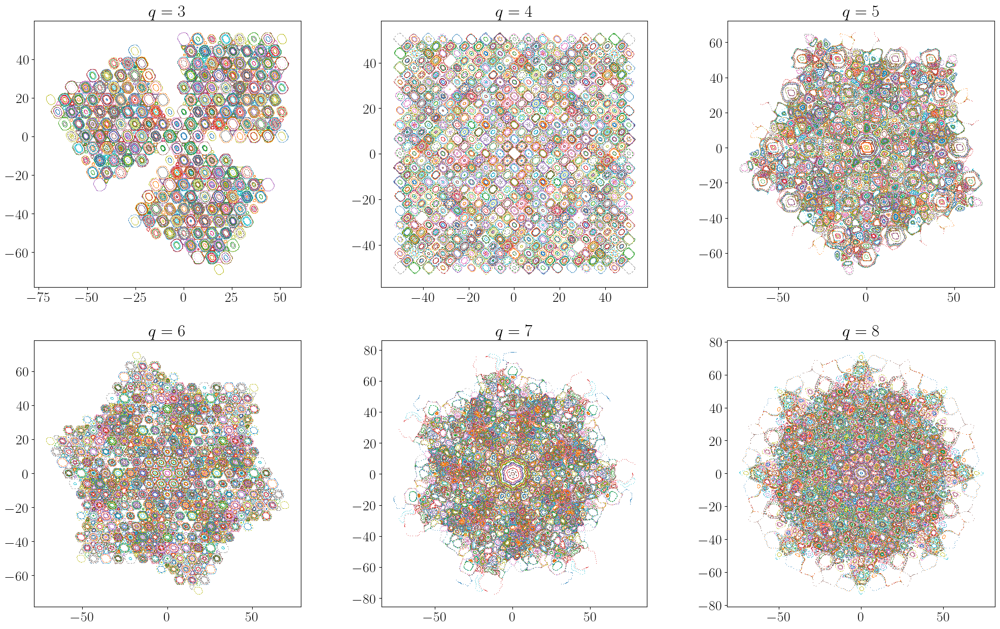

In [87]:
phi = (1 + np.sqrt(5)) / 2
K = phi - 1
q = [3,4,5,6,7,8]
num_outer_loops = 1000
num_inner_loops = 200
fig, axs = plt.subplots(2, 3, figsize=(25, 15))
axs = axs.flatten()  
for i, q in enumerate(q):
    alpha = 2 * np.pi / q
    axs[i].set_aspect('equal')
    for _ in range(num_outer_loops):
        ulast = 50 * np.random.rand()
        vlast = 50 * np.random.rand()
        x_vals, y_vals = iterate_f(web_map, (ulast, vlast), (K, alpha), num_inner_loops)
        axs[i].plot(x_vals, y_vals, ',', markersize=0.2)
    axs[i].set_title(f'$q = {q}$')
fig.patch.set_facecolor('white')
plt.show()